In [ ]:
!git clone https://github.com/ynwawithpogct/CS106.git

fatal: destination path 'CS106' already exists and is not an empty directory.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/EVRP

import os
os.system('mkdir Result')

/content/drive/MyDrive/EVRP


0

# Folder format:
- ElectricCar/
  - evrp-benchmark-set/
  - Statistic/
- The evrp-benchmark-set folder stores all the .evrp file and the Statistic folder holds all the statistic file



# All the function in EVRP

All the code in here are originated from the code in the TR-EVRP-Competition with some modification.

In [ ]:
# Import all the necessary library
import random
import math
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
# To see path
see_path = True

## For statistic

In [ ]:
# initialiazes a run for your heuristic
def start_run(r: int):
    random.seed(r)          # Random seed
    init_evals()                #  initialize the initial values for the evaluation count
    init_current_best()    #  the current best solution value
    print("Run: {} with random seed {}".format(r, r))


# gets an observation of the run for your heuristic
def end_run(r: int):
    get_mean(r - 1, get_current_best())    # calculate the mean value of previous runs and the current best solution value.
    print("End of run {} with best solution quality {} total evaluations: {}".format(r, get_current_best(), get_evals()))


# sets the termination conidition for your heuristic
def termination_condition():
    flag = False

    if get_evals() >= TERMINATION:
        flag = True
    return flag

In [ ]:
""" This function is used to initialize and open output files for storing performance statistics. """
def open_stats():
    global perf_of_trials         #  a global list used to store the performance values of each trial run.
    global perf_filename        #  a global string that represents the filename or filepath of the output file where the performance statistics will be stored.
    global log_performance   #  a global file object that is used to write the performance statistics to the output file.
    global MAX_TRIALS     #  a global integer that represents the maximum number of trial runs to be performed

    # Initialize
    perf_of_trials = [0.0] * MAX_TRIALS

    # Get problem name
    name = (problem_instance.split('/')[-1]).split('/')[-1]
    print('=========', name)

    # Initialize and open output files
    perf_filename = "/content/drive/MyDrive/EVRP/Result/{}.txt".format(name)
    print("]]]]]]]", perf_filename)

    # For performance
    try:
        log_performance = open(perf_filename, mode='w', encoding='UTF-8')
    except:
        print("Can't open file")
        exit(1)


""" This function updates the perf_of_trials
 It is used to store the solution quality of each trial run."""

def get_mean(r: int, value: float):
    global perf_of_trials
    perf_of_trials[r] = value


""" This function calculates the mean (average)  """
def mean(values, size: int):
    m = 0.0
    for i in range(size):
        m += values[i]

    m = m / float(size)
    return m  # mean


"""  This function calculates the standard deviation  """
def stdev(values, size: int, average: float):
    dev = 0.0

    if size <= 1:
        return 0.0
    for i in range(size):
        dev += (float(values[i]) - average) * (float(values[i]) - average)
    return math.sqrt(dev / float(size - 1))  # standard deviation


"""  This function finds the minimum value  """
def best_of_vector(values, l: int):
    k = 0
    min = values[k]

    for k in range(1, l):
        if values[k] < min:
            min = values[k]

    return min


""" This function finds the maximum value  """
def worst_of_vector(values, l: int):
    k = 0
    max = values[k]

    for k in range(1, l):
        if values[k] > max:
            max = values[k]

    return max


""" This function is used to close the output file and write the calculated performance statistics.  """
def close_stats():
    global MAX_TRIALS
    global log_performance
    global perf_of_trials

    # For statistics
    for i in range(MAX_TRIALS):
        #print("i=", i, "      ",perf_of_trials[i] )
        log_performance.write("{0:.2f}".format(perf_of_trials[i]))
        log_performance.write("\n")

    perf_mean_value = mean(perf_of_trials, MAX_TRIALS)
    perf_stdev_value = stdev(perf_of_trials, MAX_TRIALS, perf_mean_value)

    log_performance.write("Mean: {0:.5f}".format(perf_mean_value))
    log_performance.write("\n")
    log_performance.write("Std Dev: {0:.5f}".format(perf_stdev_value))
    log_performance.write("\n")
    log_performance.write("Min: {0:.5f}".format(best_of_vector(perf_of_trials, MAX_TRIALS)))
    log_performance.write("\n")
    log_performance.write("Max: {0:.5f}".format(worst_of_vector(perf_of_trials, MAX_TRIALS)))
    log_performance.write("\n")

    log_performance.close()

## For EVRP

In [ ]:
'''
/****************************************************************/
/*Compute and return the euclidean distance of two objects      */
/****************************************************************/
'''

def euclidean_distance(i: int, j: int):
    xd = node_list[i][1] - node_list[j][1]
    yd = node_list[i][2] - node_list[j][2]
    r = math.sqrt(xd * xd + yd * yd)
    return r


'''
/****************************************************************/
/*Compute the distance matrix of the problem instance           */
/****************************************************************/
'''

def compute_distances():
    global distances

    for i in range(ACTUAL_PROBLEM_SIZE):
        for j in range(ACTUAL_PROBLEM_SIZE):
            distances[i][j] = euclidean_distance(i, j)


'''
/****************************************************************/
/*Generate and return a two-dimension array of type double      */
/****************************************************************/
'''

def generate_2D_matrix_double(n: int, m: int):
    matrix = [[0.0 for i in range(n)] for j in range(m)]
    return matrix


'''
/****************************************************************/
/* Read the problem instance and generate the initial object    */
/* vector.                                                      */
/****************************************************************/
'''

def read_problem(filename: str):
    global problem_size
    global MAX_CAPACITY
    global MIN_VEHICLES
    global BATTERY_CAPACITY
    global energy_consumption
    global NUM_OF_STATIONS
    global OPTIMUM
    global NUM_OF_CUSTOMERS
    global node_list
    global ACTUAL_PROBLEM_SIZE
    global TERMINATION
    global distances
    global cust_demand
    global charging_station
    global DEPOT
    global CUSTOMER_START_INDEX
    global STATION_START_INDEX

    keywords = ""

    with open(filename, mode='r', encoding='UTF-8') as file:
        contents = file.readlines()
        for line in contents:
            word = line.split()

            if word[0] == "DIMENSION:":
                problem_size = int(word[1])
            elif word[0] == "CAPACITY:":
                MAX_CAPACITY = int(word[1])
            elif word[0] == "VEHICLES:":
                MIN_VEHICLES = int(word[1])
            elif word[0] == "ENERGY_CAPACITY:":
                BATTERY_CAPACITY = int(word[1])
            elif word[0] == "ENERGY_CONSUMPTION:":
                energy_consumption = float(word[1])
            elif word[0] == "STATIONS:":
                NUM_OF_STATIONS = int(word[1])
                NUM_OF_CUSTOMERS = problem_size - 1
                ACTUAL_PROBLEM_SIZE = problem_size + NUM_OF_STATIONS
            elif word[0] == "OPTIMAL_VALUE:":
                OPTIMUM = float(word[1])
            elif word[0] == "NODE_COORD_SECTION":
                keywords = "NODE_COORD_SECTION"
                distances = generate_2D_matrix_double(ACTUAL_PROBLEM_SIZE, ACTUAL_PROBLEM_SIZE)
                continue
            elif word[0] == "DEMAND_SECTION":
                keywords = "DEMAND_SECTION"
                cust_demand = [0] * ACTUAL_PROBLEM_SIZE
                charging_station = [False] * ACTUAL_PROBLEM_SIZE
                continue
            elif word[0] == "STATIONS_COORD_SECTION":
                keywords = "STATIONS_COORD_SECTION"
                continue
            elif word[0] == "DEPOT_SECTION":
                keywords = "DEPOT_SECTION"
                continue
            elif word[0] == '-1':
                break

            if keywords == "NODE_COORD_SECTION":
                if problem_size != 0:  # problem_size is the number of customers plus the depot
                    # store initial objects
                    node_list.append([int(word[0]) - 1, float(word[1]), float(word[2])])
                else:
                    print("Error in NODE_COORD_SECTION!!!")
                    exit(0)
            elif keywords == "DEMAND_SECTION":
                if problem_size != 0:
                    cust_demand[int(word[0]) - 1] = int(word[1])
                    if CUSTOMER_START_INDEX == 0:
                        CUSTOMER_START_INDEX = int(word[0]) - 1
            elif keywords == "STATIONS_COORD_SECTION":
                if problem_size != 0:
                    charging_station[int(word[0]) - 1] = True
                    if STATION_START_INDEX == 0:
                        STATION_START_INDEX = int(word[0]) - 1
            elif keywords == "DEPOT_SECTION":
                DEPOT = int(word[0]) - 1
                charging_station[int(word[0]) - 1] = True

    TERMINATION = 25000 * ACTUAL_PROBLEM_SIZE
    compute_distances()


'''
/****************************************************************/
/* Returns the solution quality of the solution. Taken as input */
/* an array of node indeces and its length                      */
/****************************************************************/
'''


def fitness_evaluation(routes, size: int):
    global distances
    global current_best
    global best_routes
    global evals

    tour_length = 0.0

    """
    The format of the solution that this method evaluates is the following
    Node id:  0 - 5 - 6 - 8 - 0 - 1 - 2 - 3 - 4 - 0 - 7 - 0
    Route id: 1 - 1 - 1 - 1 - 2 - 2 - 2 - 2 - 2 - 3 - 3 - 3
    this solution consists of three routes:
    Route 1: 0 - 5 - 6 - 8 - 0
    Route 2: 0 - 1 - 2 - 3 - 4 - 0
    Route 3: 0 - 7 - 0
    """

    for i in range(size - 1):
        tour_length += distances[routes[i]][routes[i + 1]]

    if tour_length < current_best:
        current_best = tour_length
        best_routes = routes

    # adds complete evaluation to the overall fitness evaluation count
    evals += 1
    return tour_length


'''
/****************************************************************/
/* Outputs the routes of the solution. Taken as input           */
/* an array of node indeces and its length                      */
/****************************************************************/
'''


def print_solution(routes, size: int):
    for i in range(size):
        print(routes[i], sep=', ')
    print()


'''
/****************************************************************/
/* Returns the distance between two points: from and to. Can be */
/* used to evaluate a part of the solution. The fitness         */
/* evaluation count will be proportional to the problem size    */
/****************************************************************/
'''


def get_distance(_from: int, _to: int):
    global evals
    global ACTUAL_PROBLEM_SIZE
    global distances

    # adds partial evaluation to the overall fitness evaluation count
    # It can be used when local search is used and a whole evaluation is not necessary
    evals += (1.0 / ACTUAL_PROBLEM_SIZE)
    return distances[_from][_to]


'''
/****************************************************************/
/* Returns the energy consumed when travelling between two      */
/* points: from and to.                                         */
/****************************************************************/
'''


def get_energy_consumption(_from: int, _to: int):
    global energy_consumption
    global distances

    # DO NOT USE THIS FUNCTION MAKE ANY CALCULATIONS TO THE ROUTE COST
    return energy_consumption * distances[_from][_to]


'''
/****************************************************************/
/* Returns the demand for a specific customer                   */
/* points: from and to.                                         */
/****************************************************************/
'''


def get_customer_demand(customer: int):
    global cust_demand
    return cust_demand[customer]


'''
/****************************************************************/
/* Returns true when a specific node is a charging station;     */
/* and false otherwise                                          */
/****************************************************************/
'''


def is_charging_station(node: int):
    global charging_station

    flag = False
    if charging_station[node]:
        flag = True
    return flag


'''
/****************************************************************/
/* Returns the best solution quality so far                     */
/****************************************************************/
'''


def get_current_best():
    global current_best
    return current_best


def get_current_best_route():
    global best_routes
    return best_routes


'''
/*******************************************************************/
/* Reset the best solution quality so far for a new indepedent run */
/*******************************************************************/
'''


def init_current_best():
    global current_best
    global best_routes
    current_best = float('inf')
    best_routes = []


'''
/****************************************************************/
/* Returns the current count of fitness evaluations             */
/****************************************************************/
'''


def get_evals():
    global evals
    return evals


'''
/****************************************************************/
/* Reset the evaluation counter for a new indepedent run        */
/****************************************************************/
'''


def init_evals():
    global evals
    evals = 0.0


'''
/****************************************************************/
/* Validates the routes of the solution. Taken as input         */
/* an array of node indeces and its length                      */
/****************************************************************/
'''


def check_solution(t, size: int):
    global BATTERY_CAPACITY
    global MAX_CAPACITY
    global DEPOT
    global NUM_OF_CUSTOMERS

    energy_temp = BATTERY_CAPACITY
    capacity_temp = MAX_CAPACITY
    number_of_customers = 0
    distance_temp = 0.0

    for i in range(size - 1):
        _from = t[i]
        _to = t[i + 1]
        capacity_temp -= get_customer_demand(_to)
        energy_temp -= get_energy_consumption(_from, _to)
        distance_temp += get_distance(_from, _to)

        if get_customer_demand(_to) > 0:
            number_of_customers += 1

        if capacity_temp < 0.0:
            print("error: capacity below 0 at customer {}".format(_to))
            print_solution(t, size)
            exit(1)
        if energy_temp < 0.0:
            print("error: energy below 0 from {} to {}".format(_from, _to))
            print_solution(t, size)
            exit(1)
        if _to == DEPOT:
            capacity_temp = MAX_CAPACITY
        if is_charging_station(_to) or _to == DEPOT:
            energy_temp = BATTERY_CAPACITY

    if distance_temp != fitness_evaluation(t, size):
        print("error: check fitness evaluation")
    if number_of_customers != NUM_OF_CUSTOMERS:
        print("error: not visit all the customer")

## For heuristic

The ideal behind this heuristic is heavily inspired by the report *D. Woller, et al 'Electric Vehicle Routing Problem'* (https://cw.fel.cvut.cz/wiki/_media/courses/ko/evrp_kozak.pdf)

### **Metaheuristic**

- This section hold all the function to run the heuristic
- We use meta-heuristic to solve the EVRP problem
- Meta-heuristic has two characteristics: intensification and diversification
	- For diversification we use Variable Neighborhood Search (VNS)
	  - In perturbation we randomly use shuffle, invert and reconnect to create a new path, then repair it using SSF
	- For intensification we use local search which have operator is two-opt

In [ ]:
def initialize_heuristic():
	pass


# implement your heuristic in this function
def run_heuristic(run,problem_name):

	# initial to plot the change of the solution
	i = 0
	currentsolution = None
	X_currentbestsolution, X_neighborhoodbestsolution, Y_currentbestsolution, Y_neighborhoodbestsolution = [],[],[],[]

	# Construct initial solution
	current_route, currentsolution = initial_construction()

	if see_path:
		X_currentbestsolution.append(i)
		Y_currentbestsolution.append(currentsolution)
		X_neighborhoodbestsolution.append(i)
		Y_neighborhoodbestsolution.append(currentsolution)
		i += 1

	stop = False

	# label flag
	label_flag = True

	# In each iteration, the current solution is perturbed (perturbation) to generate a new route.
	while not stop:
		perm_route = perturbation(current_route)
		new_route = seperate_sequential_fixing(perm_route)

		# plot the perturbation
		if see_path:
			newsolution = fitness_evaluation(new_route, len(new_route))
			if label_flag:
				plt.plot([i-1, i], [currentsolution, newsolution], color='red', label='perturbation')
			else:
				plt.plot([i-1, i], [currentsolution, newsolution], color='red')
			currentsolution = newsolution
			i += 1

		new_route, stop = local_search(new_route) 	# improve the new soluttion

		if see_path:
			# plot local search
			newsolution = fitness_evaluation(new_route, len(new_route))
			if label_flag:
				plt.plot([i-1, i], [currentsolution, newsolution], color='blue', label='local search: 2opt')
				label_flag = False	# set label flag False
			else:
				plt.plot([i-1, i], [currentsolution, newsolution], color='blue')
			currentsolution = newsolution

			# gathering neighborhood best solution
			X_neighborhoodbestsolution.append(i)
			Y_neighborhoodbestsolution.append(currentsolution)
			i += 1

		#	If the new solution has a better fitness than the current solution, the current solution is updated.
		if fitness_evaluation(new_route, len(new_route)) < fitness_evaluation(current_route, len(current_route)):
			current_route = new_route
			# gathering current best solution
			if see_path:
				X_currentbestsolution.append(i-1)
				Y_currentbestsolution.append(currentsolution)

	# plot the change of the solution
	if see_path:
		# add best solution
		if X_currentbestsolution[-1] < X_neighborhoodbestsolution[-1]:
				X_currentbestsolution.append(i-1)
				Y_currentbestsolution.append(Y_currentbestsolution[-1])

		# plot neighborhood best solution
		plt.plot(X_neighborhoodbestsolution, Y_neighborhoodbestsolution, color='black', label='neighborhood best solution')

		# plot current best solution
		plt.plot(X_currentbestsolution, Y_currentbestsolution, color='green', marker='o', label='current best solution')

		# save and draw plot
		plt.legend(loc='upper left')
		plt.xlabel('Solutions')
		plt.ylabel('solutions evaluation')
		plt.title(problem_name+' run {}'.format(run))
		plt.savefig("/content/drive/MyDrive/EVRP/Result/"+problem_name+'_r{}_solutionevolution.png'.format(run))
		plt.show()



"""	This function performs the local search process on a given solution (solution_route).
 During the search, local search methods ( such as relocate(), exchange(), two_opt(), or_opt(), AFS_reallocation() )
are selected randomly or sequentially to attempt to improve the solution.
If a method improves the solution, the current solution is updated and the search process starts again from the beginning.	"""
def local_search(solution_route: list):
  global TERMINATION
  global evals

  current_route = solution_route[:]
  stop = False

  while True:
    new_route = two_opt(current_route, len(current_route))

    if fitness_evaluation(new_route, len(new_route)) < fitness_evaluation(current_route, len(current_route)):
      current_route = new_route
    else:
      break

    if evals >= TERMINATION:
      stop = True
      break

  return current_route, stop



"""  The initial construction method can be chosen from different methods such as:
 nearest_neighbour()
 Having 2 phase construction.	"""
def initial_construction():
  global initial_construction_choice

# phase 1
  initial_solution = nearest_neighbour()

# phase 2
  repaired_solution = seperate_sequential_fixing(initial_solution)			# Improving the result of the initial construction

  if see_path:
    return repaired_solution, fitness_evaluation(repaired_solution, len(repaired_solution))
  else:
    return repaired_solution, None


"""	This function performs the perturbation process on a given solution (solution_route).
Perturbation includes:
+ splitting the solution into subparts.
+ shuffling the subparts.
+ reversing the subparts.
The result of the perturbation process is a new solution.	"""
def perturbation(solution_route: list):
	length = len(solution_route)
	routes = []
	new_route = []
	random_index = random.sample(range(length), PERTURBATION_NUM)
	random_index.sort()

	start_index = 0
	end_index = length

	# Get route in solution based on random index
	for p in random_index:
		routes.append(solution_route[start_index:p])
		start_index = p

	routes.append(solution_route[start_index:end_index])

	# Random do nothing, shuffle and invert
	random_choice = ['nothing', 'shuffle', 'invert']

	for route in routes:
		choice = random.choice(random_choice)

		if choice == 'shuffle':
			random.shuffle(route)
		elif choice == 'invert':
			route.reverse()

	list_number = list(range(PERTURBATION_NUM + 1))
	random.shuffle(list_number)

	# Randomly reconnecting route
	for i in list_number:
		new_route += routes[i]

	# Make sure the begin and the end are depot
	if new_route[0] != 0:
		new_route.insert(0, 0)
	if new_route[-1] != 0:
		new_route.append(0)

	# Remove any redundancy in the solution
	new_route = remove_duplicate_node(new_route)

	return new_route

#  This function removes duplicate nodes in a solution.
def remove_duplicate_node(solution_route: list):
	index = 0

	while index < len(solution_route) - 1:
		if solution_route[index] == solution_route[index + 1]:
			del solution_route[index + 1]
			continue
		index += 1

	return solution_route


### **Initial construction**

Each of these method below will produce a tour that go to all the customer regard or disregarding the capacity and battery's level constraints. It starts from depot and also ends with depot.

In [ ]:
# Initial construction method


# Nearest Neighbour
# Source: https://stemlounge.com/animated-algorithms-for-the-traveling-salesman-problem/
def nearest_neighbour():
  global NUM_OF_CUSTOMERS

  nn_solution = []                                                                            # An empty list to store the route.
  un_visited = list(range(1, NUM_OF_CUSTOMERS + 1))         # Creates a list containing all the customer points that have not been visited yet.

  nn_solution.append(0)                                                                  # Adds the starting point (usually depot).

  while True:
    if not un_visited:
      break

    last_node_index = nn_solution[-1]
    current_best = 2**32 - 1                                                              # Tracking the current best distance.
    current_index_route = 0
    current_index = 0

    for index, value in enumerate(un_visited):
      distance = get_distance(last_node_index, value)                      # Calculating the distance between the last visited point and the current unvisited point.

      if distance < current_best:                                                         #  Updating if the calculated distance is better (smaller).
        current_best = distance
        current_index_route = value
        current_index = index

    nn_solution.append(current_index_route)                                   # Adding the current best point to extend the route.
    del un_visited[current_index]                                                      # Removing the current best point, indicating that it has been visited.

  nn_solution.append(0)                                                                    # Adding the starting point (usually depot) again at the end of the nn_solution list to complete the circular route.
  return nn_solution




### **Repair method**

In [ ]:
""" The separate_sequential_fixing() function performs a sequential fixing procedure on the input solution_route.
 The function modifies the solution_route by inserting depot and battery station nodes to ensure the load and battery constraints are satisfied. """
def seperate_sequential_fixing(solution_route: list):
  global cust_demand                         # customer demands
  global MAX_CAPACITY               # maximum vehicle capacity
  global BATTERY_CAPACITY      #  maximum battery capacity
  global DEPOT                                # depot node

  # First phase: check load constraint
  customers = cust_demand
  load_limit = MAX_CAPACITY
  temp_load = 0

  for index, value in enumerate(solution_route):
    if customers[value] <= 0:
      continue
    temp_load += customers[value]

    # If total load of the next customer exceed the limit then insert depot
    if temp_load > load_limit:
      solution_route.insert(index, 0)
      temp_load = 0

  # Second phase: check battery limit
  max_battery = BATTERY_CAPACITY
  temp_battery = max_battery
  add_battery_flag = False        # is a flag to indicate whether a battery station needs to be added
  index = 1

  while index < len(solution_route):
    _from = solution_route[index-1]
    _to = solution_route[index]

    # If current is depot:
    if _from == DEPOT:
      temp_battery = BATTERY_CAPACITY

    # Check if nearest station can be reach from current and prevent infinity loop
    # Calculate the remaining battery (temp_battery_station) if the vehicle were to travel from the current node to the nearest station.
    nearest_station = get_nearest_station(_from)
    temp_battery_station = temp_battery - get_energy_consumption(_from, nearest_station)
    # Calculate the remaining battery (temp_battery_next) if the vehicle were to travel from the current node to the next node and then to the nearest station of the next node.
    nearest_station_next = get_nearest_station(_to)
    temp_battery_next = temp_battery - get_energy_consumption(_from, _to) - get_energy_consumption(_to, nearest_station_next)

    # If current node can't reach next station, then fallback and find next addable station
    if temp_battery_station < 0:
      add_battery_flag = True
      index -= 1
      temp_battery = get_current_battery_consumption(solution_route, index - 1)       # update temp_battery to the current battery consumption up to that point.
      continue
    # If flag to add station is on then add the nearest station to the solution
    elif add_battery_flag:
      solution_route.insert(index, nearest_station)
      temp_battery = BATTERY_CAPACITY
      index += 1
      add_battery_flag = False
      continue
    # If current node is a station and next node can't reach the station then add the station of the
    # next node to break infinity loop
    elif _from == nearest_station and temp_battery_next < 0:
      solution_route.insert(index, nearest_station_next)
      temp_battery = BATTERY_CAPACITY
      index += 1
      add_battery_flag = False
      continue

    temp_battery -= get_energy_consumption(_from, _to)

    # If vehicle can't reach the next customer then add nearest station
    if temp_battery < 0:
      solution_route.insert(index, nearest_station)
      temp_battery = BATTERY_CAPACITY

    index += 1

  return solution_route

# This function takes a node as input and returns the nearest station index.
def get_nearest_station(node: int):
  global problem_size
  global ACTUAL_PROBLEM_SIZE

  station_start_index = problem_size
  current_best_length = 2**32 - 1
  current_station = 0

  for station in range(station_start_index, ACTUAL_PROBLEM_SIZE):
    distance = get_distance(node, station)

    if distance < current_best_length:
      current_best_length = distance
      current_station = station

  return current_station


# This function will get the battery's level from the start to the current index in the route
def get_current_battery_consumption(solution_route: list, index: int):
  global BATTERY_CAPACITY

  temp_battery = BATTERY_CAPACITY

  for i in range(1, index + 1):
    head = solution_route[i-1]
    tail = solution_route[i]

    if is_charging_station(tail):
      temp_battery = BATTERY_CAPACITY
    else:
      temp_battery -= get_energy_consumption(head, tail)

  return temp_battery

### **Local search operator**

The operators used in the local search:

<div align="center">
<img src="https://drive.google.com/uc?export=view&id=1yAPK-8Nk_805ClvECictczD_eFaiv6BJ" width="700"/>

Source: Shinya Watanabe and Kazutoshi Sakakibara (2006). A Multiobjectivization Approach for Vehicle Routing Problems. From conference: Evolutionary Multi-Criterion Optimization, 4th International Conference, EMO 2007, Matsushima, Japan, March 5-8, 2007.

https://www.researchgate.net/publication/221228536_A_Multiobjectivization_Approach_for_Vehicle_Routing_Problems
</div>

In [ ]:
# Local search operator
'''
/****************************************************************/
/*                Local search operator                         */
/****************************************************************/
'''


"""  This transformation creates a new route by swapping the positions of two segments
 in the current route to improve the overall length of the path. """
def two_opt(solution_route: list, steps: int):
  best = solution_route[:]			# Copying the current route .
  best_cost = 0												# Storing the current best cost of the route.

  """ The conditional checks within the loop help eliminate certain unnecessary cases
  to avoid transformations that do not improve the route. """
  for i in range(1, steps-2):
    for j in range(i+1, steps):
      if j-i == 1:
        continue
      if cost_two_opt(best[i-1], best[i], best[j-1], best[j]) > best_cost:
        temp = best[:]
        temp[i:j] = temp[j - 1:i - 1:-1]

        if check_solution_heuristic(temp):  # Does it satisfy certain constraints ?
          return temp

  return best

# The function to calculate the cost of the "2-opt" transformation between the route segments from best[i-1] to best[i] and from best[j-1] to best[j].
def cost_two_opt(id1: int, id2: int, id3: int, id4: int):
  first_cut = get_distance(id1, id2)
  second_cut = get_distance(id3, id4)
  first_add = get_distance(id3, id1)
  second_add = get_distance(id2, id4)

  return (first_cut + second_cut) - (first_add + second_add)



'''
/****************************************************************/
/*                Check solution                                */
/****************************************************************/
'''
def check_solution_heuristic(route: list):
  global BATTERY_CAPACITY
  global MAX_CAPACITY
  global DEPOT

  energy_temp = BATTERY_CAPACITY
  capacity_temp = MAX_CAPACITY
  size = len(route)

  for i in range(size - 1):
    _from = route[i]
    _to = route[i + 1]
    capacity_temp -= get_customer_demand(_to)
    energy_temp -= get_energy_consumption(_from, _to)

    if capacity_temp < 0.0:
      return False
    if energy_temp < 0.0:
      return False
    if _to == DEPOT:
      capacity_temp = MAX_CAPACITY
    if is_charging_station(_to) or _to == DEPOT:
      energy_temp = BATTERY_CAPACITY

  return True

## For drawing graph

In [ ]:
def draw_graph(solution_route, node_list, cust_demand, charging_station, ACTUAL_PROBLEM_SIZE: int, graphtitle, graphpath):
  '''
  solution_route: have the following format [id-1, ...], it is the route of the solution
  node_list: have the following format [[id:int, x:double, y:double], ...], it is position of the node
  cust_demand: have the following format [demand, ...], it is the demand of the customer
  charging_station: [bool, ...] is the recharging station
  ACTUAL_PROBLEM_SIZE: int is the problem size
  '''

  depot = plt.Circle((node_list[0][1], node_list[0][2]), 2, color='red')
  stations = []
  customers = []
  rect_width = rect_height = 2

  """ Draw squares, circles, and the route:
  Each charging station is represented by a square,
  while each customer is represented by a circle.
  Each segment of the route is represented by green straight lines."""

  for i in range(1, ACTUAL_PROBLEM_SIZE):
    if cust_demand[i] > 0:
      customers.append(plt.Polygon([(node_list[i][1], node_list[i][2]+1),(node_list[i][1]-1, node_list[i][2]-1),(node_list[i][1]+1, node_list[i][2]-1)], closed=True, color='green'))
    elif charging_station[i]:
      stations.append(plt.Rectangle((node_list[i][1] - rect_width/2, node_list[i][2] - rect_height/2), rect_width, rect_height, lw = 1, color='black'))

  plt.axes()
  plt.gca().add_patch(depot)

  for patch in customers:
    plt.gca().add_patch(patch)
  for patch in stations:
    plt.gca().add_patch(patch)

  plt.legend([depot,customers[0],stations[0]], ["Depot","Customer","Station"], loc='center left', bbox_to_anchor=(1, 0.9))

  for i in range(1, len(solution_route)):
    head = [node_list[solution_route[i - 1]][1], node_list[solution_route[i - 1]][2]]
    tail = [node_list[solution_route[i]][1], node_list[solution_route[i]][2]]
    x = [head[0], tail[0]]
    y = [head[1], tail[1]]
    plt.plot(x, y, 'blue', lw=1)


  plt.axis('equal')
  plt.title(graphtitle)
  plt.savefig(graphpath)
  plt.show()


# Main code

In [ ]:
'''Initilize global variable'''

# For EVRP
problem_instance = ""     # Path to the problem
node_list = []            # List of nodes with id and x and y coordinates, a node include [id:int, x:double, y:double]
cust_demand = []          # List with id and customer demands
charging_station = []     # List of charging station
distances = [[]]          # Distance matrix
problem_size = 0          # Problem dimension read
energy_consumption = 0.0

DEPOT = 0                 # Depot index (usually 0)
CUSTOMER_START_INDEX = 0
STATION_START_INDEX = 0
NUM_OF_CUSTOMERS = 0      # Number of customers (excluding depot)
ACTUAL_PROBLEM_SIZE = 0   # Total number of customers, charging stations and depot
OPTIMUM = 0               # Problem's optimal solution
NUM_OF_STATIONS = 0       # Number of charging sations
BATTERY_CAPACITY = 0      # Maximum energy of vehicles
MAX_CAPACITY = 0          # Capacity of vehicles
MIN_VEHICLES = 0          # The minimal vehicles to solve this problem

evals = 0.0               # Total number of evaluation
current_best = float('inf')  # The total distance traveled, the smaller the better
best_routes = []          # Current best routes

TERMINATION = 25000 * ACTUAL_PROBLEM_SIZE  # Will terminate if the total evaluation exceeds this number

# For statistic
MAX_TRIALS = 20          # Number of trial
log_performance = None    # Used to output offline performance and population diversity
perf_filename = ""        # output files
perf_of_trials = []

# For heuristic
PERTURBATION_NUM = 3			# The number of routes that we want to split

In [ ]:
# Reset global variable to run new problem instance
def reset_global():
  global problem_instance
  global node_list
  global cust_demand
  global charging_station
  global distances
  global problem_size
  global energy_consumption

  global DEPOT
  global CUSTOMER_START_INDEX
  global STATION_START_INDEX
  global NUM_OF_CUSTOMERS
  global ACTUAL_PROBLEM_SIZE
  global OPTIMUM
  global NUM_OF_STATIONS
  global BATTERY_CAPACITY
  global MAX_CAPACITY
  global MIN_VEHICLES

  global evals
  global current_best
  global best_routes
  global TERMINATION

  global log_performance
  global perf_filename
  global perf_of_trials


  # For EVRP
  problem_instance = ""     # Path to the problem
  node_list = []            # List of nodes with id and x and y coordinates, a node include [id:int, x:double, y:double]
  cust_demand = []          # List with id and customer demands
  charging_station = []     # List of charging station
  distances = [[]]          # Distance matrix
  problem_size = 0          # Problem dimension read
  energy_consumption = 0.0

  DEPOT = 0                 # Depot index (usually 0)
  CUSTOMER_START_INDEX = 0
  STATION_START_INDEX = 0
  NUM_OF_CUSTOMERS = 0      # Number of customers (excluding depot)
  ACTUAL_PROBLEM_SIZE = 0   # Total number of customers, charging stations and depot
  OPTIMUM = 0               # Problem's optimal solution
  NUM_OF_STATIONS = 0       # Number of charging sations
  BATTERY_CAPACITY = 0      # Maximum energy of vehicles
  MAX_CAPACITY = 0          # Capacity of vehicles
  MIN_VEHICLES = 0          # The minimal vehicles (routes) to solve this problem

  evals = 0.0               # Total number of evaluation
  current_best = float('inf')  # The total distance traveled, the smaller the better
  best_routes = []          # Current best routes
  TERMINATION = 25000 * ACTUAL_PROBLEM_SIZE  # Will terminate if the total evaluation exceeds this number

  # For statistic
  log_performance = None    # Used to output offline performance and population diversity
  perf_filename = ""        # output files
  perf_of_trials = []

In [ ]:
def main(filePath: str):
  global MAX_TRIALS
  global problem_instance
  global node_list
  global cust_demand
  global charging_station
  global ACTUAL_PROBLEM_SIZE

  # Step 1
  reset_global()
  problem_instance = filePath  # pass the .evrp filename as an argument
  read_problem(problem_instance)  # Read EVRP from file
  problem_name = os.path.splitext(os.path.basename(filePath))[0]

  # Step 2
  open_stats()  # open text files to store the best values from the 20 runs

  for run in range(1, MAX_TRIALS + 1):
      # Step 3
      start_run(run)

      # Step 4
        # save heuristic run
      while not termination_condition():
          # Execute your heuristic
          run_heuristic(run,problem_name)

      best_route = remove_duplicate_node(get_current_best_route())
      check_solution(best_route, len(best_route))

      # Step 5
      end_run(run)  # store the best solution quality for each run

      # Draw graph
      if see_path:
        draw_graph(best_route, node_list, cust_demand, charging_station, ACTUAL_PROBLEM_SIZE, problem_name+' run {}'.format(run), "/content/drive/MyDrive/EVRP/Result/"+problem_name+'_r{}.png'.format(run))

  # Step 6
  close_stats()  # close text files to calculate the mean result from the 20 runs

# Run code

0 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n22-k4.evrp
========= E-n22-k4.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n22-k4.evrp.txt
Run: 1 with random seed 1


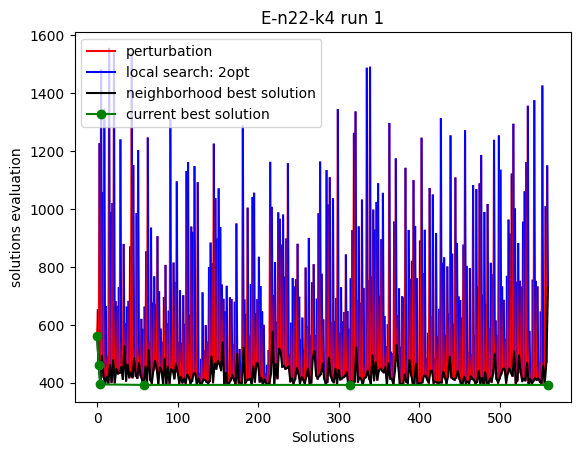

End of run 1 with best solution quality 392.25074354060905 total evaluations: 750015.566539606


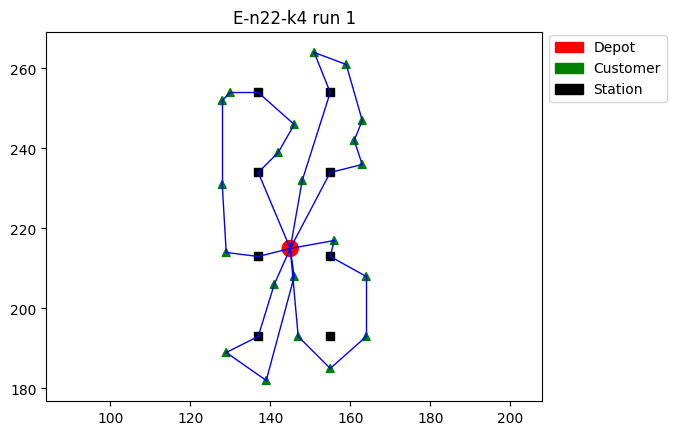

Run: 2 with random seed 2


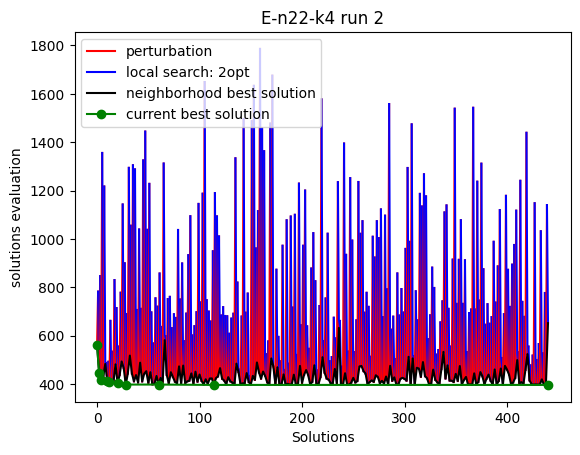

End of run 2 with best solution quality 396.9370350416243 total evaluations: 750030.6665391122


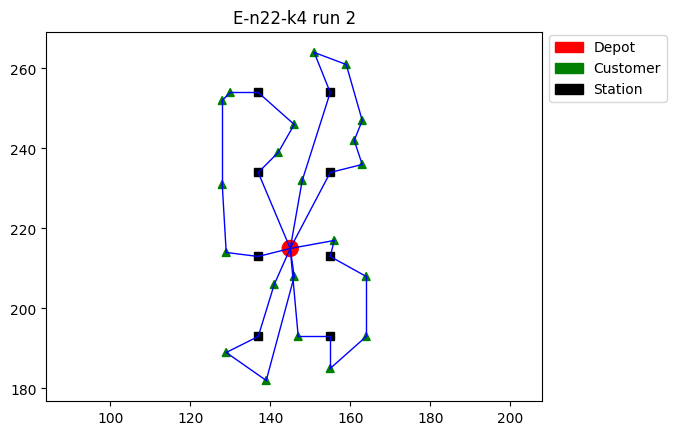

Run: 3 with random seed 3


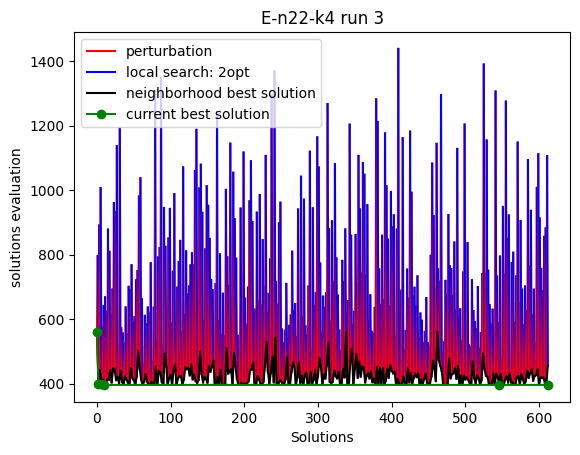

End of run 3 with best solution quality 396.3131639795228 total evaluations: 750105.733206455


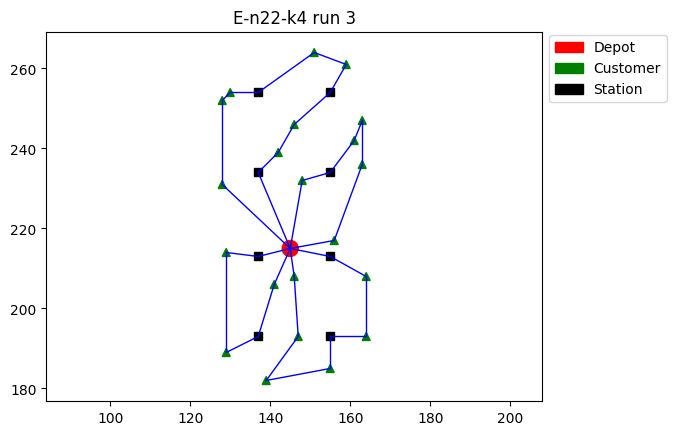

Run: 4 with random seed 4


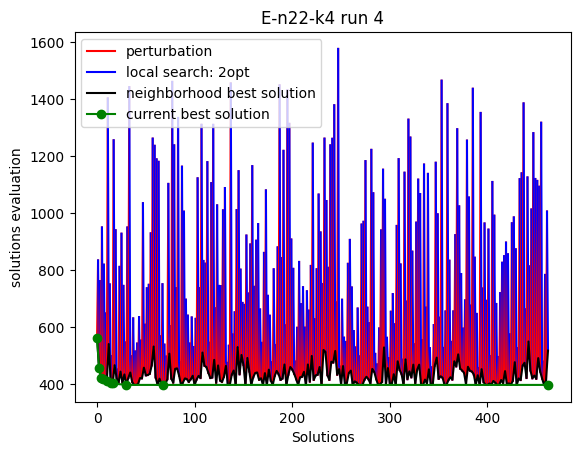

End of run 4 with best solution quality 396.3131639795228 total evaluations: 750082.9332056977


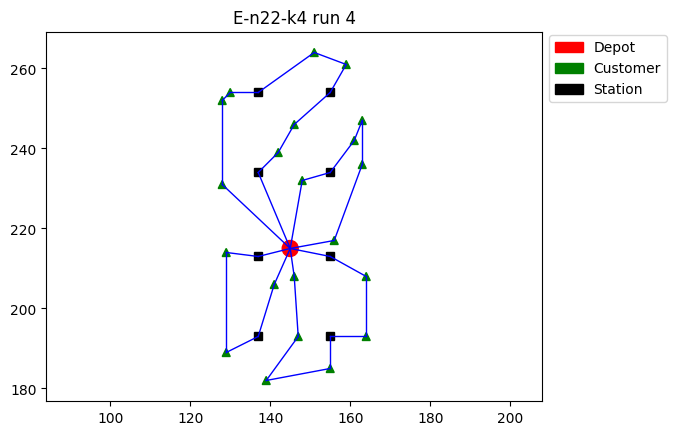

Run: 5 with random seed 5


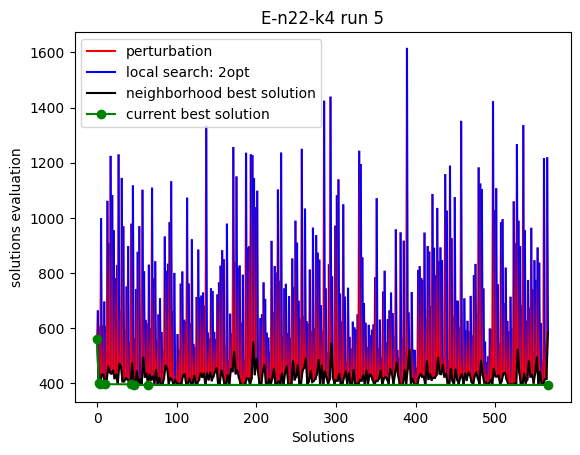

End of run 5 with best solution quality 394.57607360747306 total evaluations: 750074.6332061385


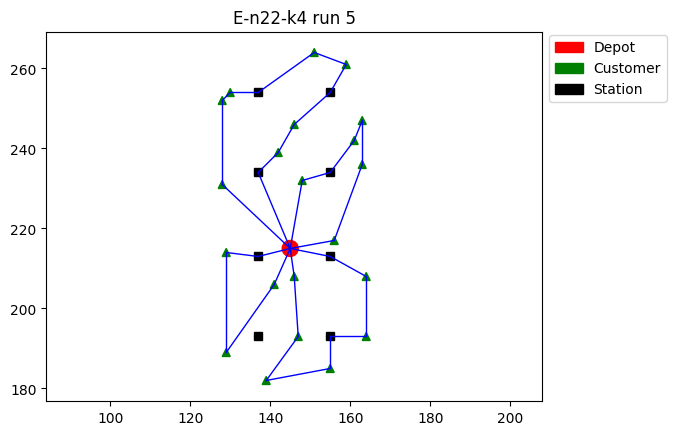

Run: 6 with random seed 6


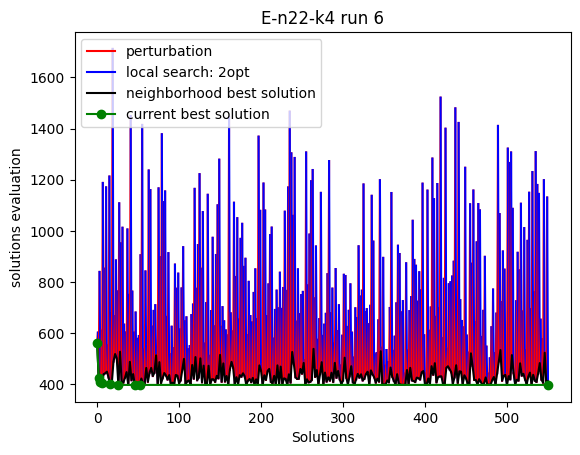

End of run 6 with best solution quality 396.93703504162437 total evaluations: 750055.1998730738


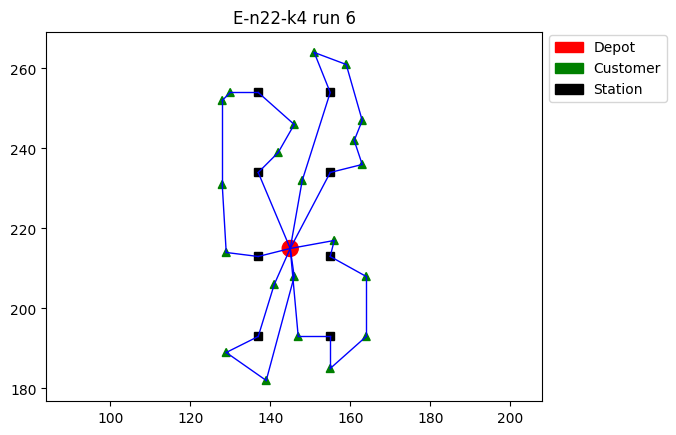

Run: 7 with random seed 7


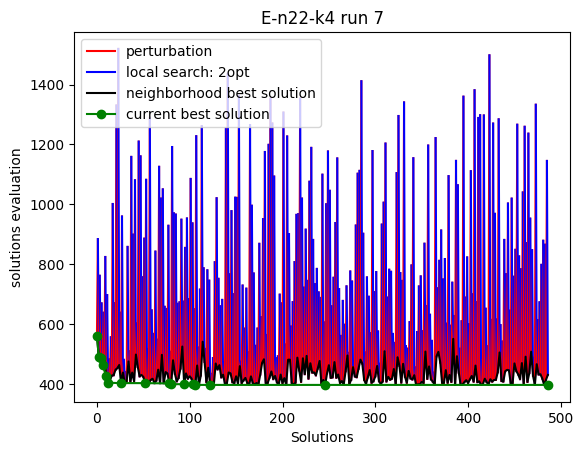

End of run 7 with best solution quality 396.9370350416243 total evaluations: 750110.6665394468


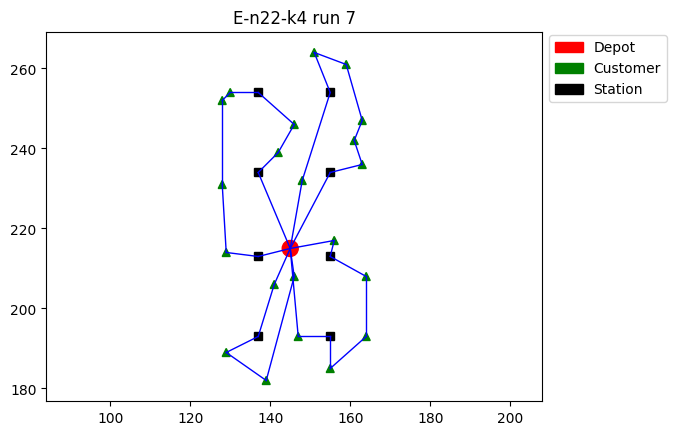

Run: 8 with random seed 8


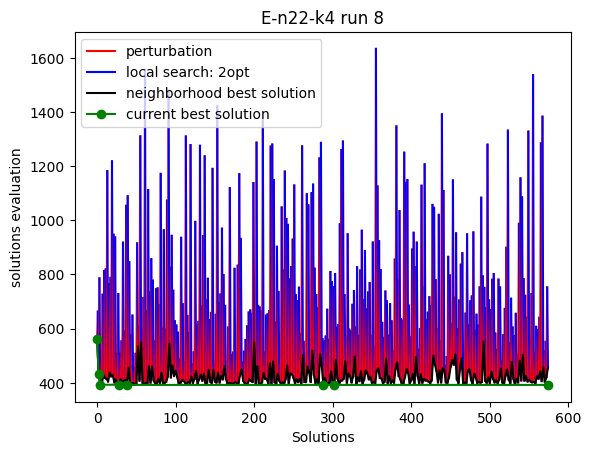

End of run 8 with best solution quality 392.2507435406091 total evaluations: 750080.7665397555


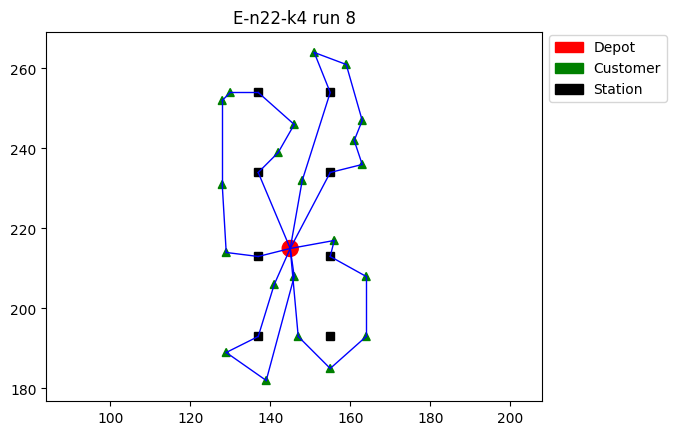

Run: 9 with random seed 9


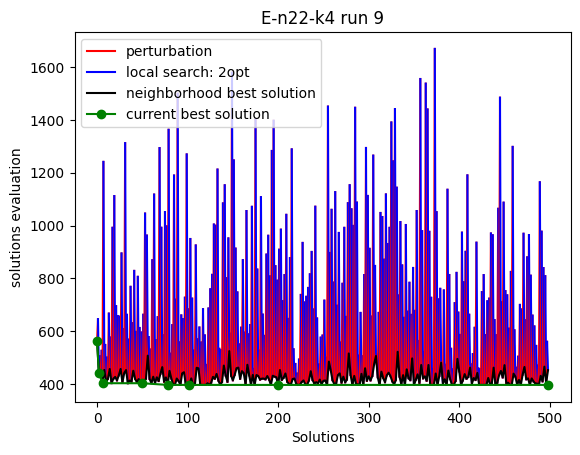

End of run 9 with best solution quality 396.3131639795228 total evaluations: 750014.6665392714


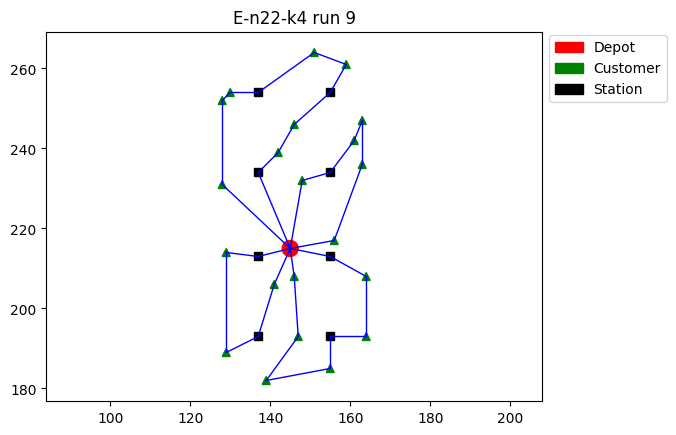

Run: 10 with random seed 10


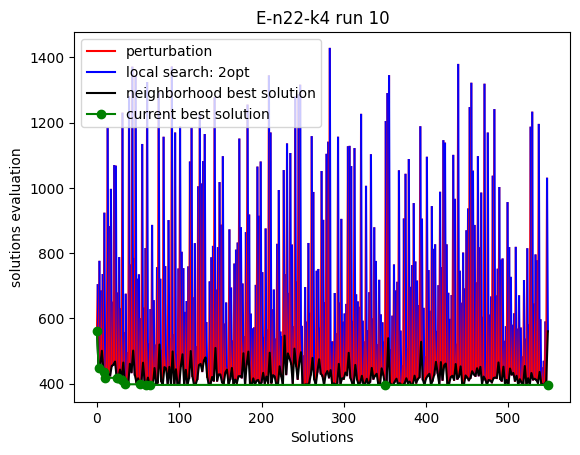

End of run 10 with best solution quality 396.3131639795228 total evaluations: 750015.9998731008


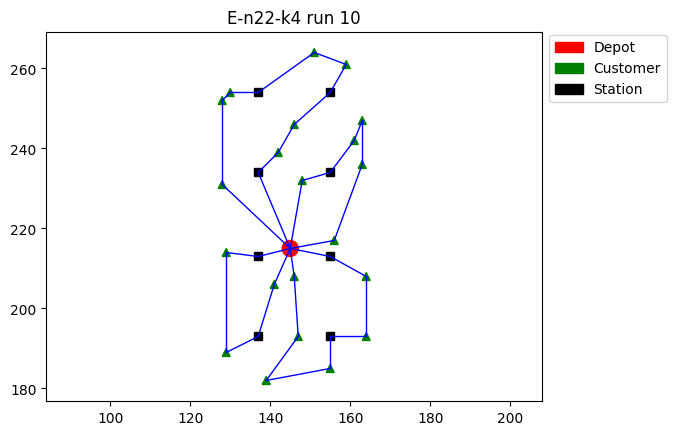

Run: 11 with random seed 11


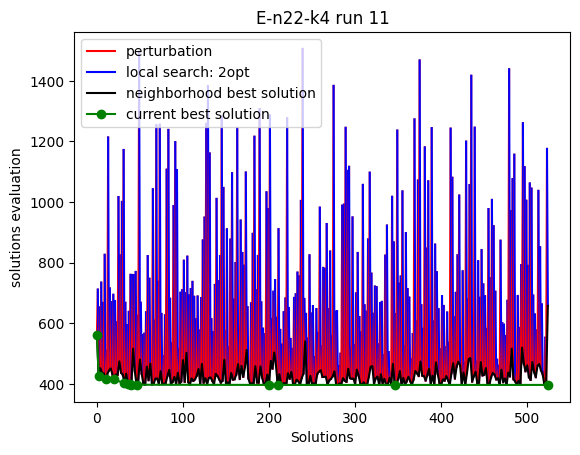

End of run 11 with best solution quality 396.3131639795228 total evaluations: 750071.733205935


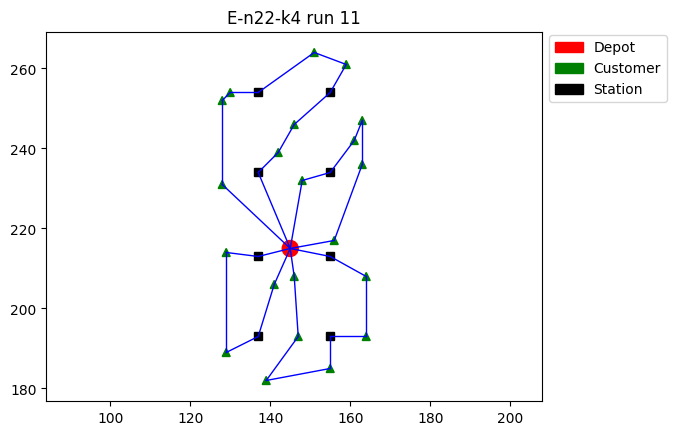

Run: 12 with random seed 12


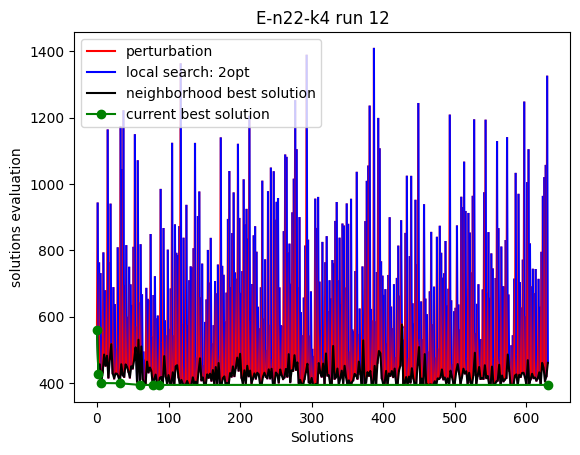

End of run 12 with best solution quality 394.57607360747306 total evaluations: 750005.5665395521


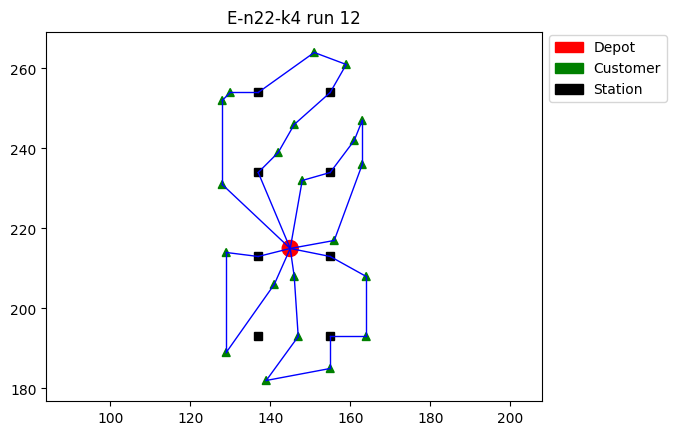

Run: 13 with random seed 13


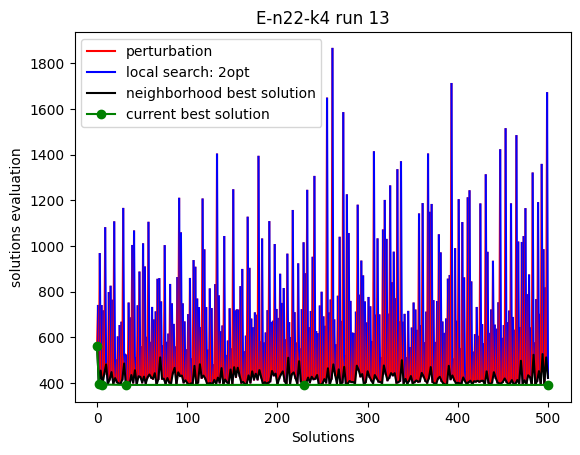

End of run 13 with best solution quality 392.25074354060905 total evaluations: 750261.9665390375


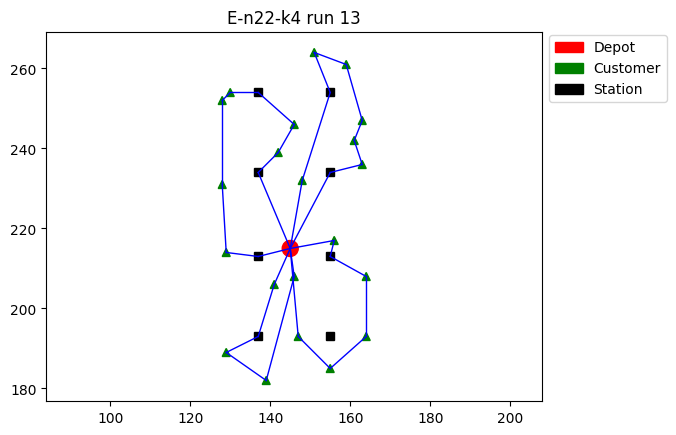

Run: 14 with random seed 14


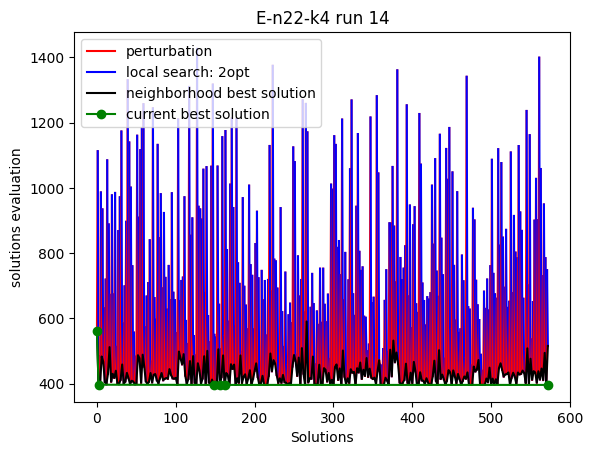

End of run 14 with best solution quality 396.3131639795228 total evaluations: 750047.7332064336


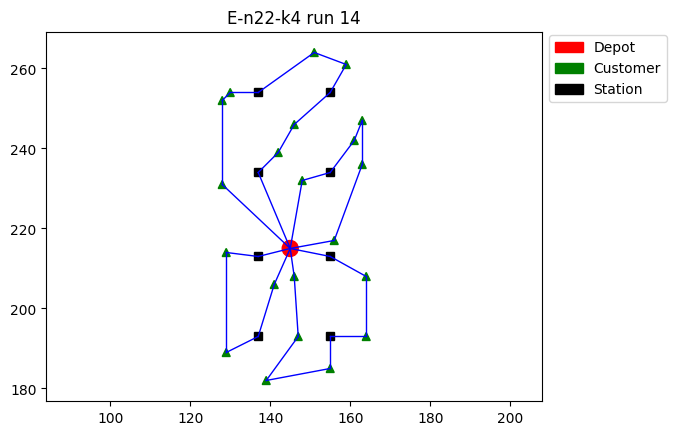

Run: 15 with random seed 15


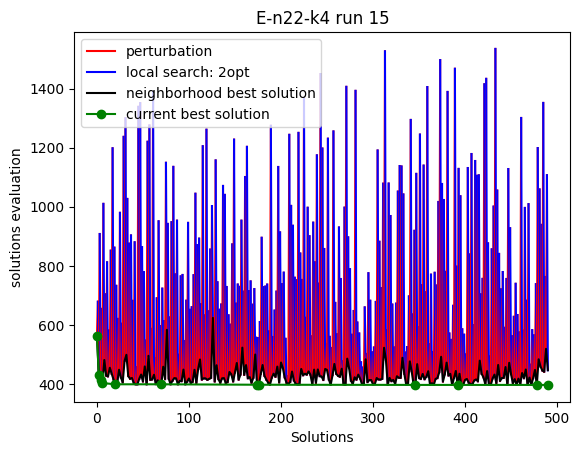

End of run 15 with best solution quality 396.3131639795228 total evaluations: 750165.9998727732


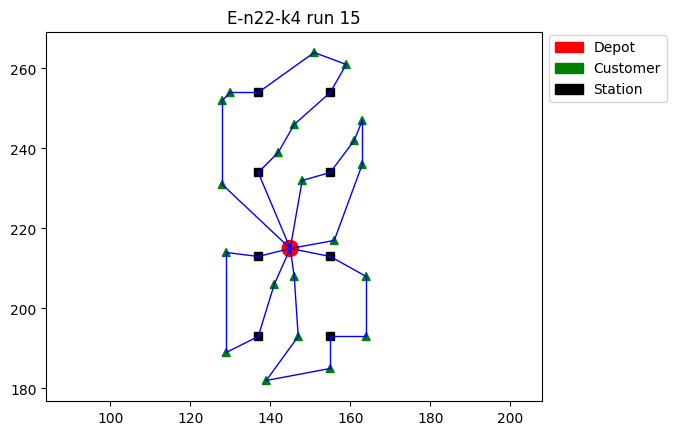

Run: 16 with random seed 16


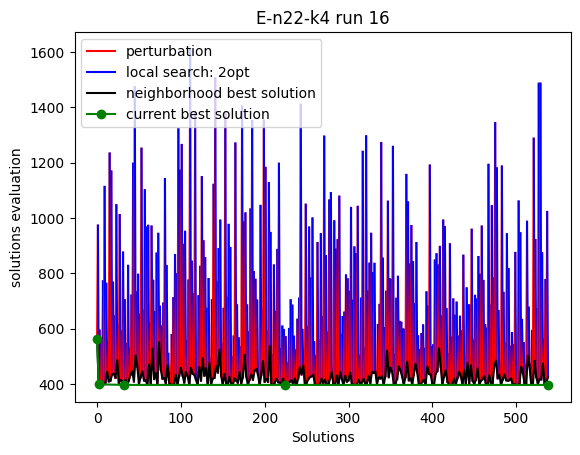

End of run 16 with best solution quality 396.3131639795228 total evaluations: 750056.3998728726


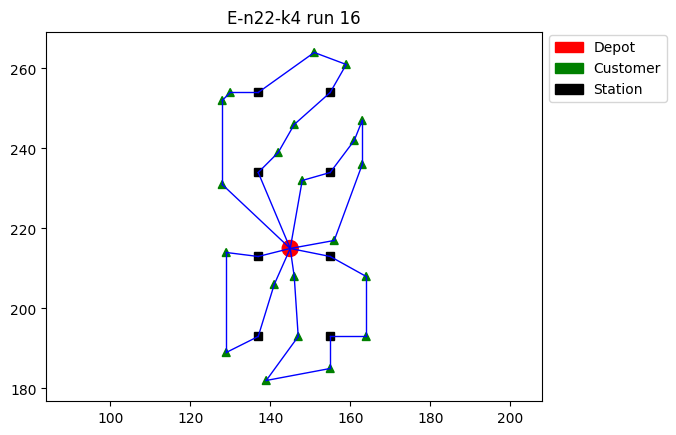

Run: 17 with random seed 17


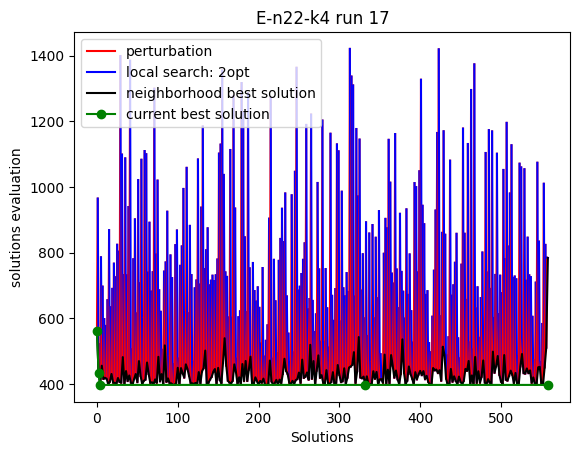

End of run 17 with best solution quality 396.93703504162437 total evaluations: 750023.7332062883


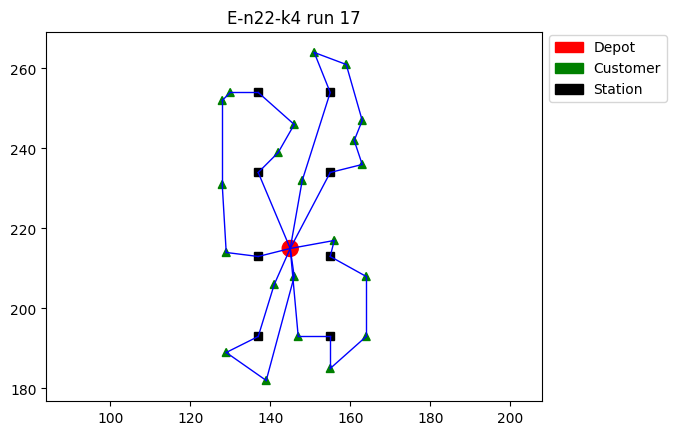

Run: 18 with random seed 18


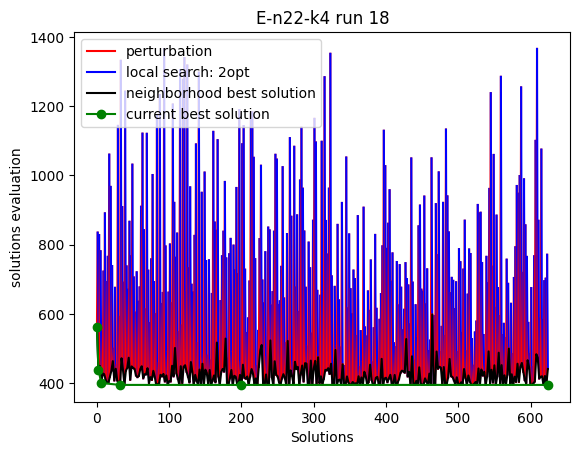

End of run 18 with best solution quality 394.57607360747306 total evaluations: 750022.2332063053


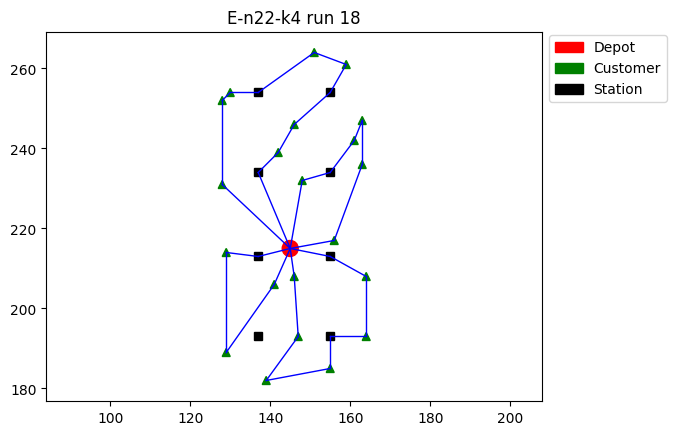

Run: 19 with random seed 19


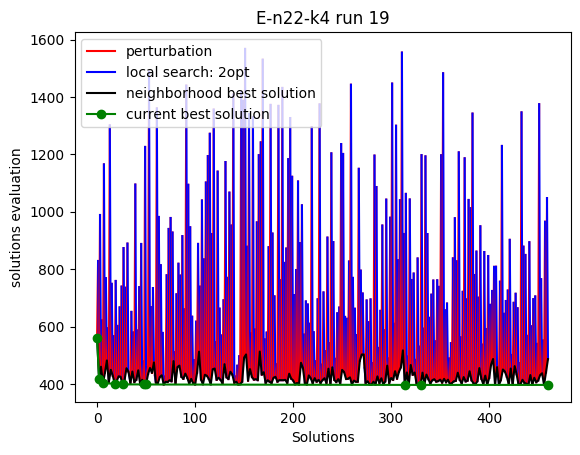

End of run 19 with best solution quality 396.93703504162437 total evaluations: 750067.3332056485


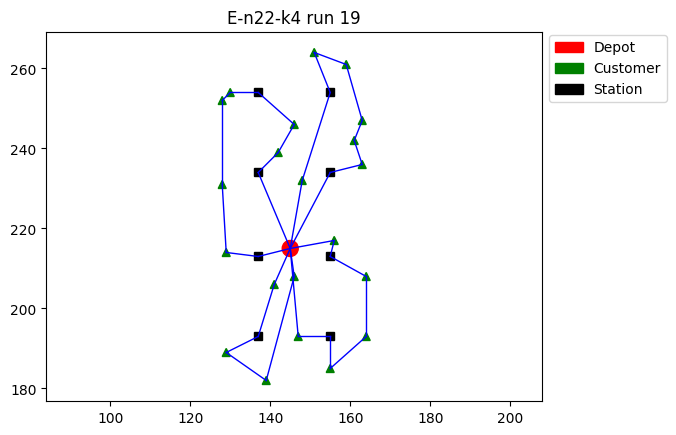

Run: 20 with random seed 20


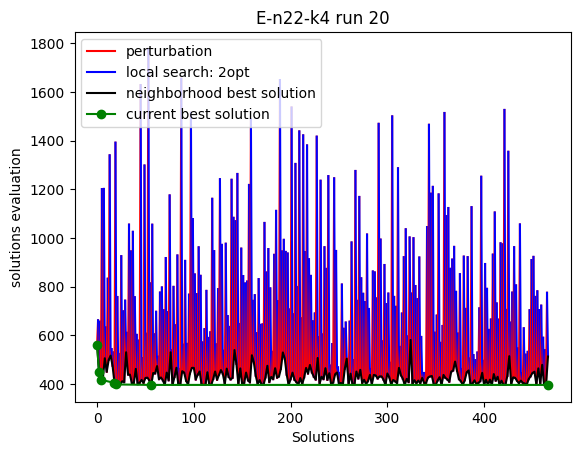

End of run 20 with best solution quality 396.31316397952287 total evaluations: 750056.1332058026


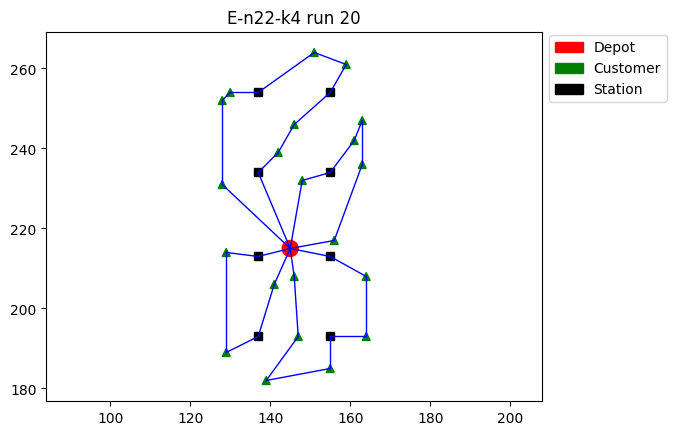

1 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n23-k3.evrp
========= E-n23-k3.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n23-k3.evrp.txt
Run: 1 with random seed 1


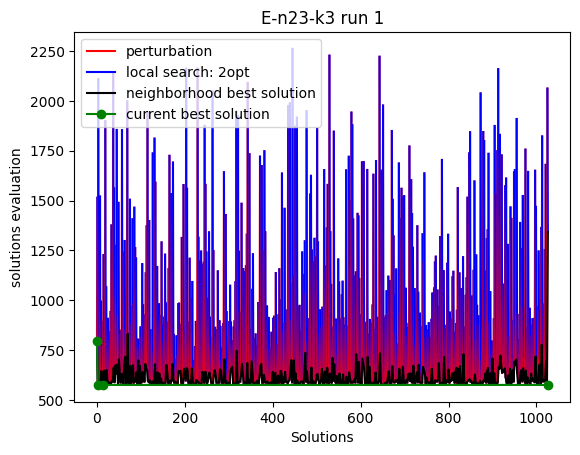

End of run 1 with best solution quality 575.0072162874258 total evaluations: 800012.25


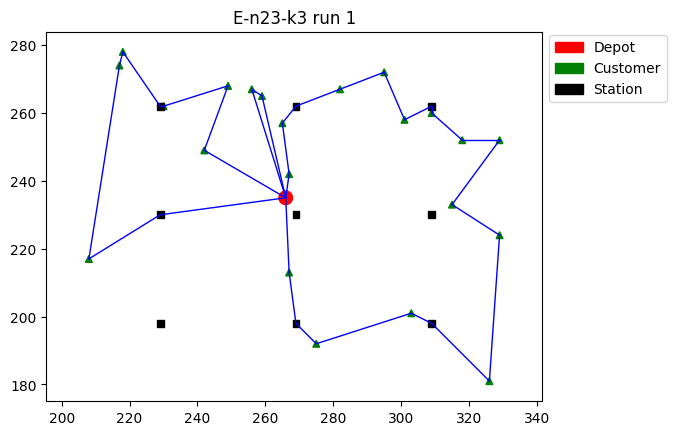

Run: 2 with random seed 2


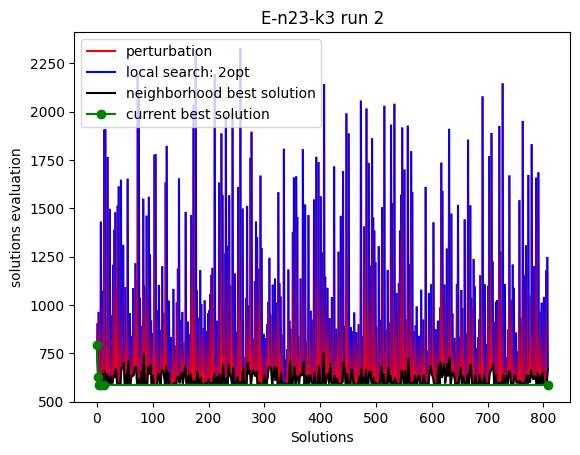

End of run 2 with best solution quality 586.8781953785766 total evaluations: 800104.8125


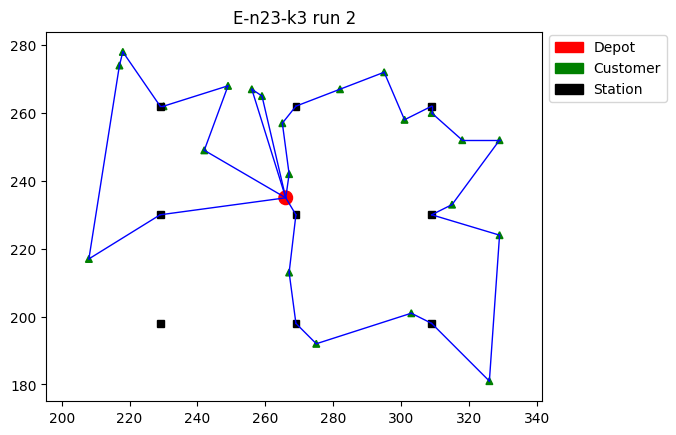

Run: 3 with random seed 3


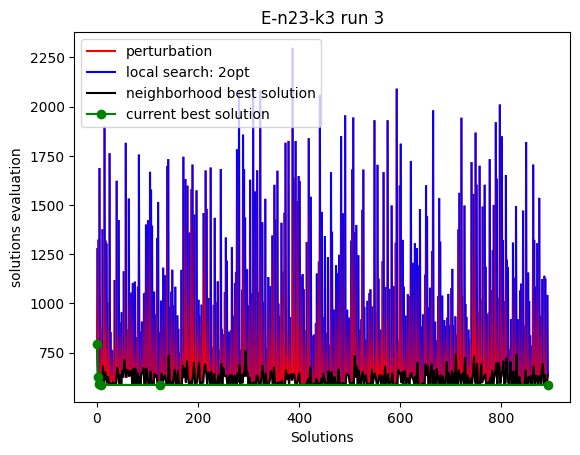

End of run 3 with best solution quality 585.5726137056866 total evaluations: 800011.03125


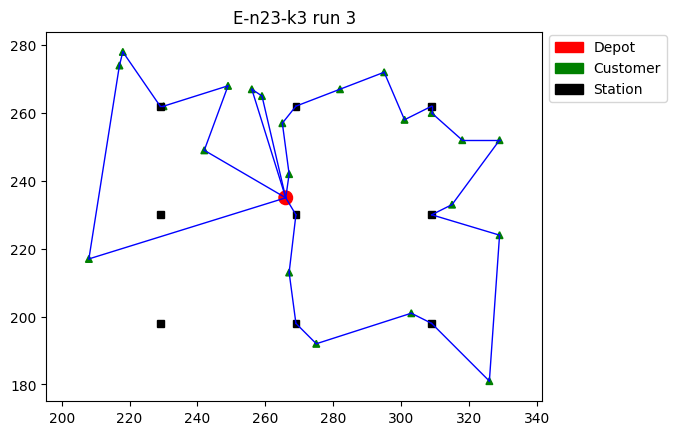

Run: 4 with random seed 4


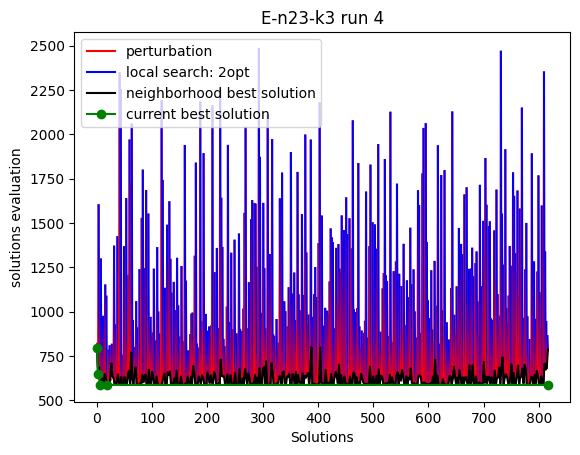

End of run 4 with best solution quality 585.9527162606529 total evaluations: 800055.53125


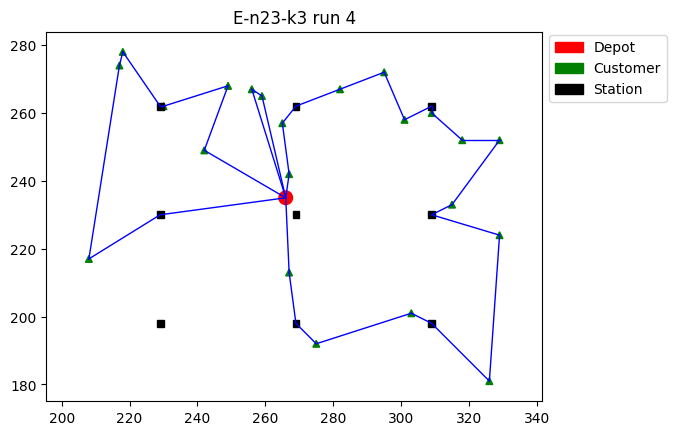

Run: 5 with random seed 5


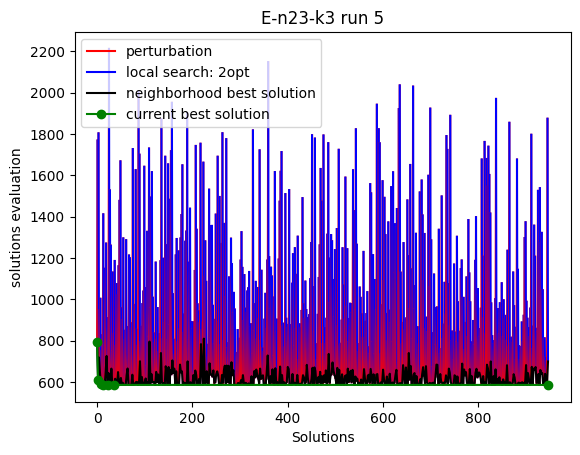

End of run 5 with best solution quality 585.9527162606529 total evaluations: 800054.90625


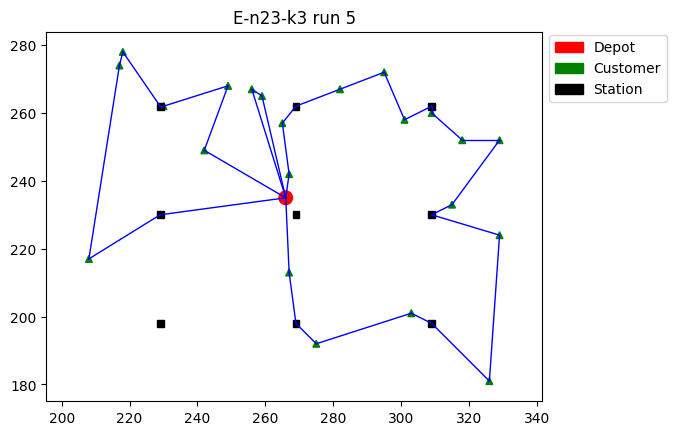

Run: 6 with random seed 6


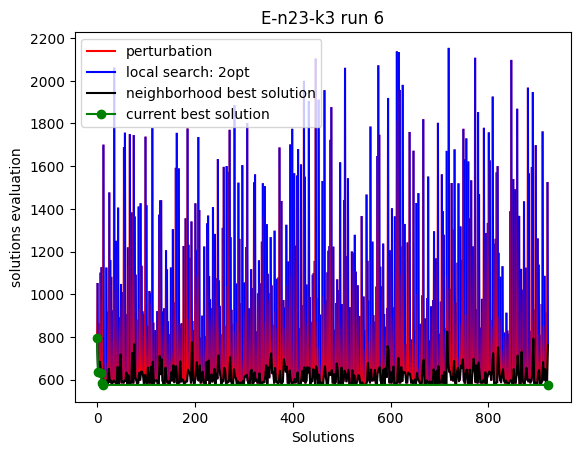

End of run 6 with best solution quality 575.0072162874258 total evaluations: 800030.75


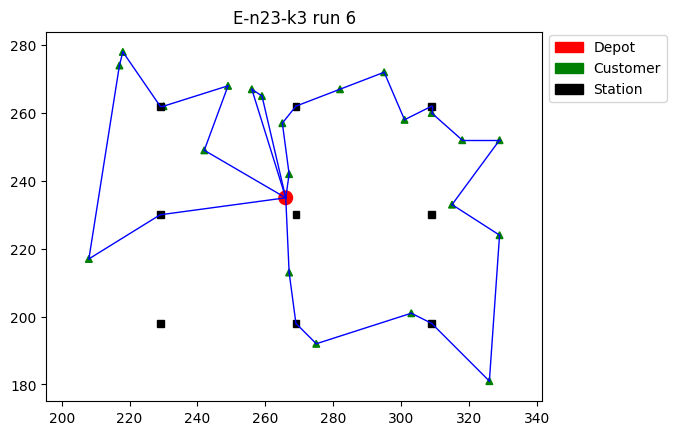

Run: 7 with random seed 7


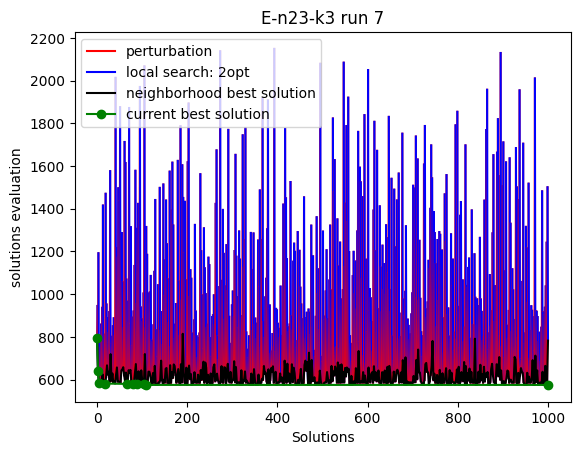

End of run 7 with best solution quality 574.6271137324595 total evaluations: 800027.375


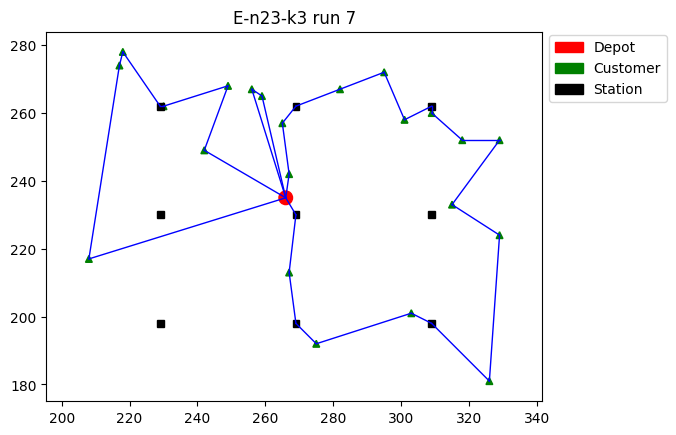

Run: 8 with random seed 8


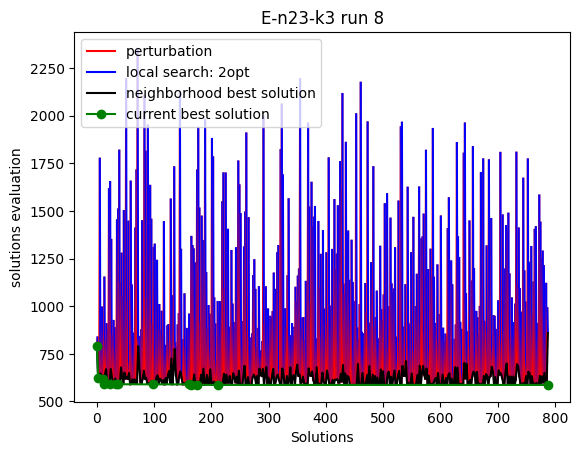

End of run 8 with best solution quality 586.8781953785766 total evaluations: 800031.875


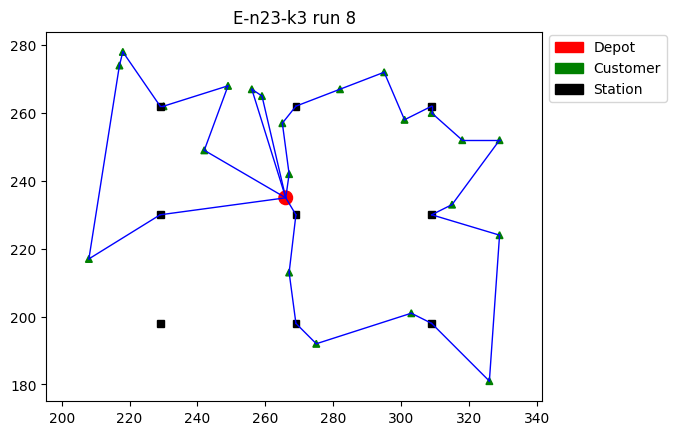

Run: 9 with random seed 9


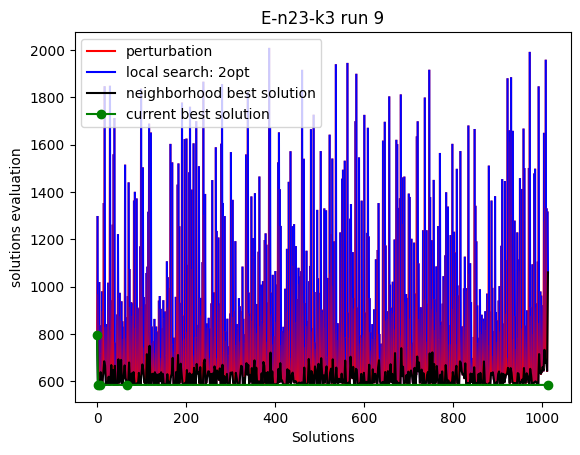

End of run 9 with best solution quality 584.1801347198128 total evaluations: 800019.34375


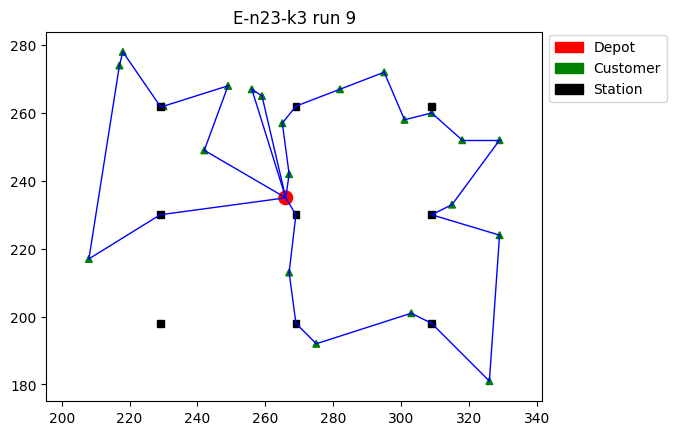

Run: 10 with random seed 10


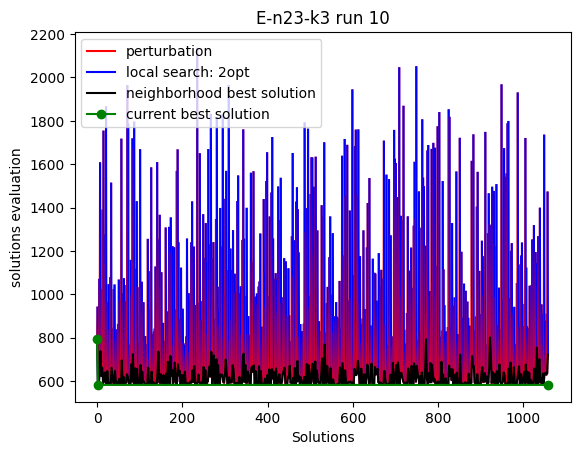

End of run 10 with best solution quality 582.1088333314732 total evaluations: 800041.34375


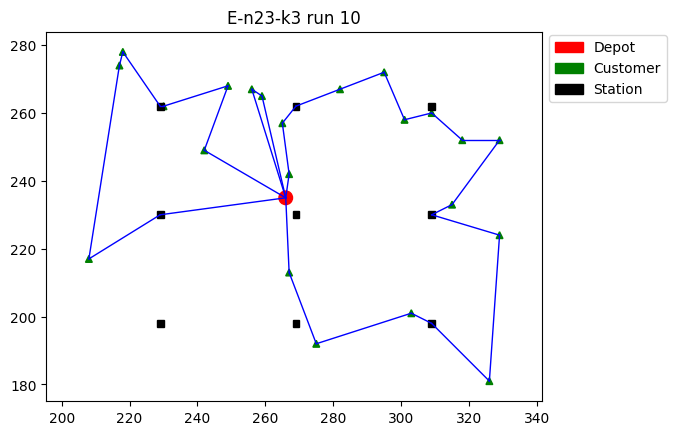

Run: 11 with random seed 11


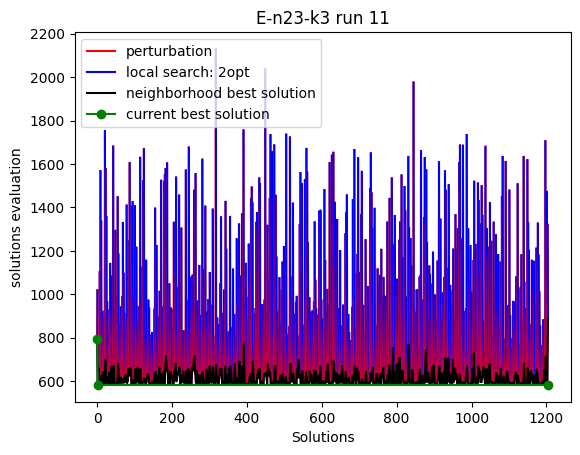

End of run 11 with best solution quality 581.949073928999 total evaluations: 800007.90625


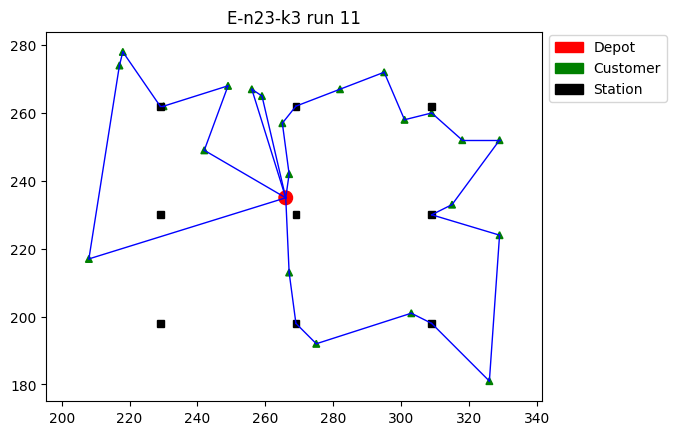

Run: 12 with random seed 12


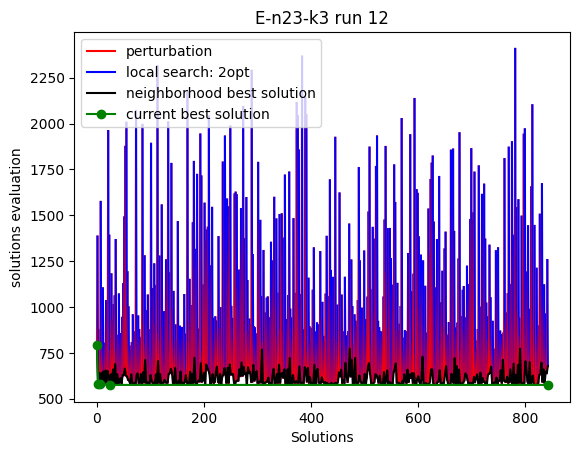

End of run 12 with best solution quality 575.0072162874258 total evaluations: 800032.375


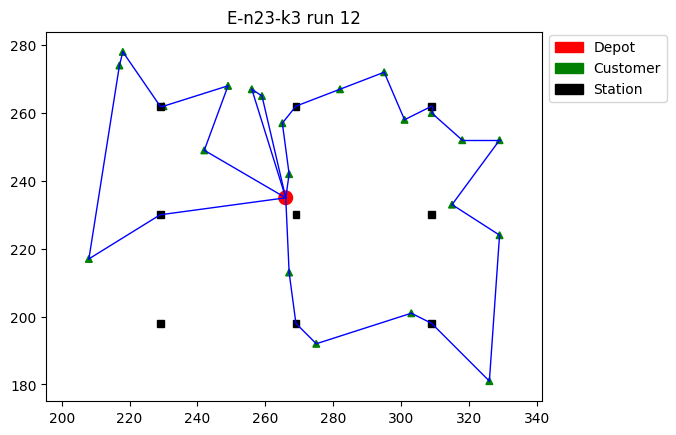

Run: 13 with random seed 13


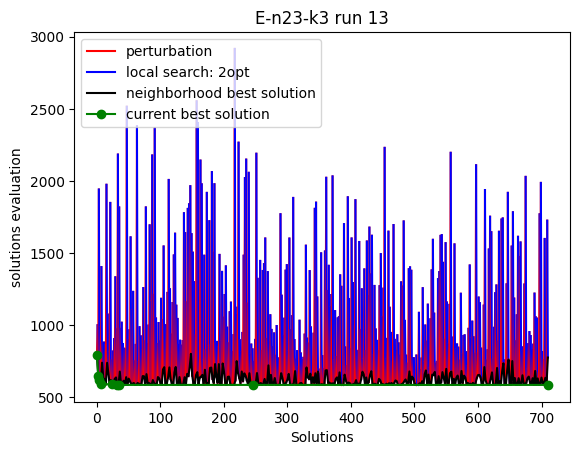

End of run 13 with best solution quality 586.8781953785766 total evaluations: 800051.125


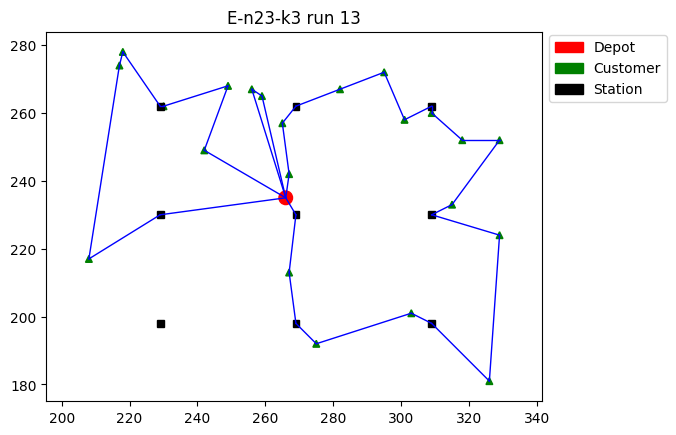

Run: 14 with random seed 14


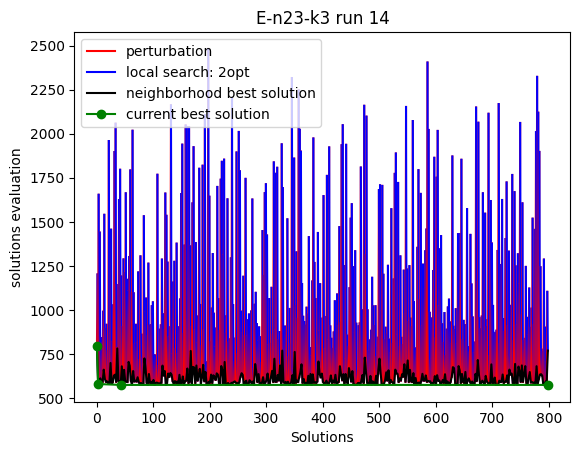

End of run 14 with best solution quality 575.0072162874258 total evaluations: 800027.3125


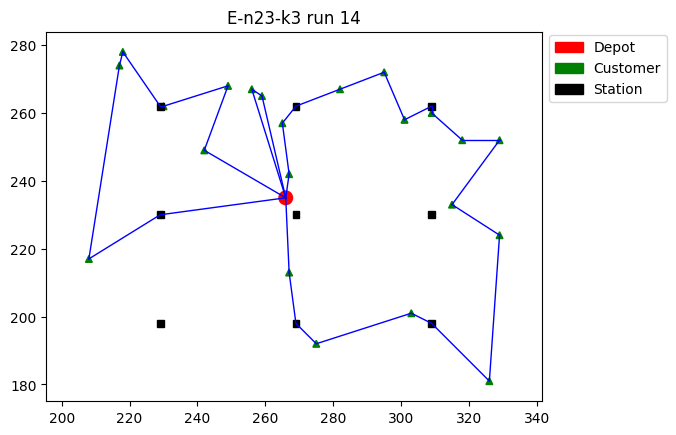

Run: 15 with random seed 15


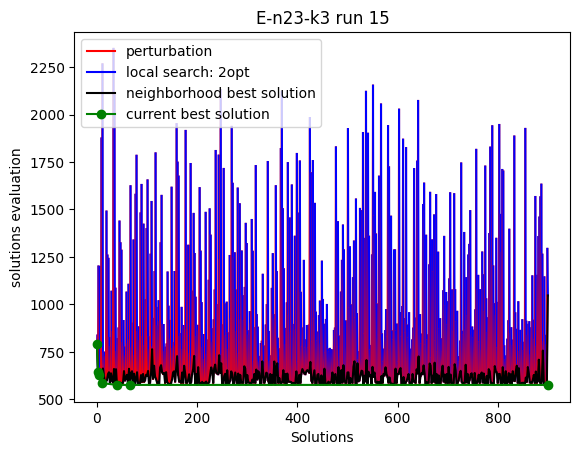

End of run 15 with best solution quality 575.9326954053495 total evaluations: 800030.15625


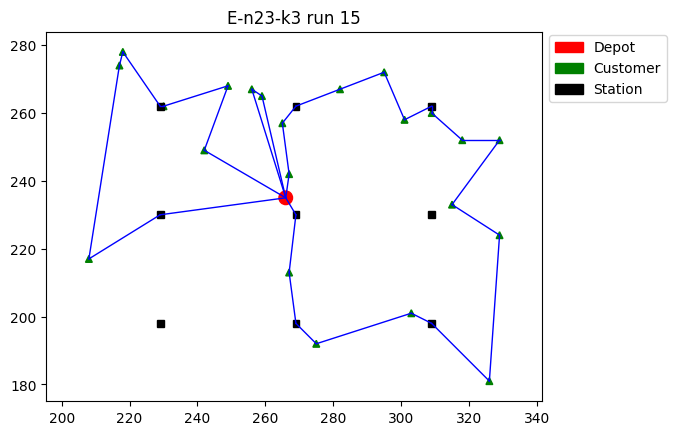

Run: 16 with random seed 16


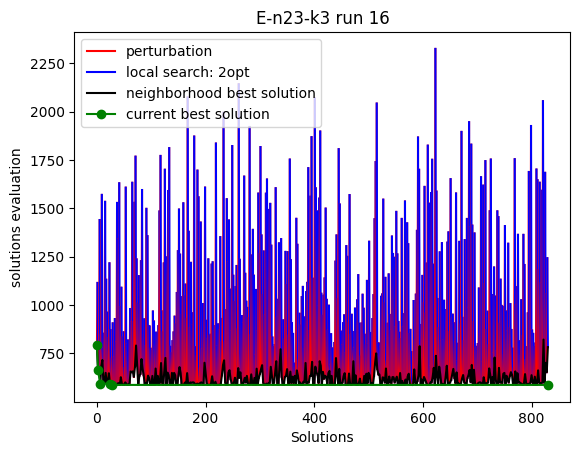

End of run 16 with best solution quality 586.8781953785766 total evaluations: 800016.4375


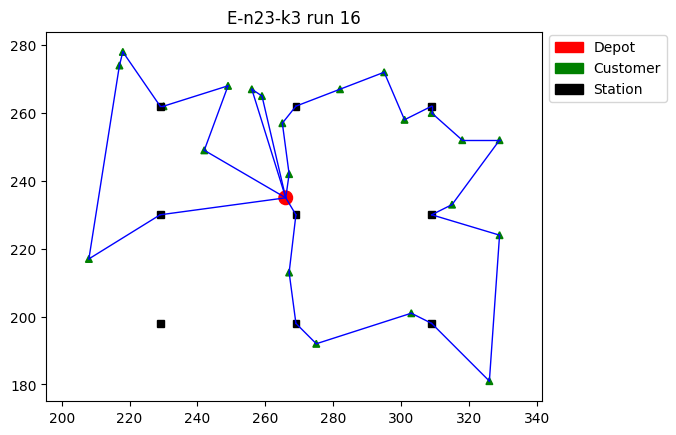

Run: 17 with random seed 17


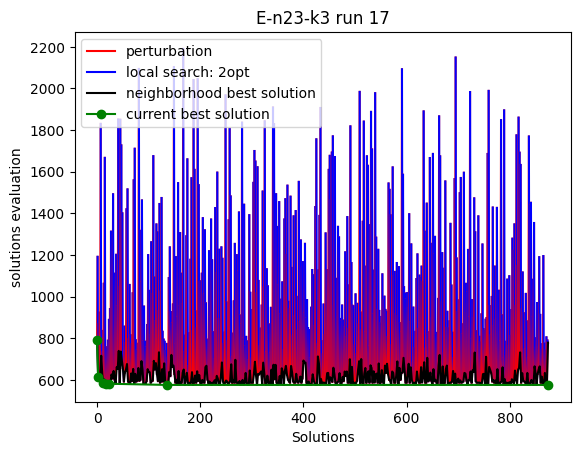

End of run 17 with best solution quality 575.9326954053495 total evaluations: 800064.09375


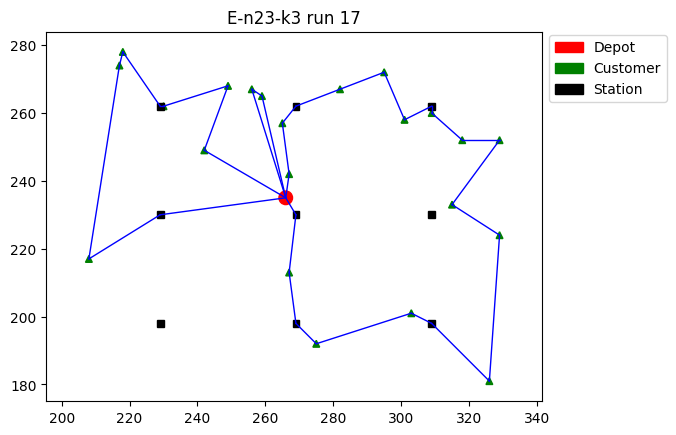

Run: 18 with random seed 18


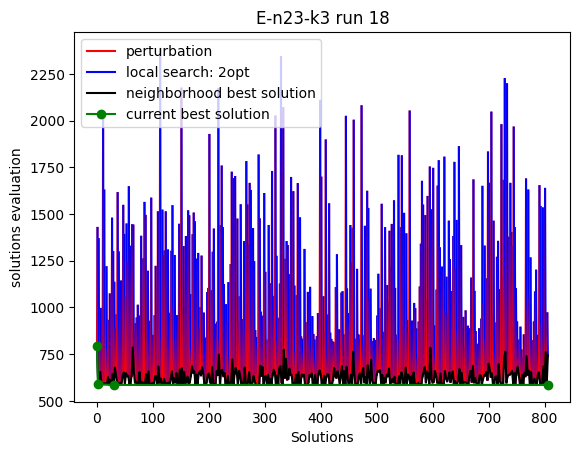

End of run 18 with best solution quality 585.7323731081608 total evaluations: 800024.96875


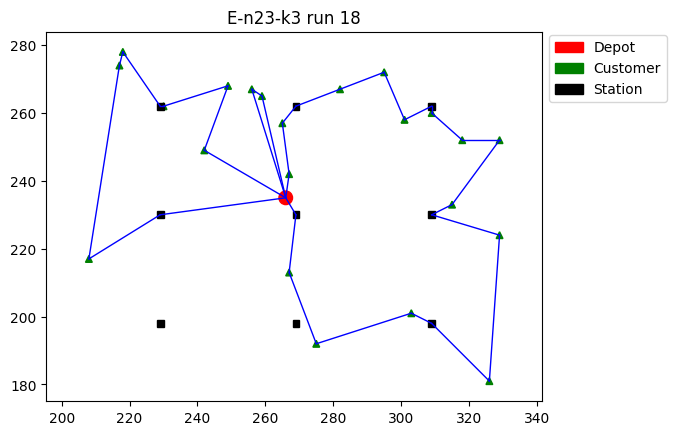

Run: 19 with random seed 19


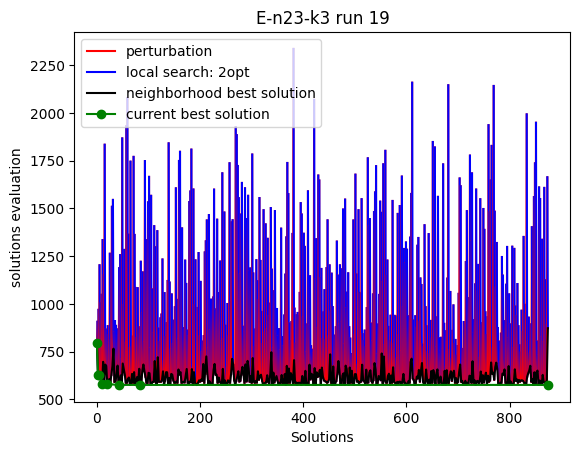

End of run 19 with best solution quality 575.9326954053495 total evaluations: 800066.78125


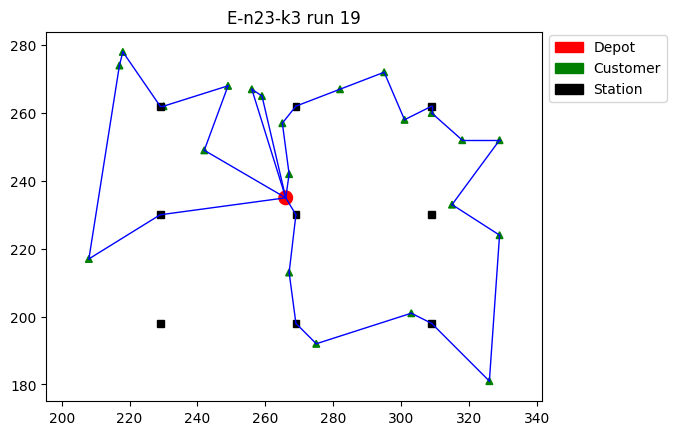

Run: 20 with random seed 20


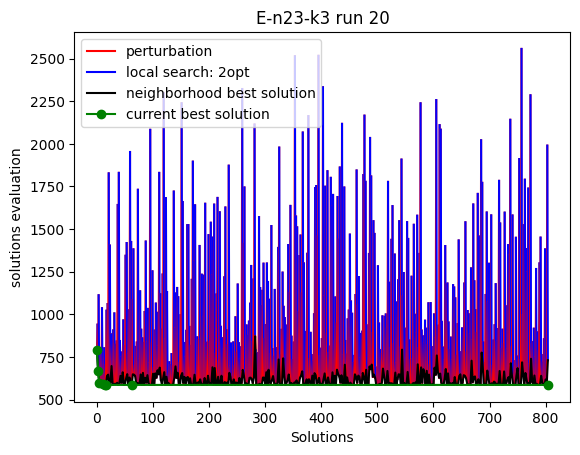

End of run 20 with best solution quality 585.9527162606529 total evaluations: 800092.46875


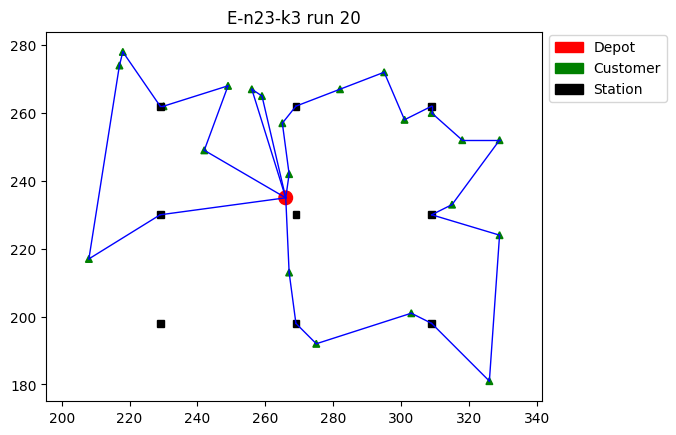

2 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n30-k3.evrp
========= E-n30-k3.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n30-k3.evrp.txt
Run: 1 with random seed 1


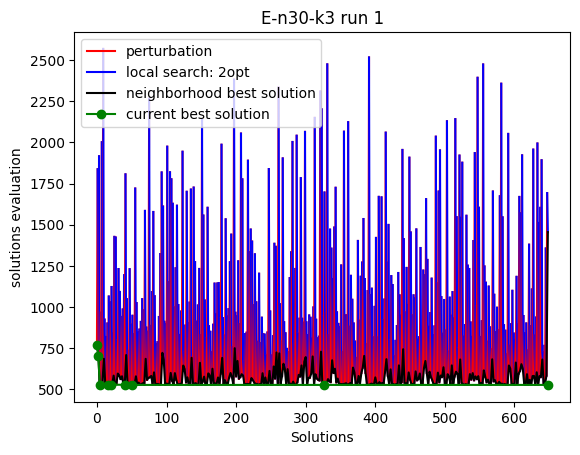

End of run 1 with best solution quality 527.6591130892524 total evaluations: 900006.0272327305


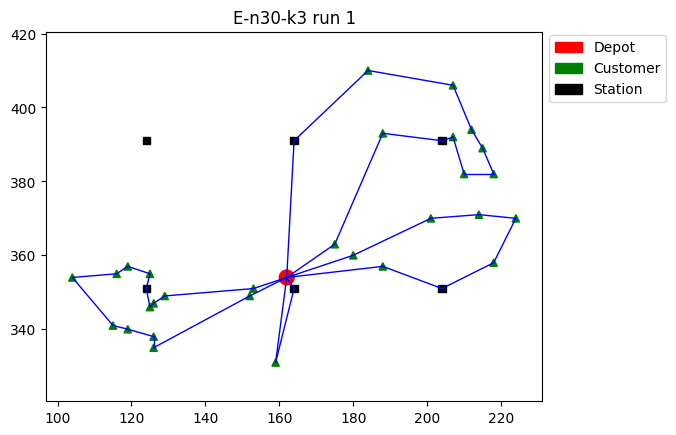

Run: 2 with random seed 2


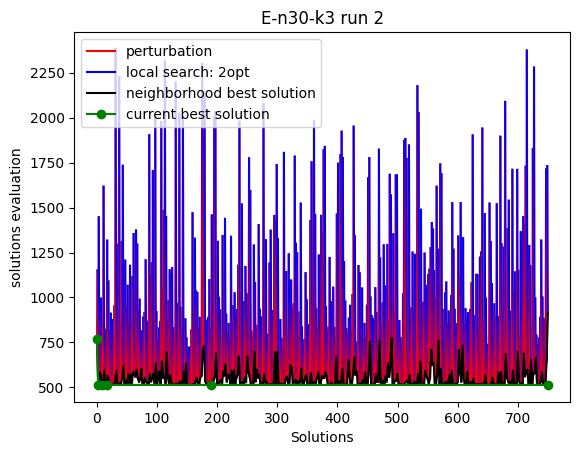

End of run 2 with best solution quality 513.2204890340764 total evaluations: 900025.9716778871


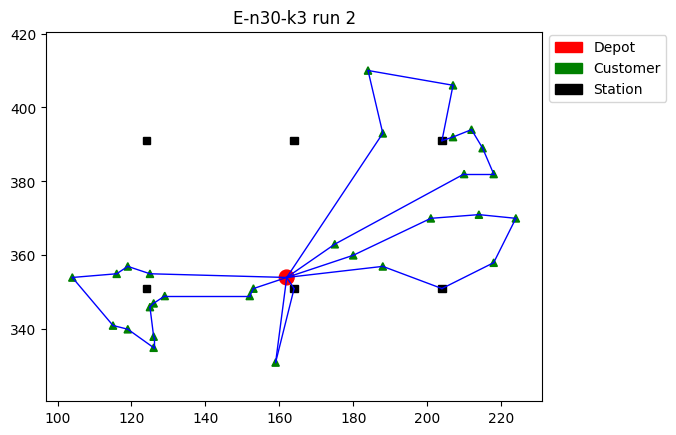

Run: 3 with random seed 3


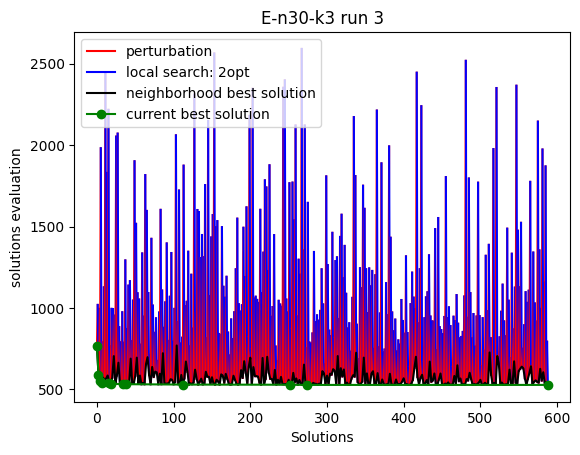

End of run 3 with best solution quality 527.6591130892524 total evaluations: 900052.5827868287


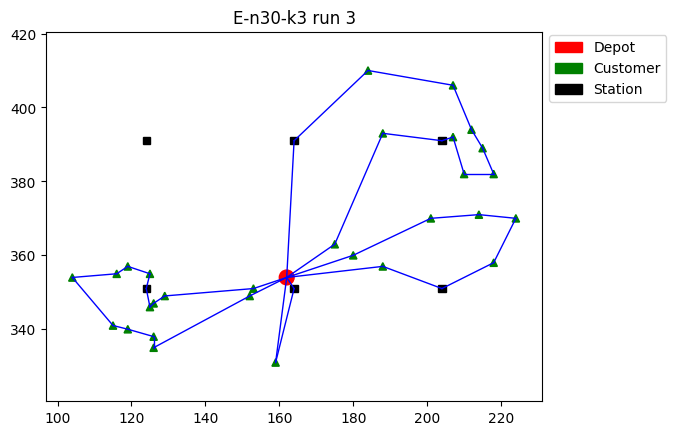

Run: 4 with random seed 4


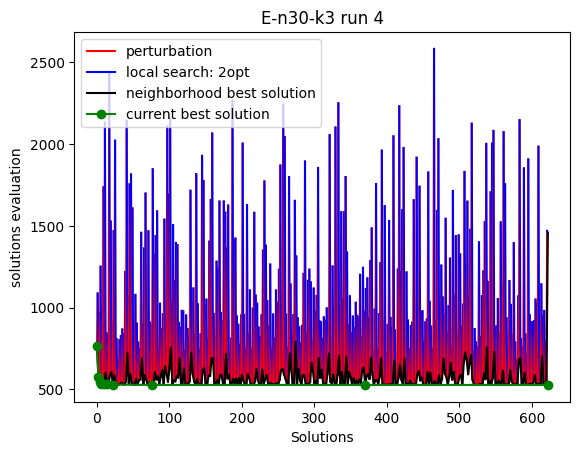

End of run 4 with best solution quality 527.6591130892524 total evaluations: 900111.0272315532


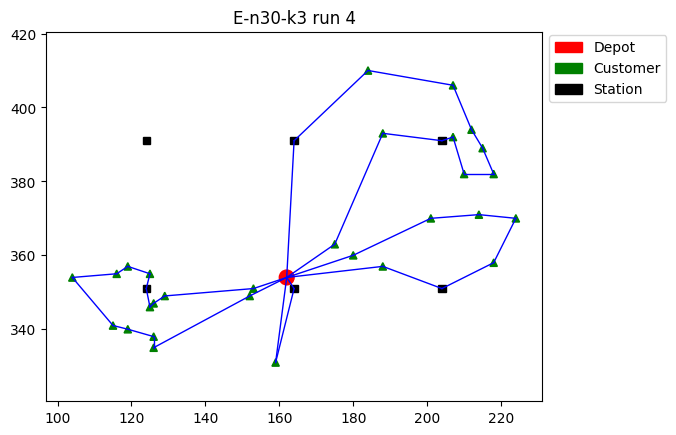

Run: 5 with random seed 5


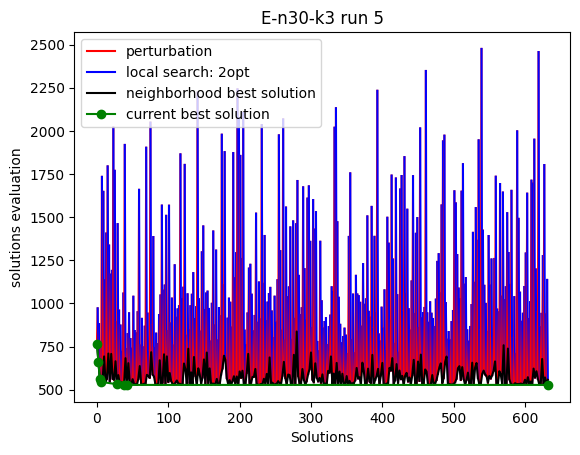

End of run 5 with best solution quality 527.6591130892525 total evaluations: 900079.027231186


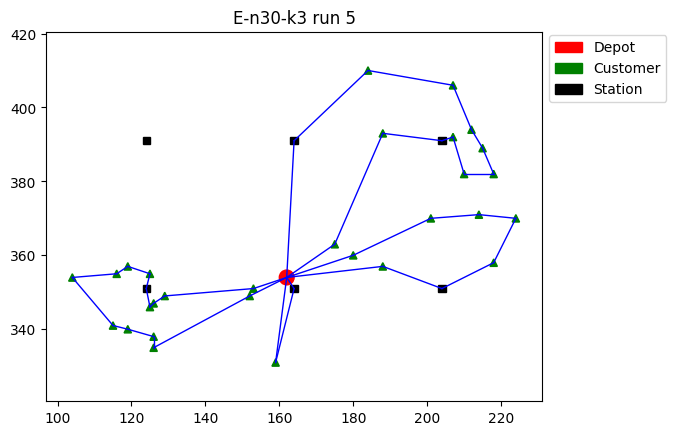

Run: 6 with random seed 6


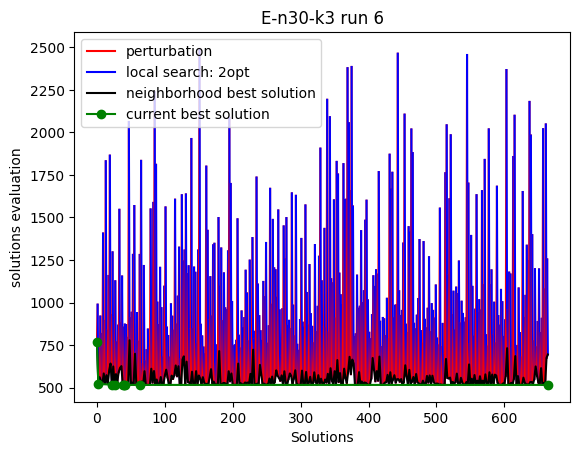

End of run 6 with best solution quality 515.6017371886334 total evaluations: 900066.1105652564


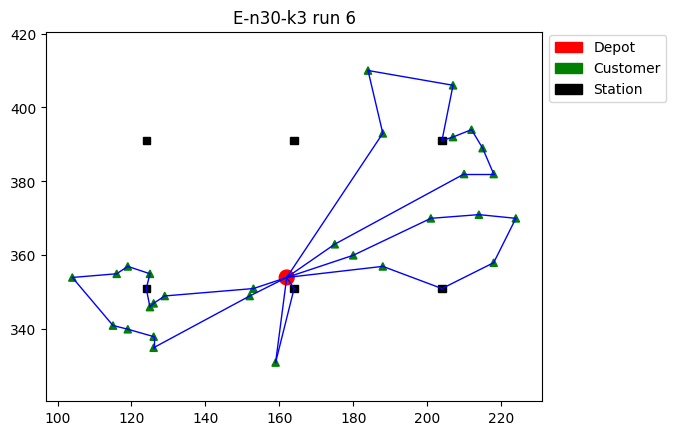

Run: 7 with random seed 7


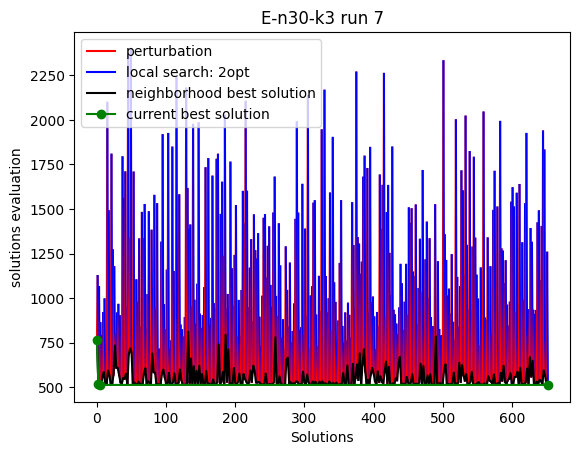

End of run 7 with best solution quality 512.8779158951071 total evaluations: 900011.9716765367


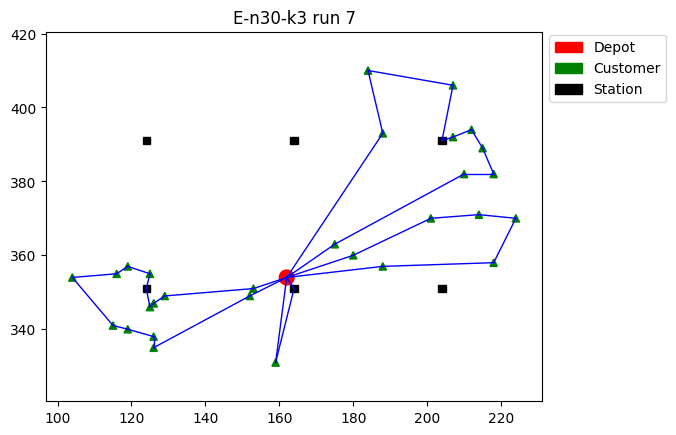

Run: 8 with random seed 8


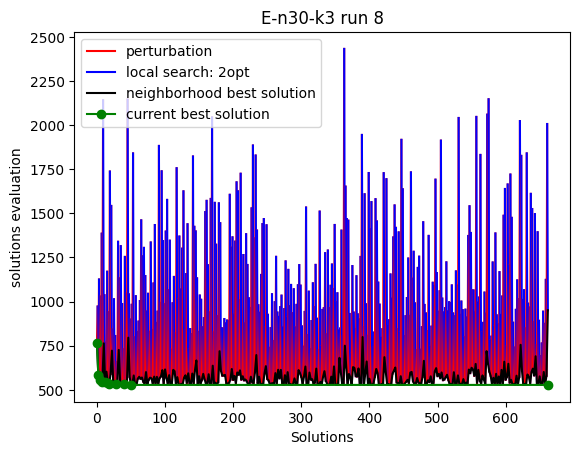

End of run 8 with best solution quality 527.6591130892525 total evaluations: 900062.3605654737


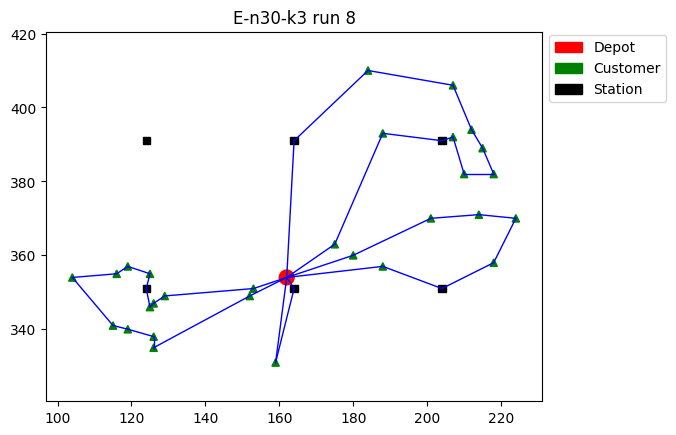

Run: 9 with random seed 9


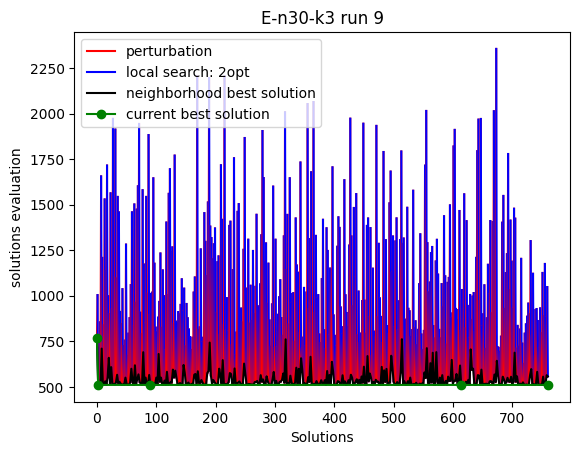

End of run 9 with best solution quality 510.49666774055015 total evaluations: 900091.166122216


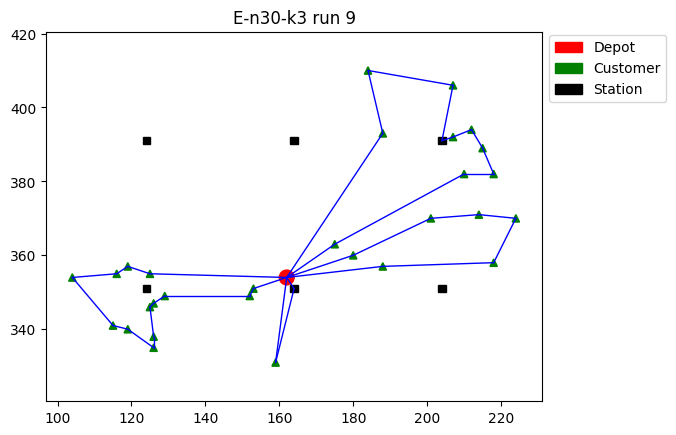

Run: 10 with random seed 10


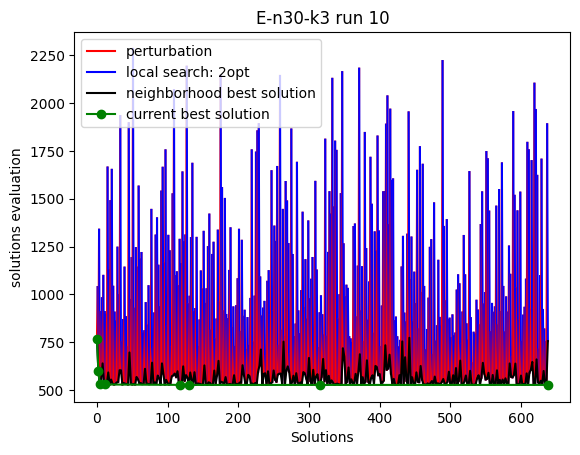

End of run 10 with best solution quality 527.6591130892524 total evaluations: 900008.8050090589


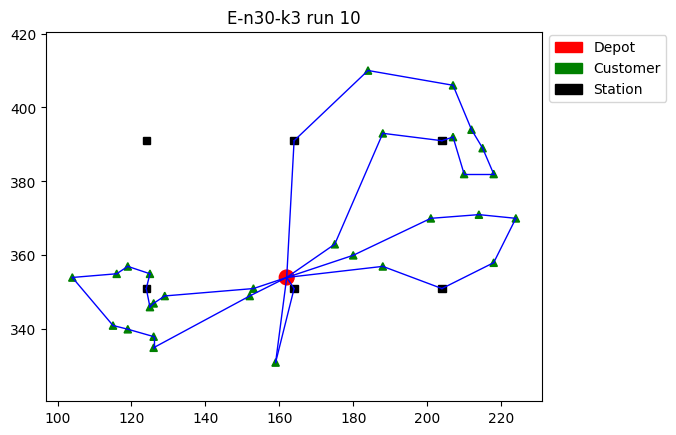

Run: 11 with random seed 11


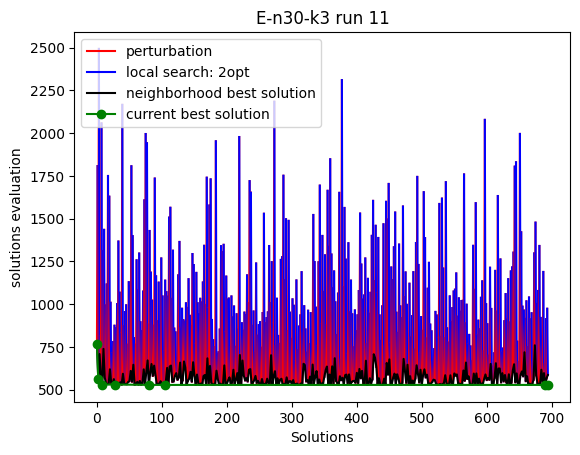

End of run 11 with best solution quality 527.6591130892524 total evaluations: 900006.693898842


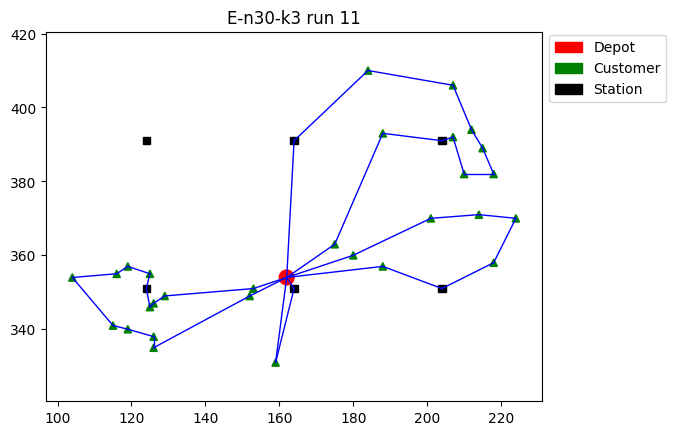

Run: 12 with random seed 12


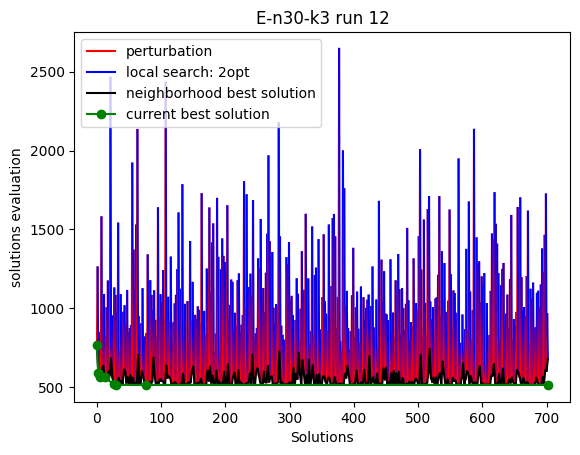

End of run 12 with best solution quality 515.6017371886334 total evaluations: 900034.1105653874


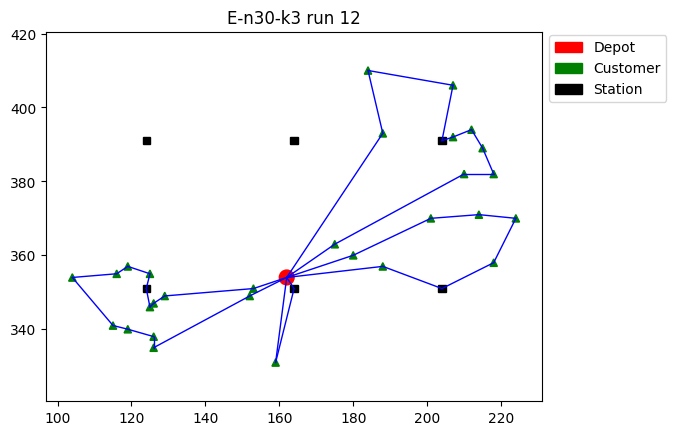

Run: 13 with random seed 13


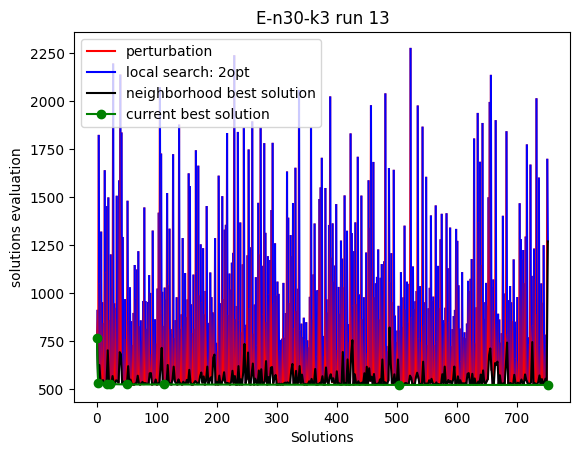

End of run 13 with best solution quality 522.5540436411692 total evaluations: 900024.305011607


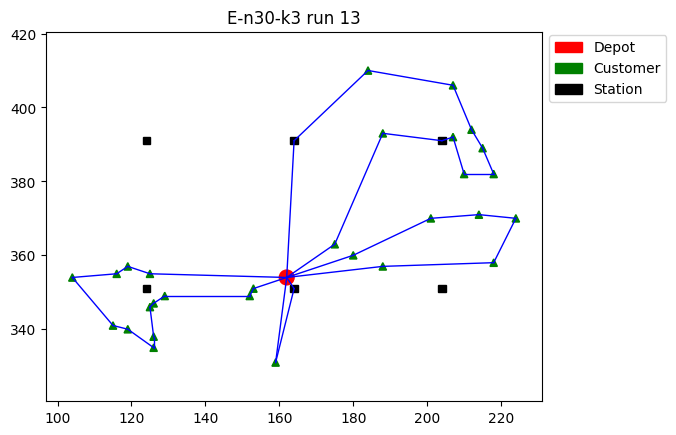

Run: 14 with random seed 14


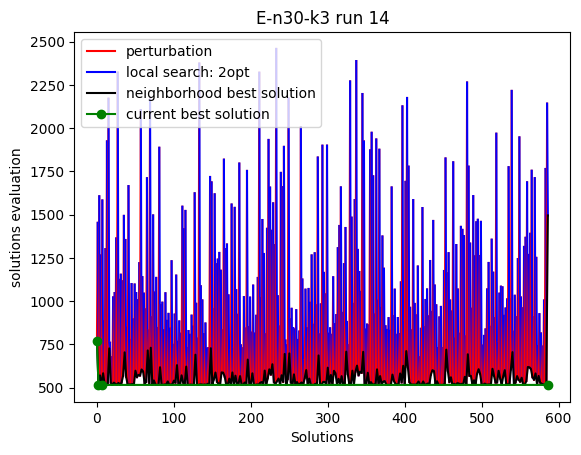

End of run 14 with best solution quality 515.6017371886334 total evaluations: 900007.9994525263


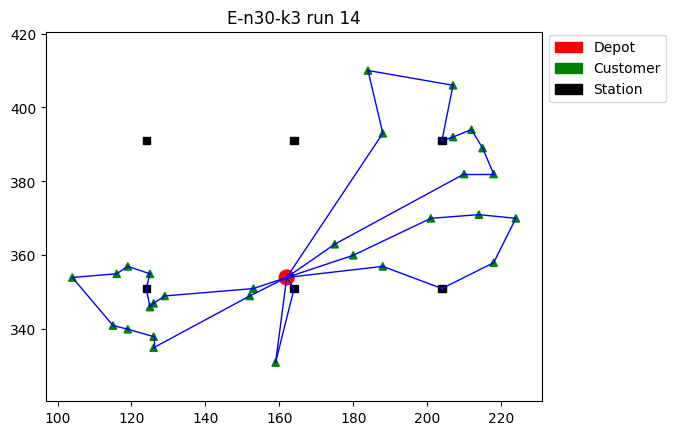

Run: 15 with random seed 15


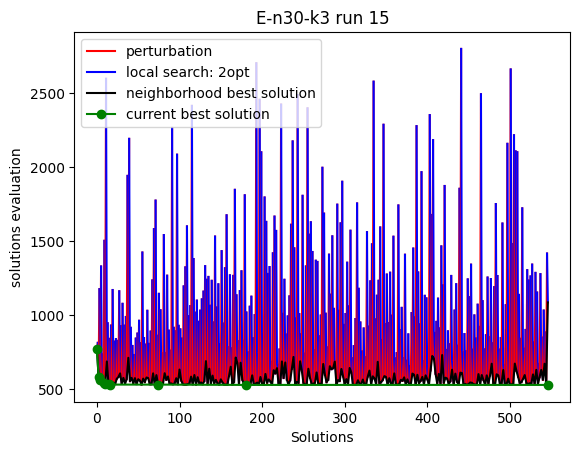

End of run 15 with best solution quality 527.6591130892525 total evaluations: 900030.8050063965


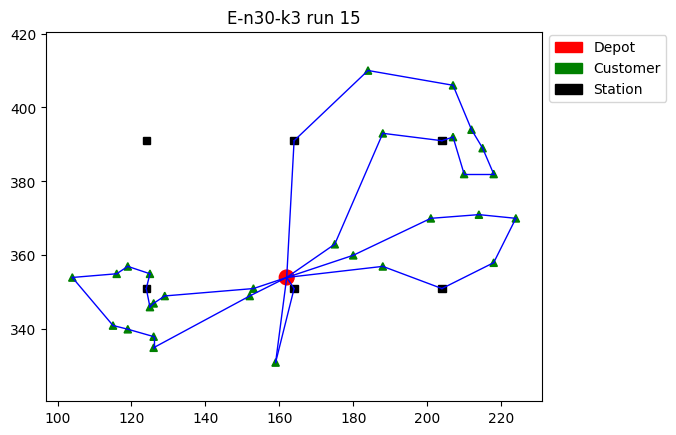

Run: 16 with random seed 16


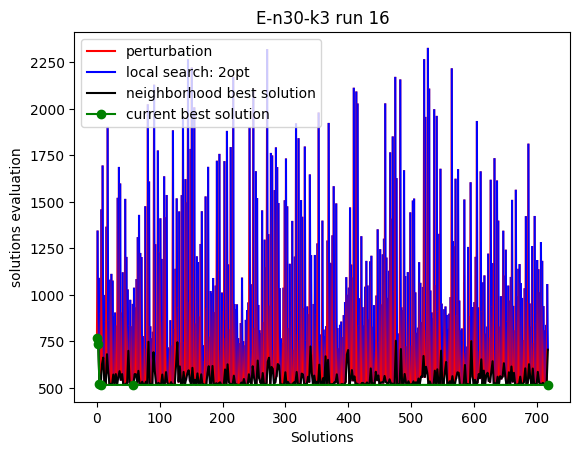

End of run 16 with best solution quality 515.6017371886334 total evaluations: 900024.5550109282


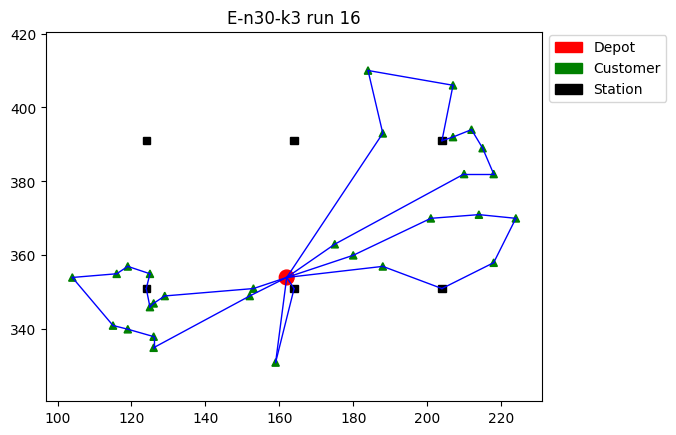

Run: 17 with random seed 17


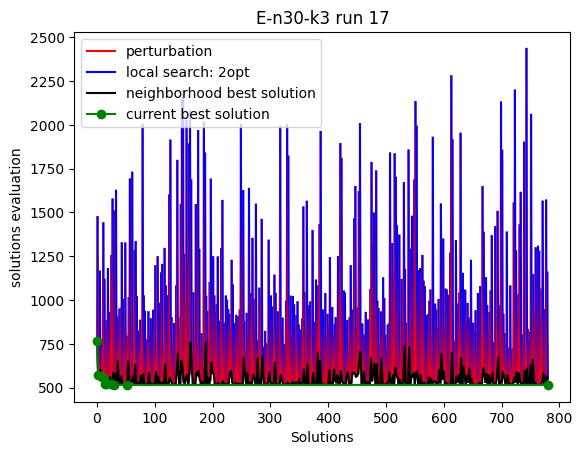

End of run 17 with best solution quality 515.6017371886334 total evaluations: 900022.7772340222


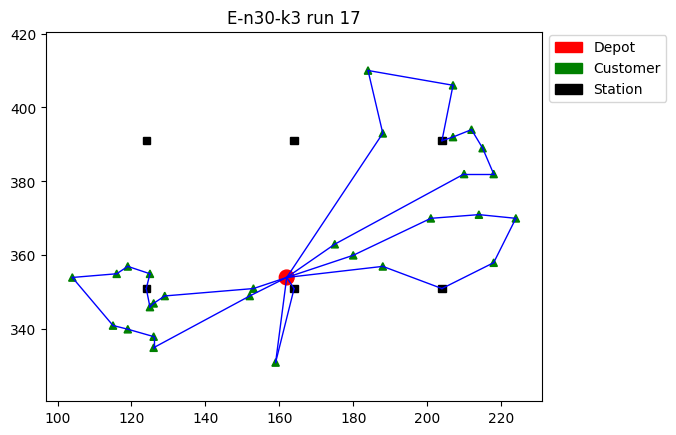

Run: 18 with random seed 18


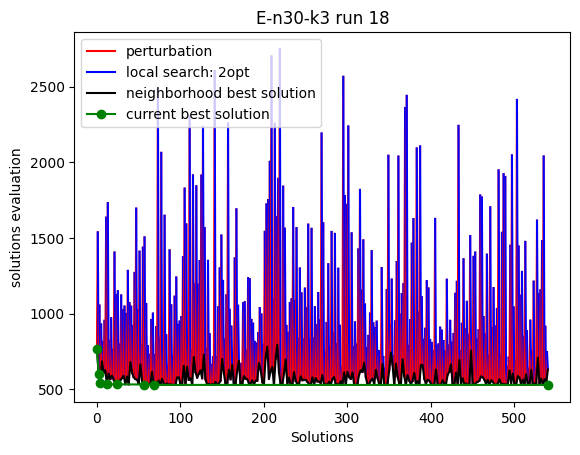

End of run 18 with best solution quality 527.6591130892524 total evaluations: 900055.8050074656


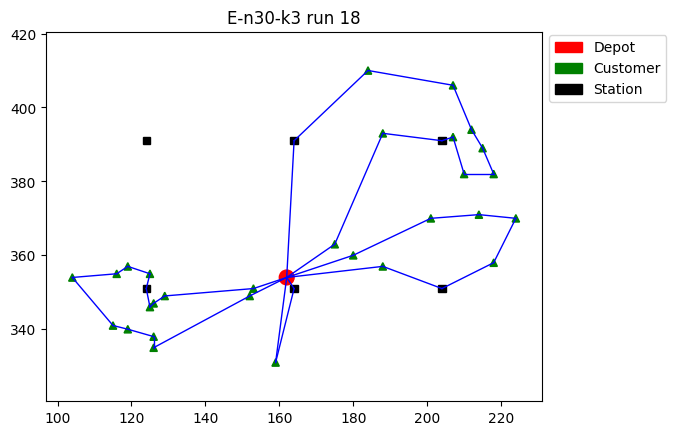

Run: 19 with random seed 19


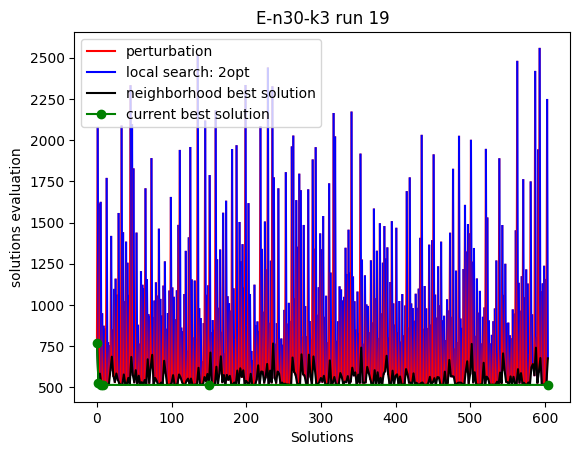

End of run 19 with best solution quality 515.6017371886334 total evaluations: 900149.3327860272


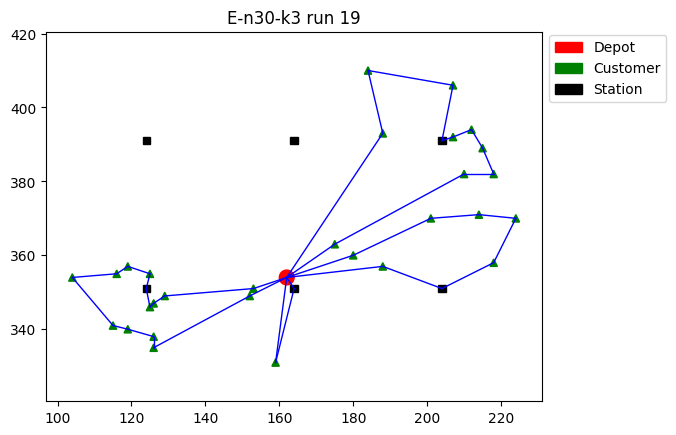

Run: 20 with random seed 20


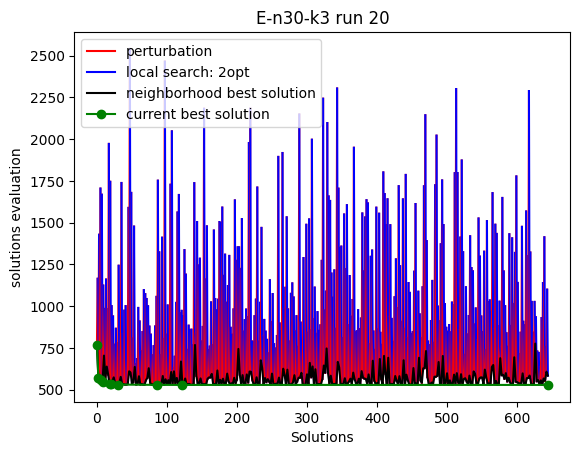

End of run 20 with best solution quality 527.6591130892525 total evaluations: 900020.3605640728


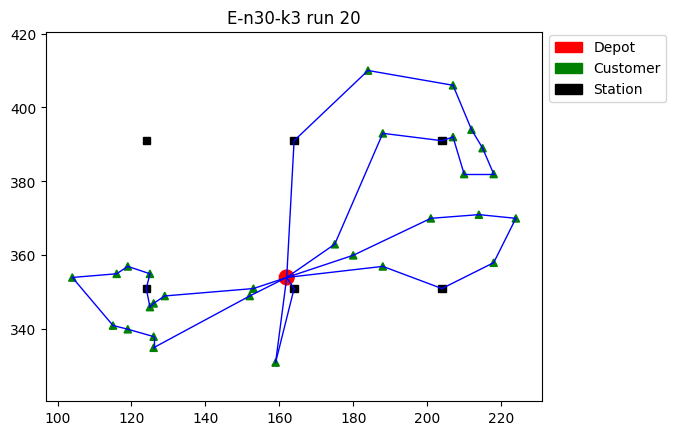

3 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n33-k4.evrp
========= E-n33-k4.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n33-k4.evrp.txt
Run: 1 with random seed 1


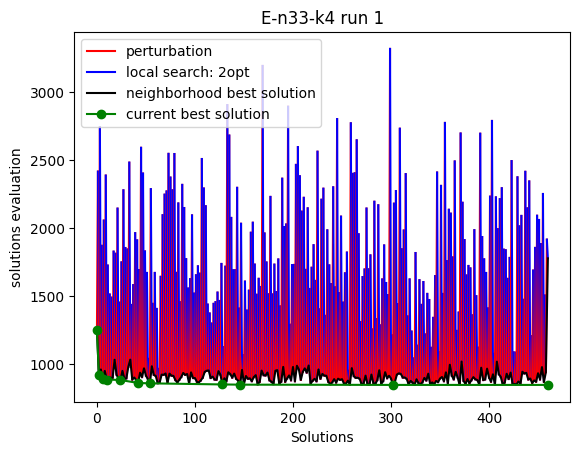

End of run 1 with best solution quality 846.6164859098166 total evaluations: 975149.897102874


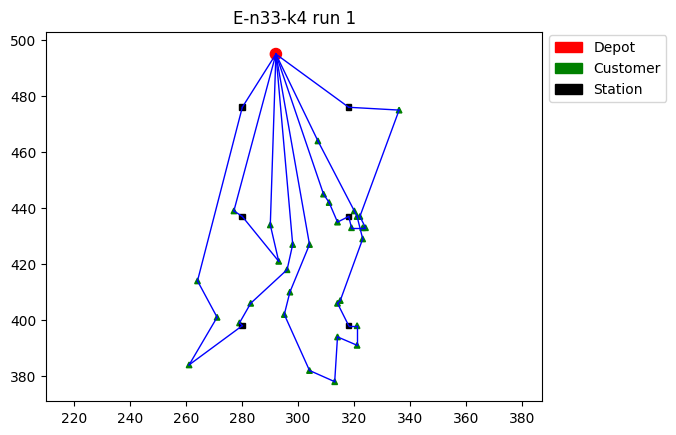

Run: 2 with random seed 2


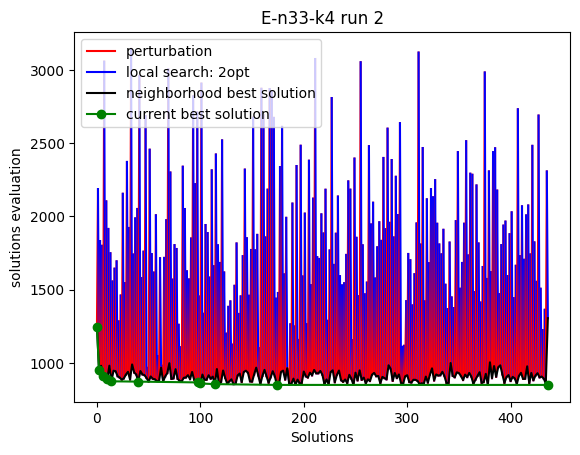

End of run 2 with best solution quality 849.936007971277 total evaluations: 975014.1535132194


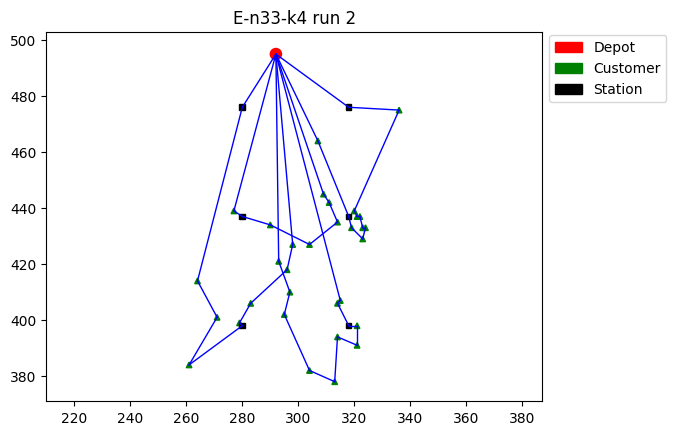

Run: 3 with random seed 3


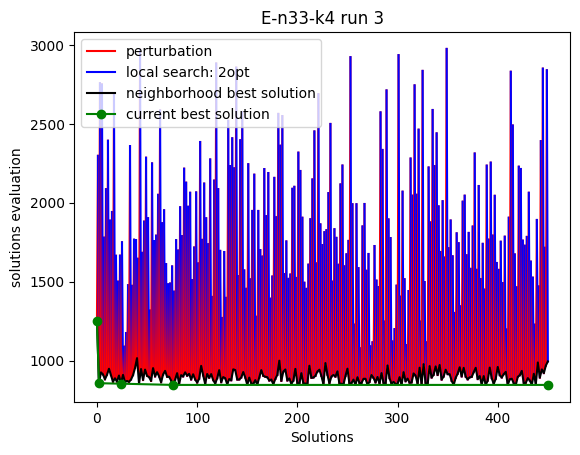

End of run 3 with best solution quality 845.469450628722 total evaluations: 975057.5381286681


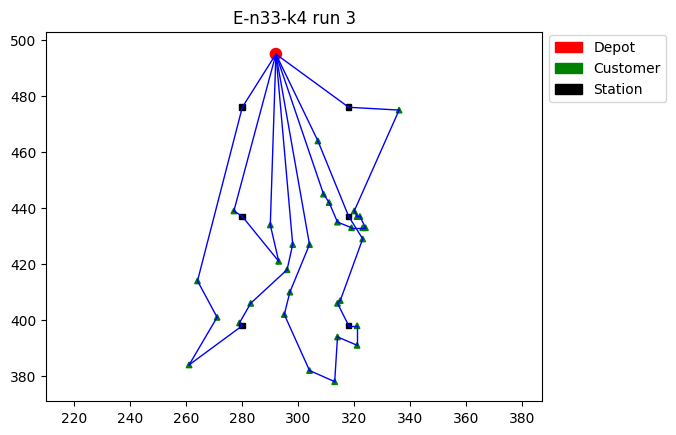

Run: 4 with random seed 4


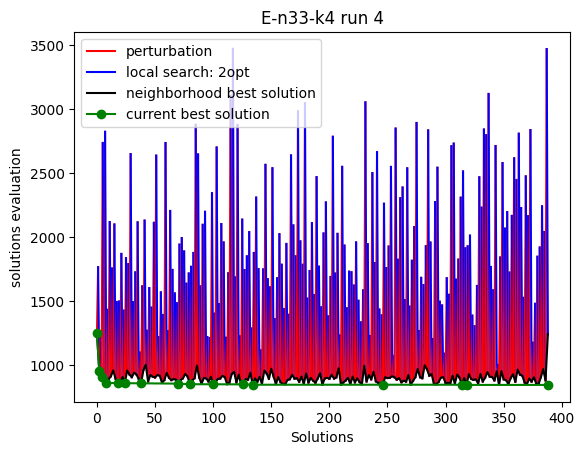

End of run 4 with best solution quality 846.9987682835801 total evaluations: 975106.1535120275


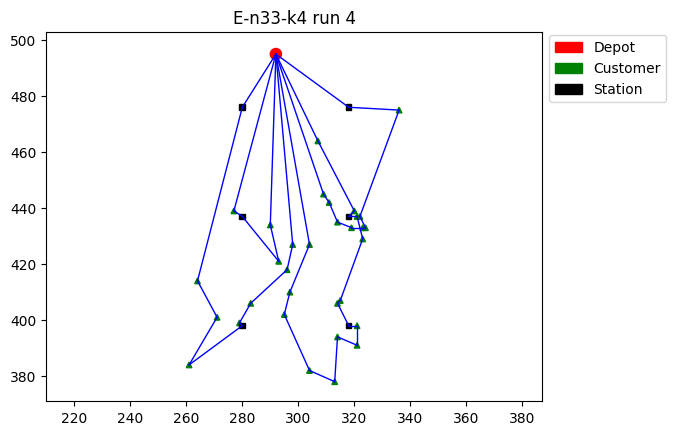

Run: 5 with random seed 5


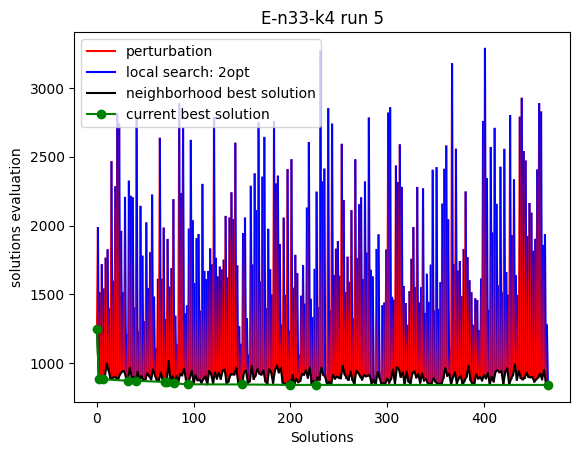

End of run 5 with best solution quality 843.1472399023914 total evaluations: 975012.8971032918


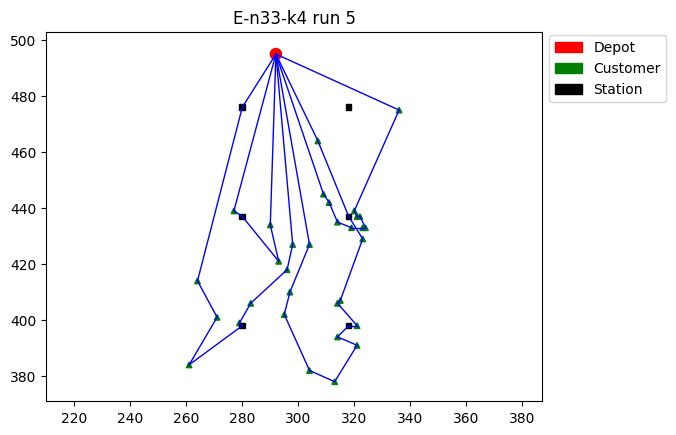

Run: 6 with random seed 6


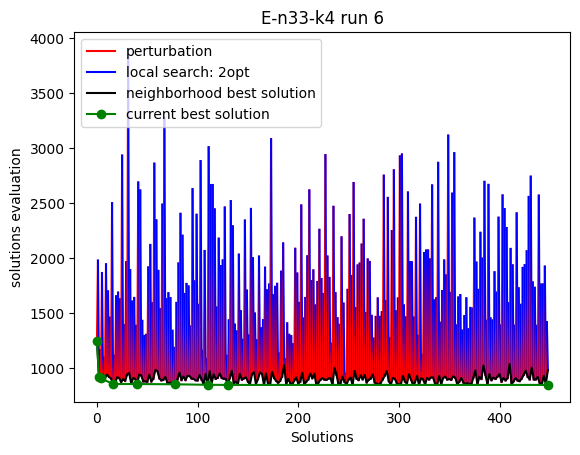

End of run 6 with best solution quality 845.469450628722 total evaluations: 975064.0509488363


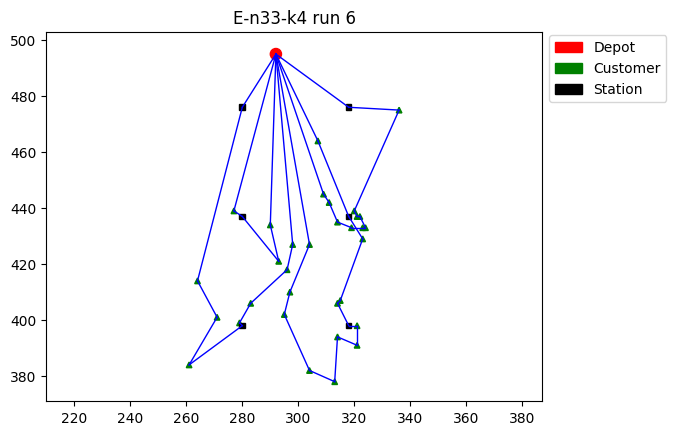

Run: 7 with random seed 7


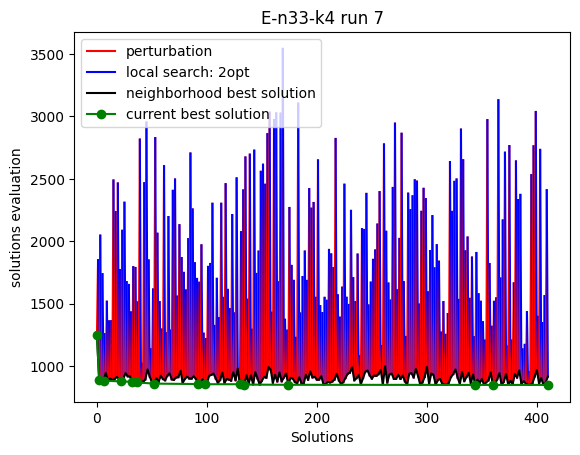

End of run 7 with best solution quality 849.1313637564798 total evaluations: 975041.6406914699


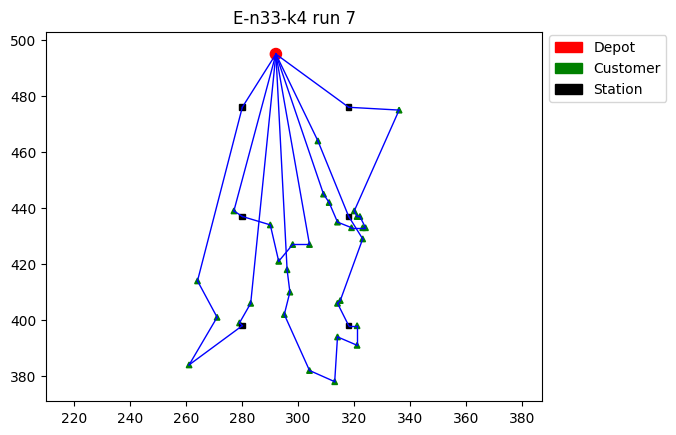

Run: 8 with random seed 8


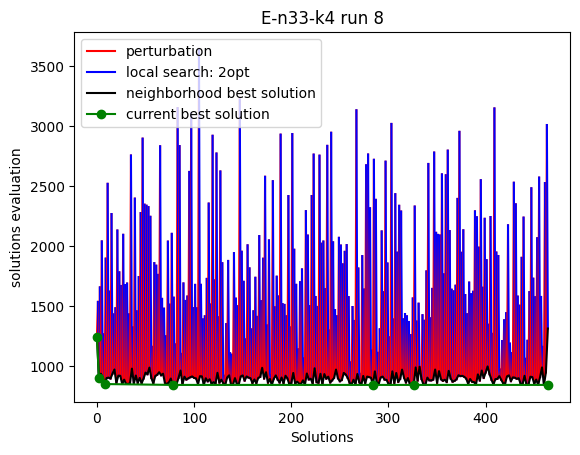

End of run 8 with best solution quality 846.282710768667 total evaluations: 975041.8714624332


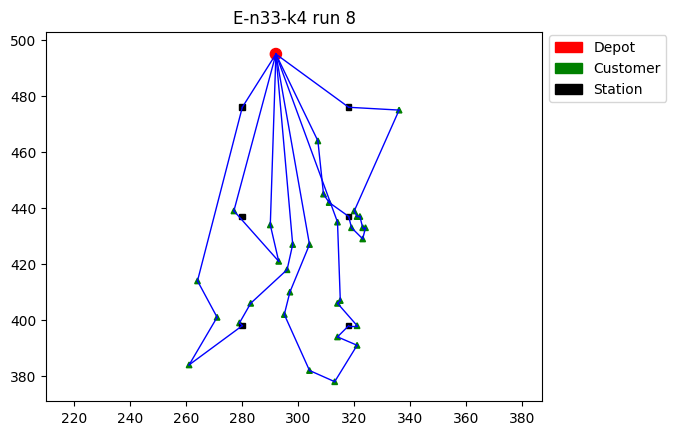

Run: 9 with random seed 9


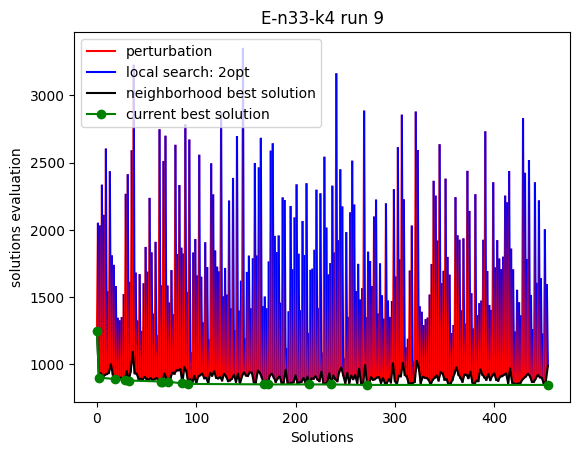

End of run 9 with best solution quality 846.8447548818143 total evaluations: 975066.8201796289


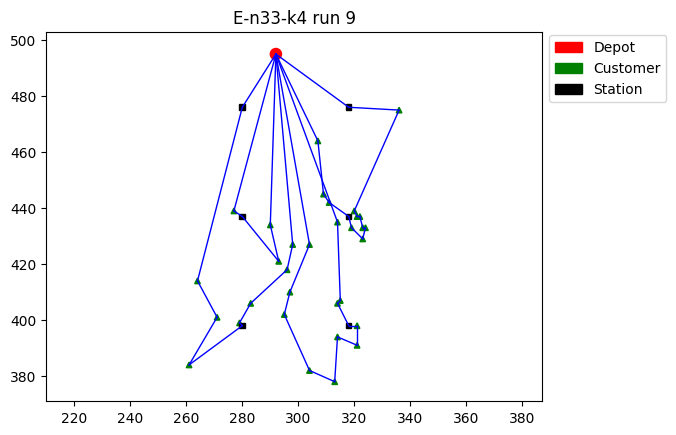

Run: 10 with random seed 10


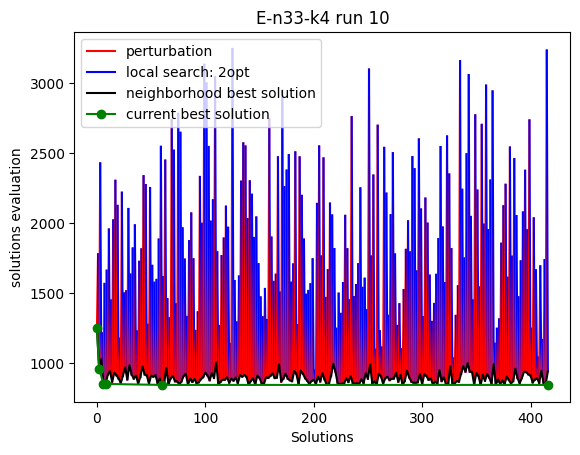

End of run 10 with best solution quality 845.469450628722 total evaluations: 975199.5894097406


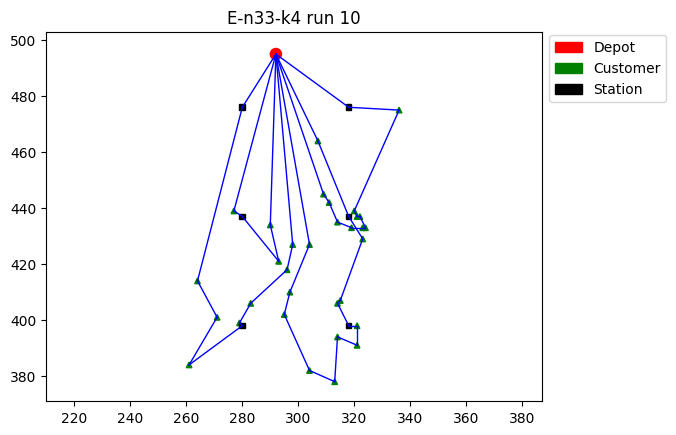

Run: 11 with random seed 11


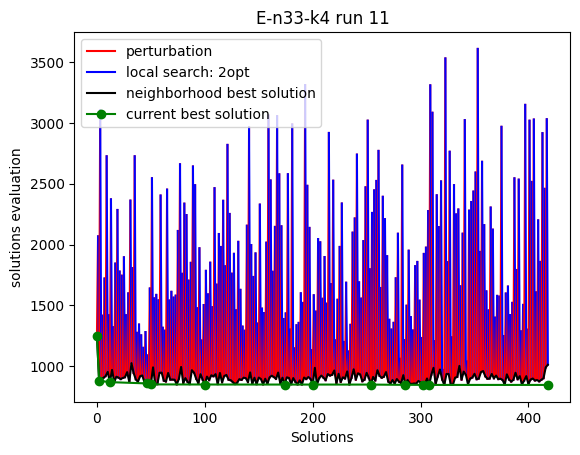

End of run 11 with best solution quality 845.469450628722 total evaluations: 975107.3842815476


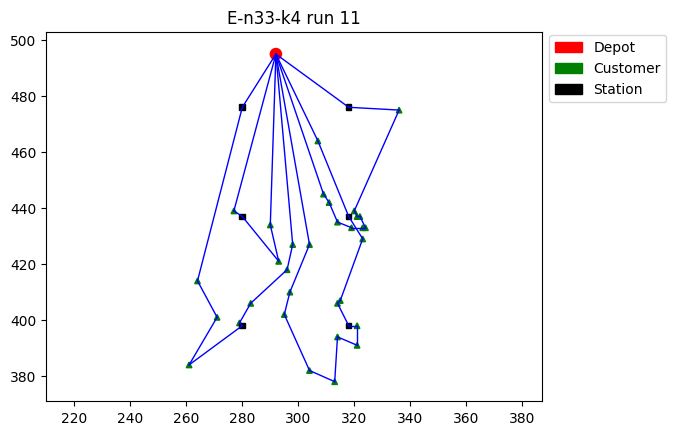

Run: 12 with random seed 12


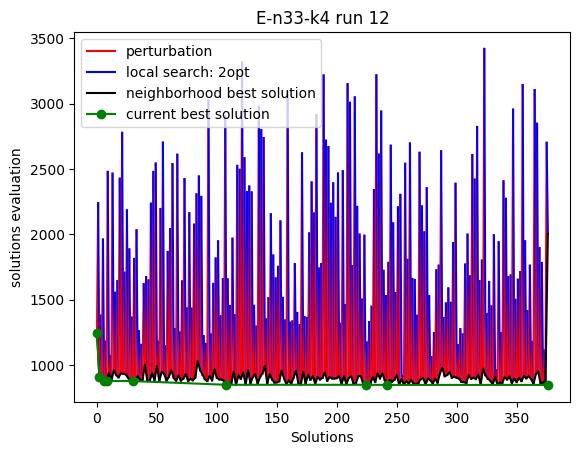

End of run 12 with best solution quality 849.2070257635716 total evaluations: 975025.4099215949


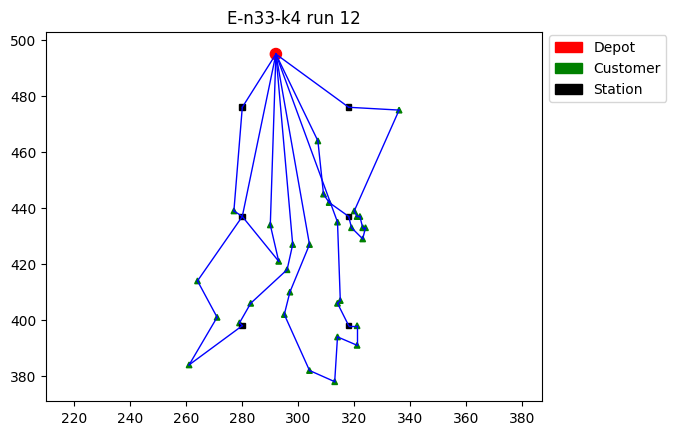

Run: 13 with random seed 13


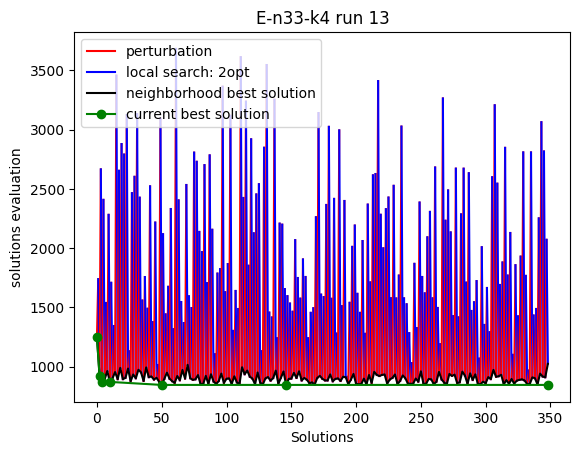

End of run 13 with best solution quality 846.6164859098163 total evaluations: 975124.6150504311


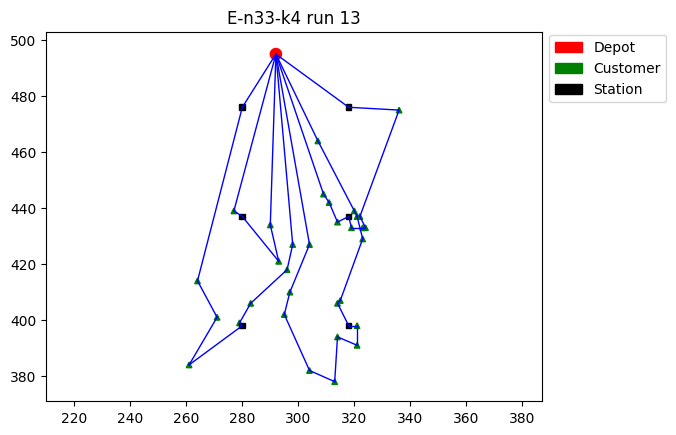

Run: 14 with random seed 14


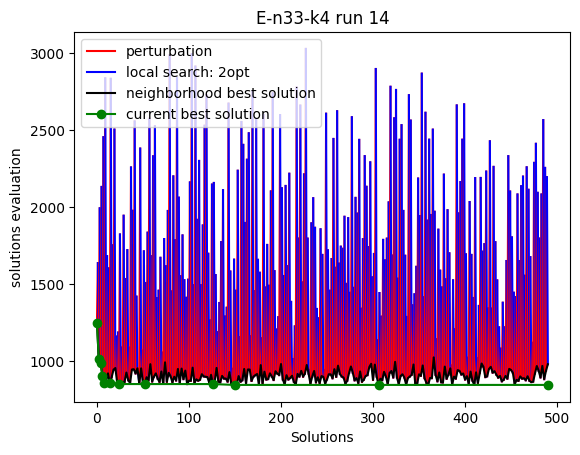

End of run 14 with best solution quality 844.5225441554838 total evaluations: 975013.4612065749


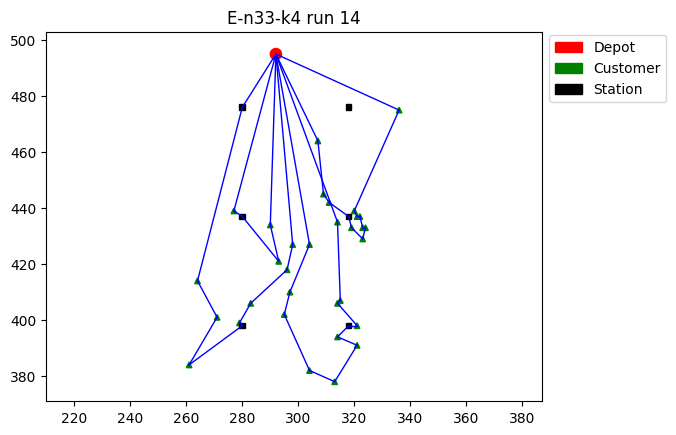

Run: 15 with random seed 15


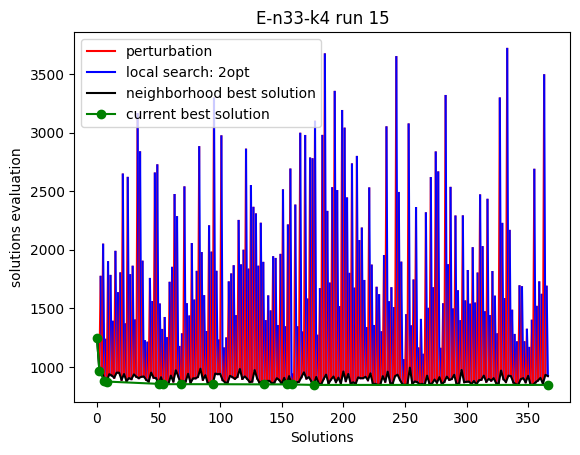

End of run 15 with best solution quality 845.469450628722 total evaluations: 975030.204793131


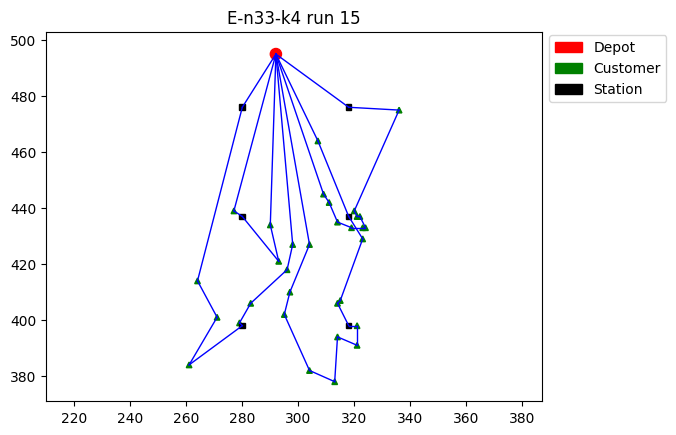

Run: 16 with random seed 16


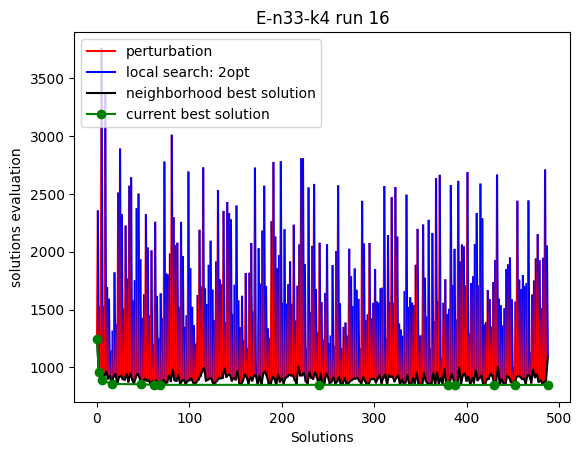

End of run 16 with best solution quality 848.5745496057094 total evaluations: 975028.6150524489


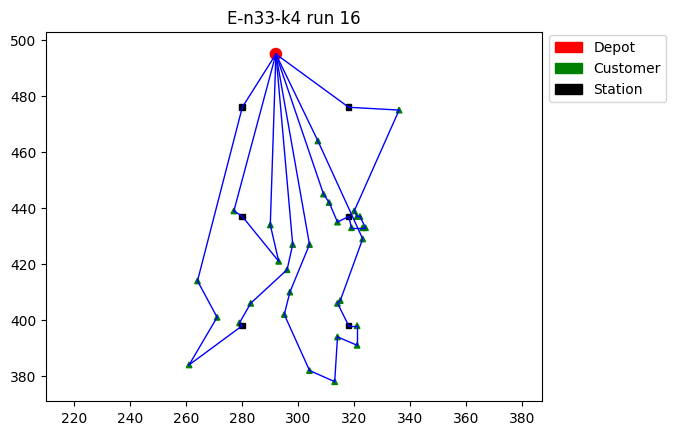

Run: 17 with random seed 17


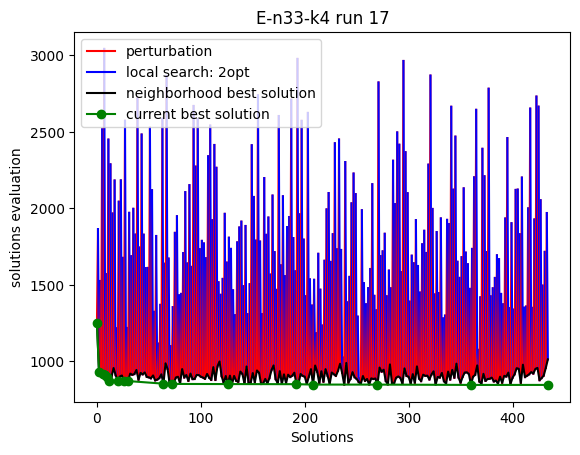

End of run 17 with best solution quality 846.8447548818144 total evaluations: 975072.5637691198


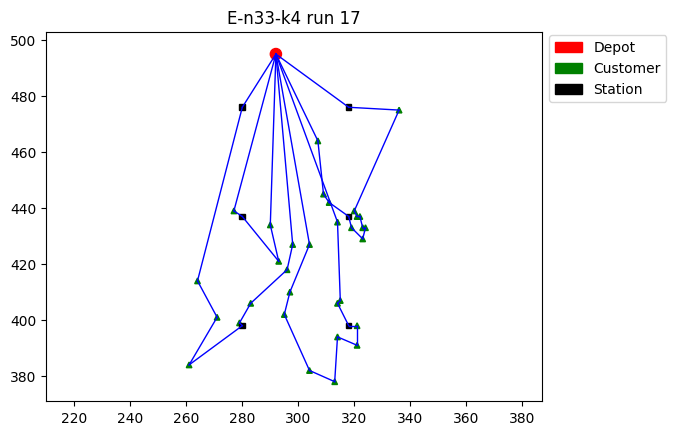

Run: 18 with random seed 18


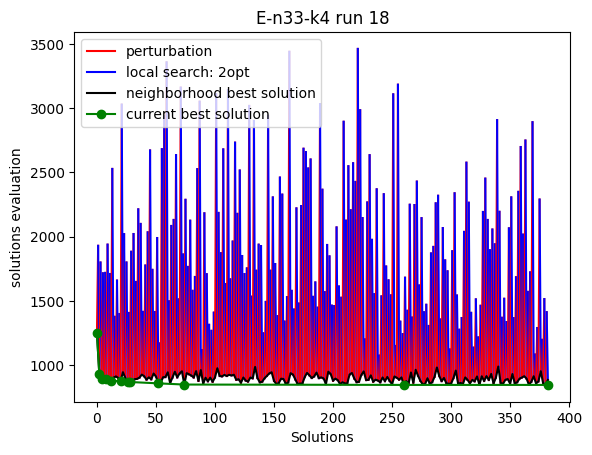

End of run 18 with best solution quality 846.8447548818145 total evaluations: 975014.153512495


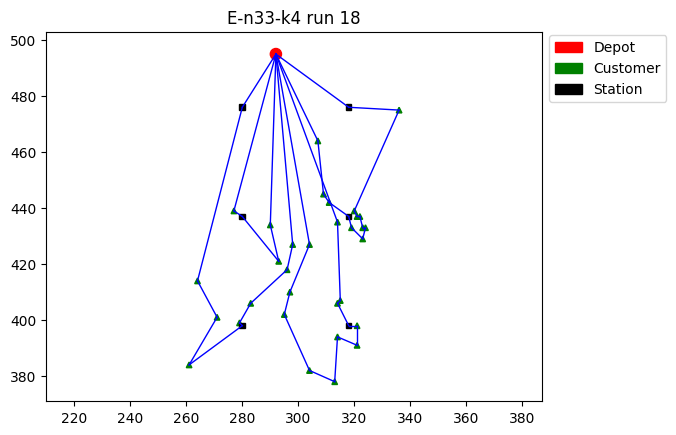

Run: 19 with random seed 19


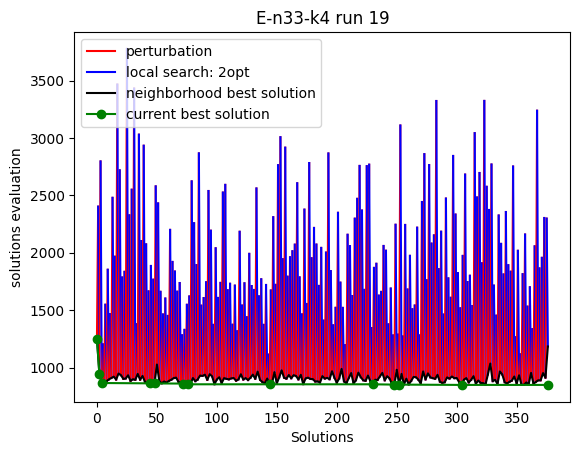

End of run 19 with best solution quality 848.260632492269 total evaluations: 975034.6663330747


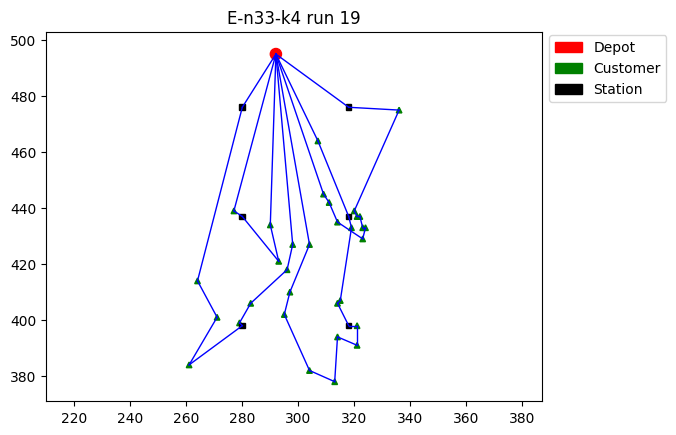

Run: 20 with random seed 20


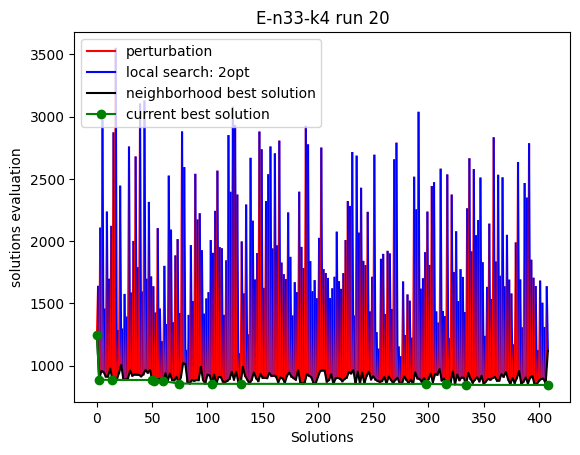

End of run 20 with best solution quality 845.0452967615425 total evaluations: 975033.8458201939


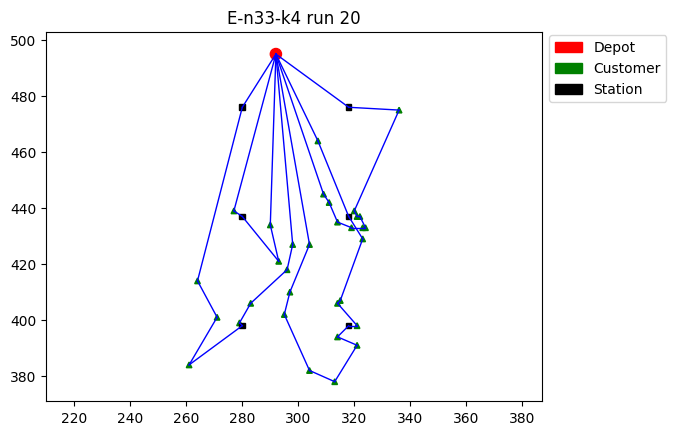

4 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n51-k5.evrp
========= E-n51-k5.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n51-k5.evrp.txt
Run: 1 with random seed 1


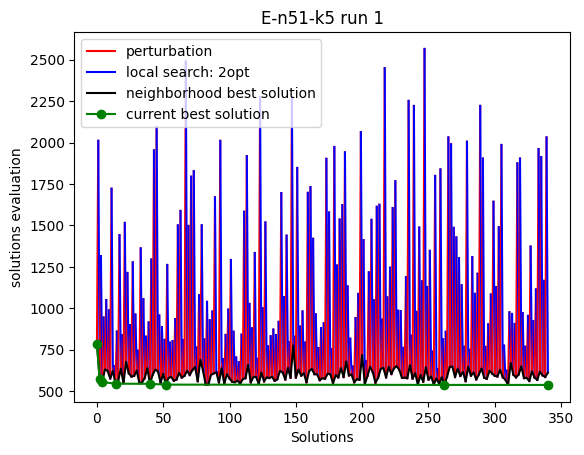

End of run 1 with best solution quality 537.849148986853 total evaluations: 1500086.1332631132


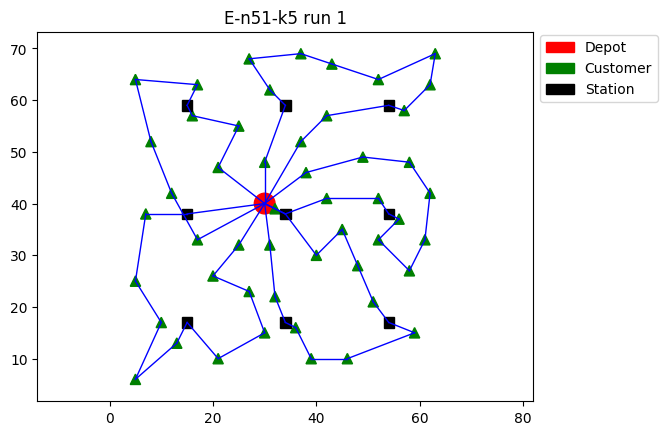

Run: 2 with random seed 2


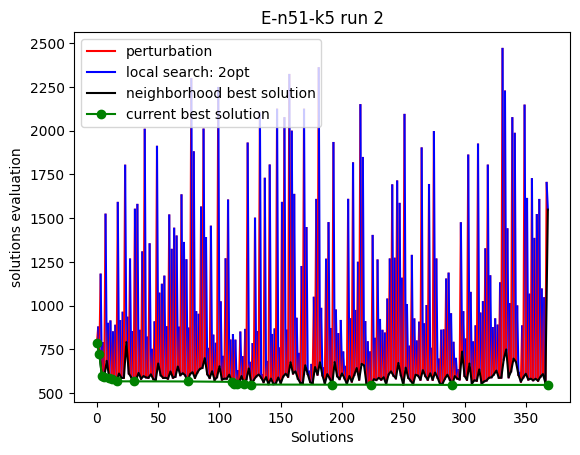

End of run 2 with best solution quality 546.830097060086 total evaluations: 1500024.449931278


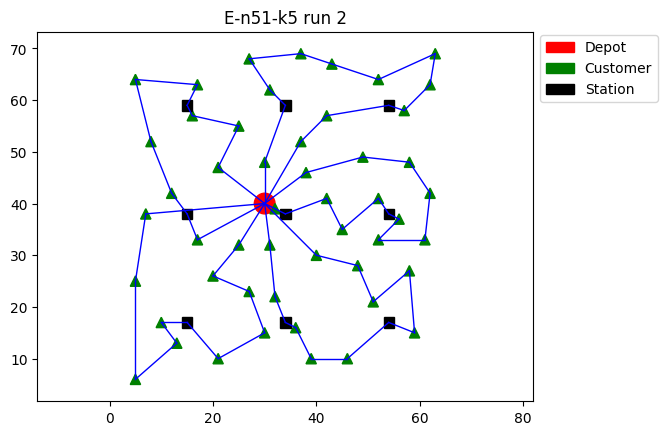

Run: 3 with random seed 3


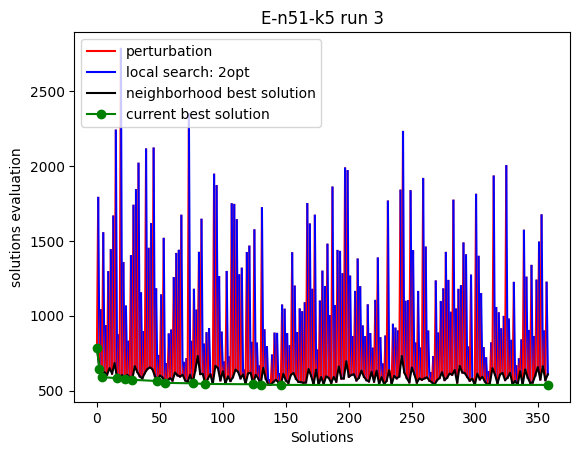

End of run 3 with best solution quality 538.3220054852836 total evaluations: 1500040.9499288122


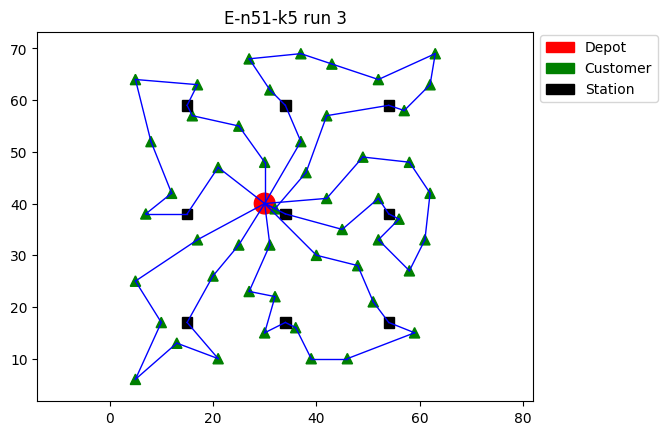

Run: 4 with random seed 4


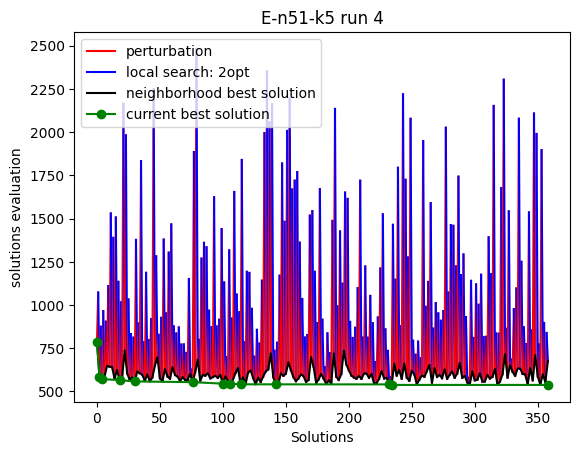

End of run 4 with best solution quality 537.6794066603616 total evaluations: 1500030.683263818


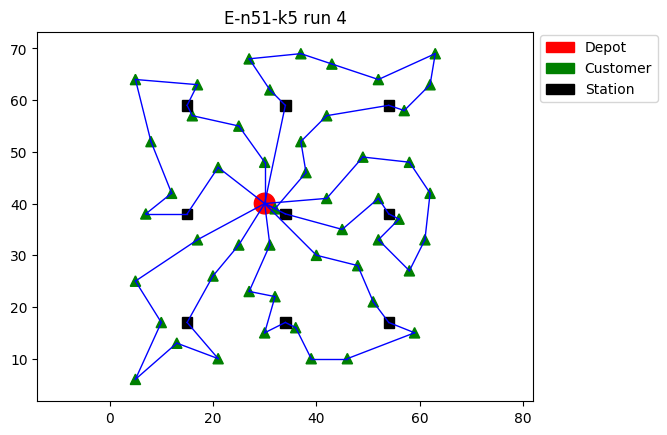

Run: 5 with random seed 5


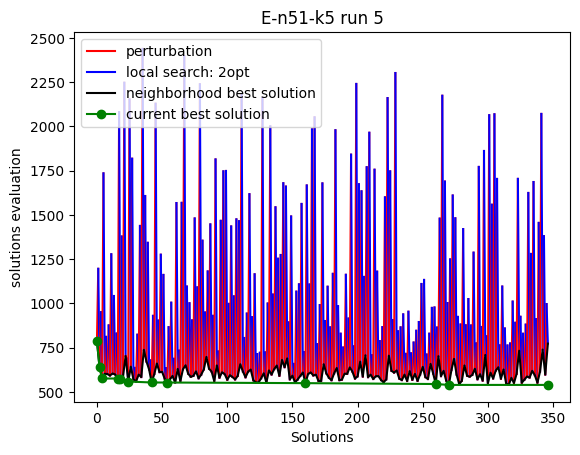

End of run 5 with best solution quality 539.876429333597 total evaluations: 1500018.9832603044


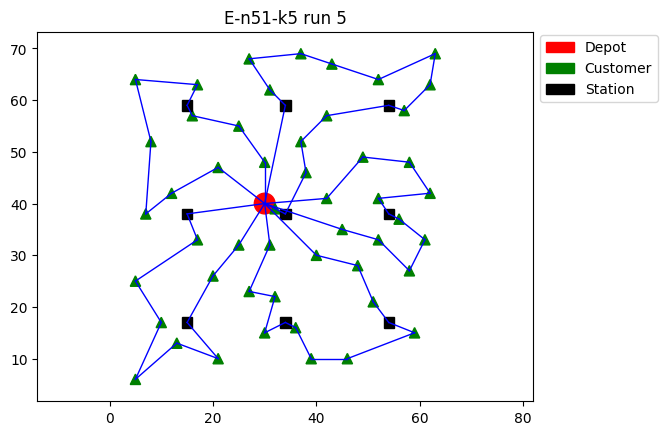

Run: 6 with random seed 6


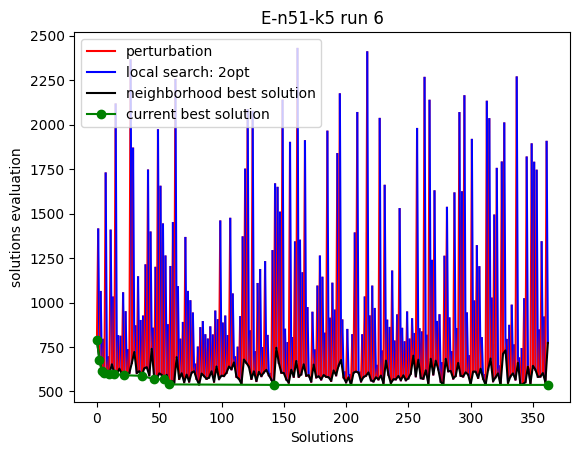

End of run 6 with best solution quality 536.9181853422845 total evaluations: 1500053.98326364


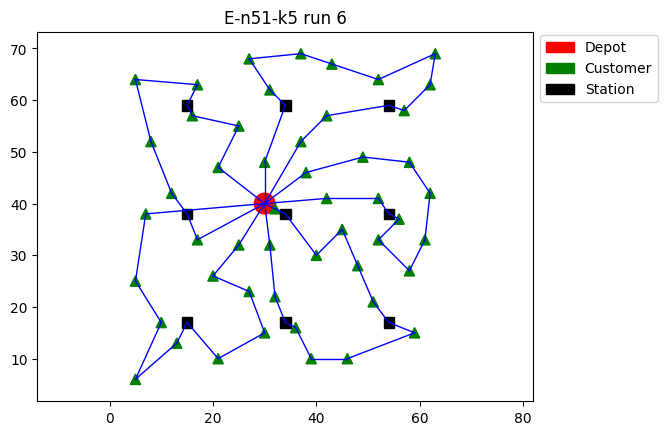

Run: 7 with random seed 7


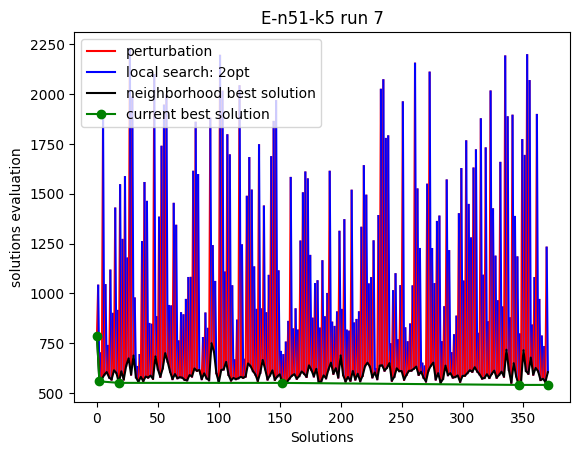

End of run 7 with best solution quality 539.795875495804 total evaluations: 1500226.3165948968


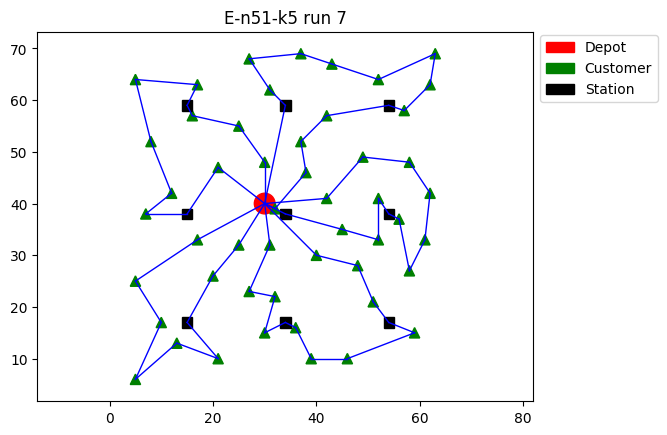

Run: 8 with random seed 8


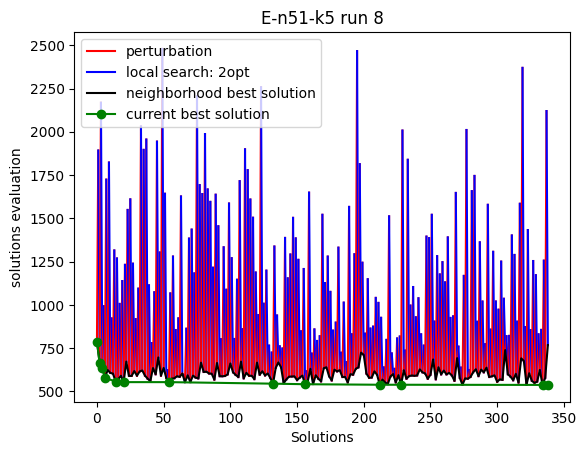

End of run 8 with best solution quality 536.9181853422847 total evaluations: 1500039.1499264238


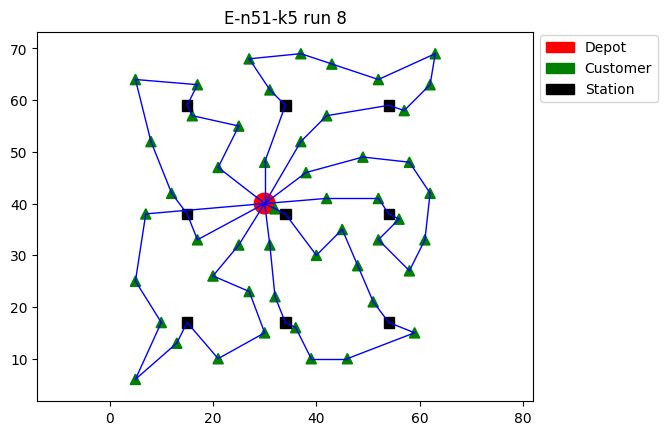

Run: 9 with random seed 9


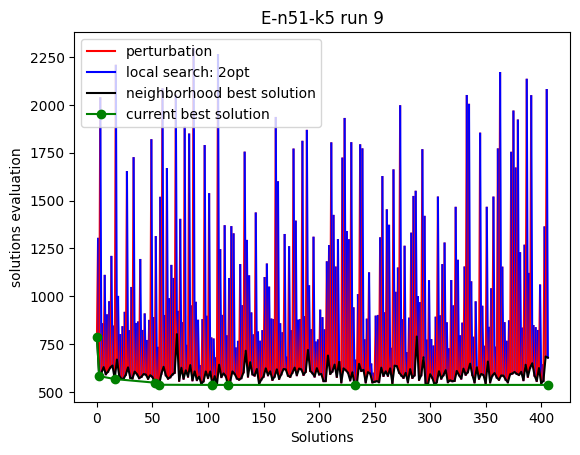

End of run 9 with best solution quality 536.9181853422846 total evaluations: 1500130.1832607936


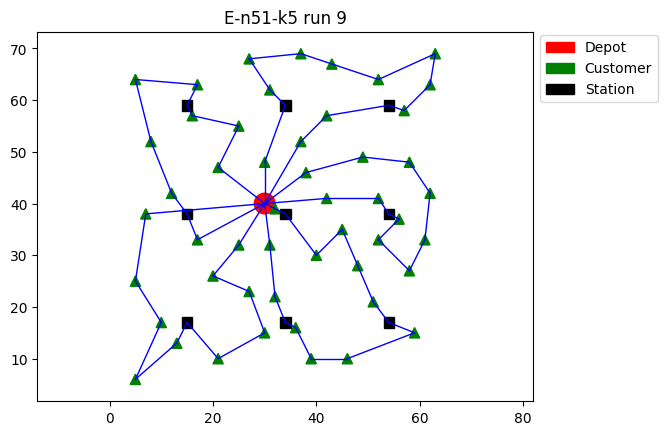

Run: 10 with random seed 10


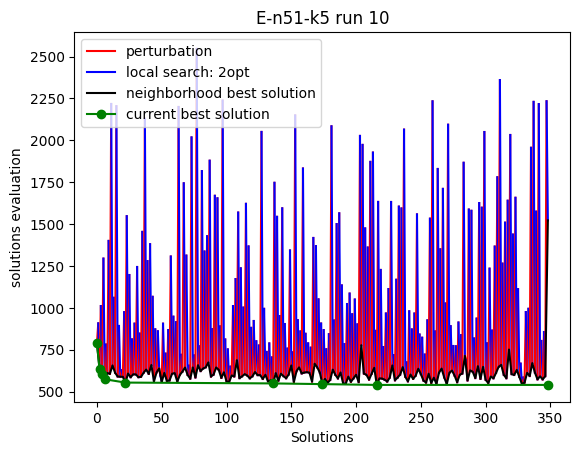

End of run 10 with best solution quality 539.7181397910255 total evaluations: 1500011.749926345


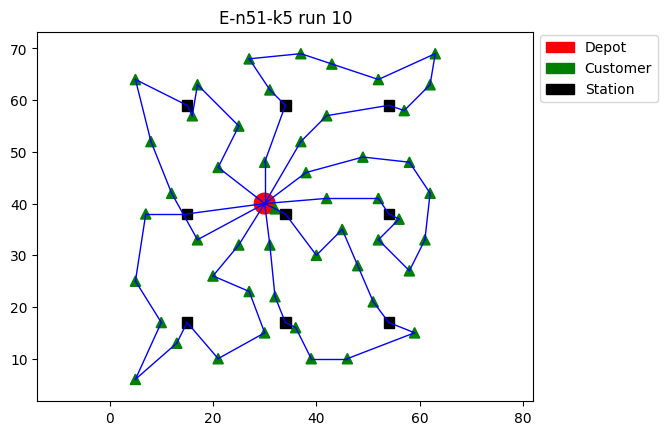

Run: 11 with random seed 11


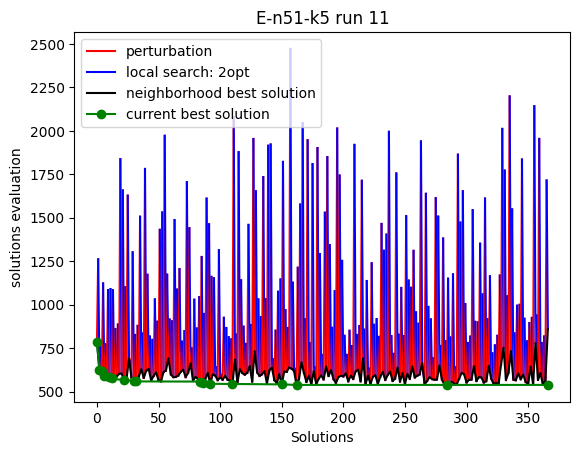

End of run 11 with best solution quality 538.5895039114031 total evaluations: 1500030.5499306833


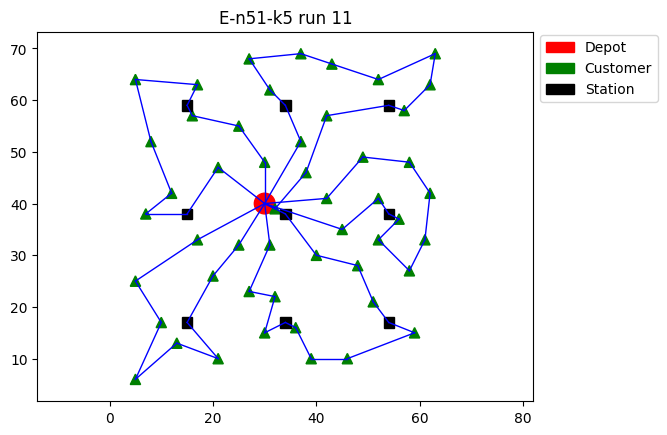

Run: 12 with random seed 12


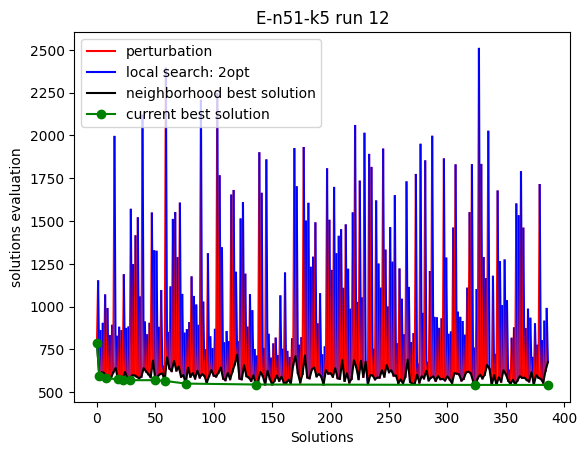

End of run 12 with best solution quality 542.4468478487865 total evaluations: 1500035.2832604635


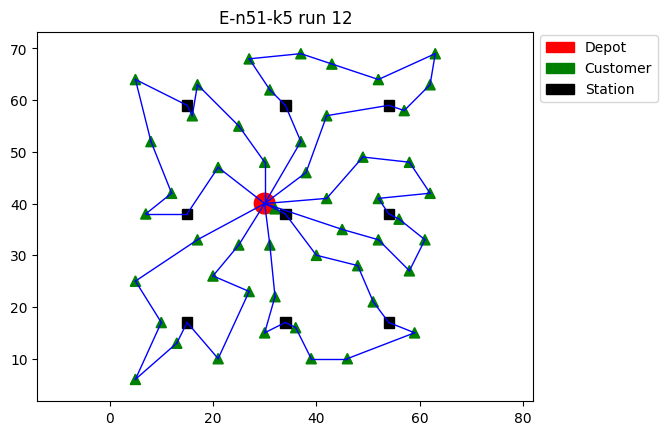

Run: 13 with random seed 13


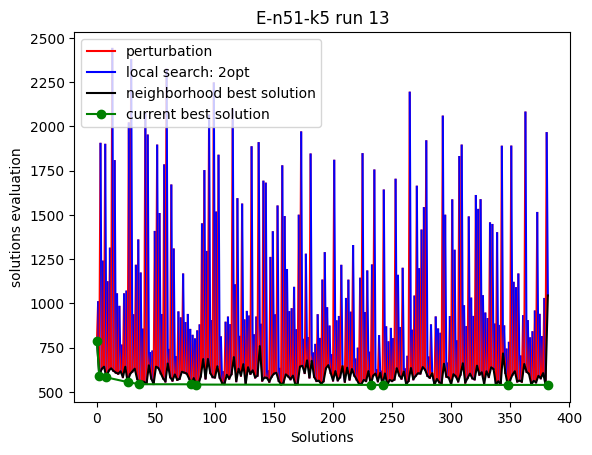

End of run 13 with best solution quality 539.7958754958038 total evaluations: 1500011.7832593813


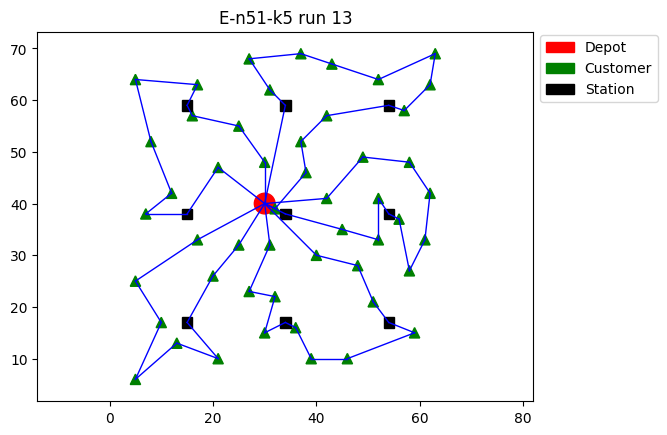

Run: 14 with random seed 14


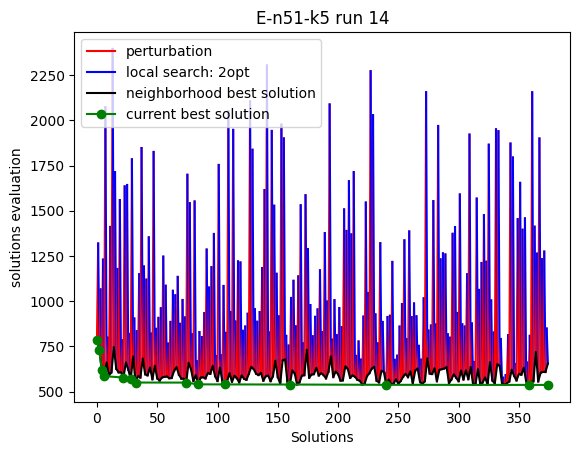

End of run 14 with best solution quality 537.228053564209 total evaluations: 1500146.2165939368


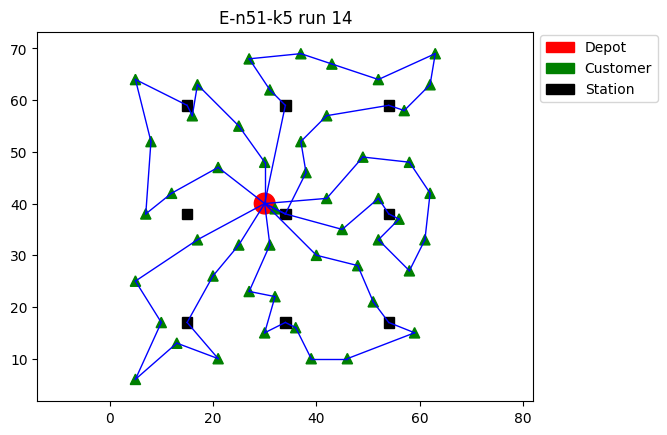

Run: 15 with random seed 15


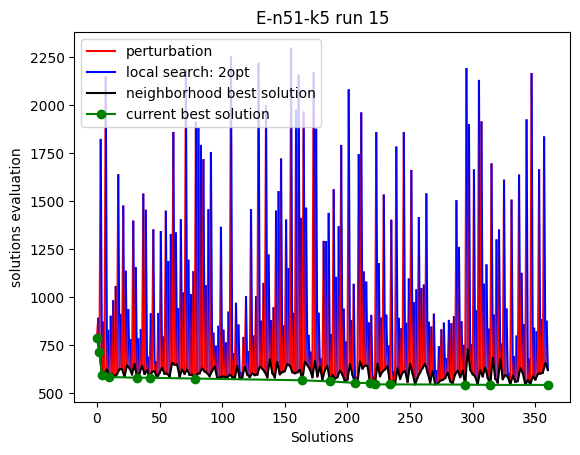

End of run 15 with best solution quality 541.0478017596006 total evaluations: 1500039.9832670393


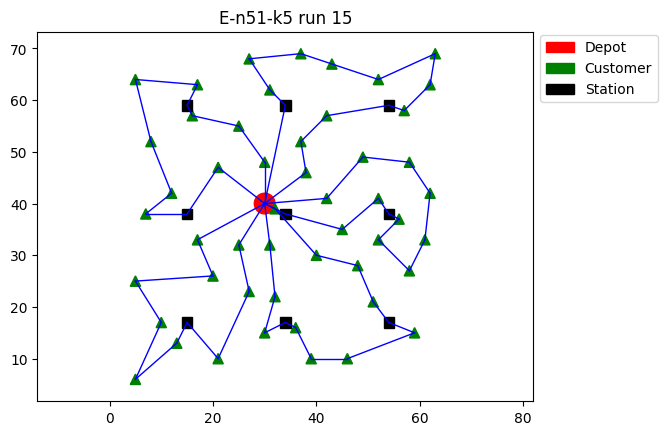

Run: 16 with random seed 16


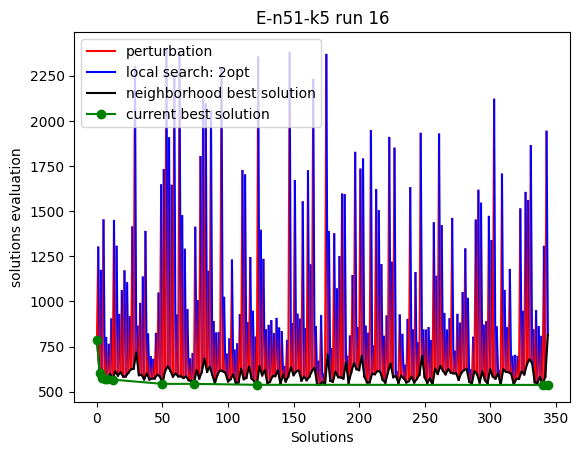

End of run 16 with best solution quality 537.4807325632729 total evaluations: 1500069.5165940665


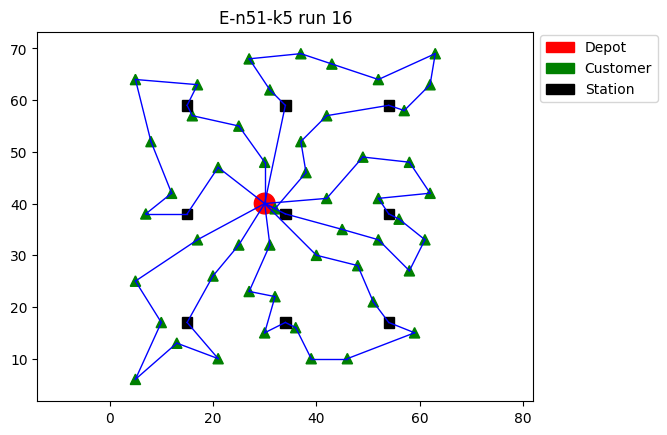

Run: 17 with random seed 17


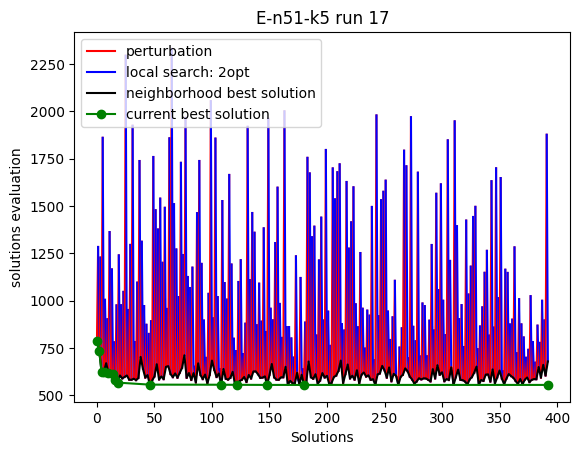

End of run 17 with best solution quality 555.0045461838004 total evaluations: 1500050.8832623227


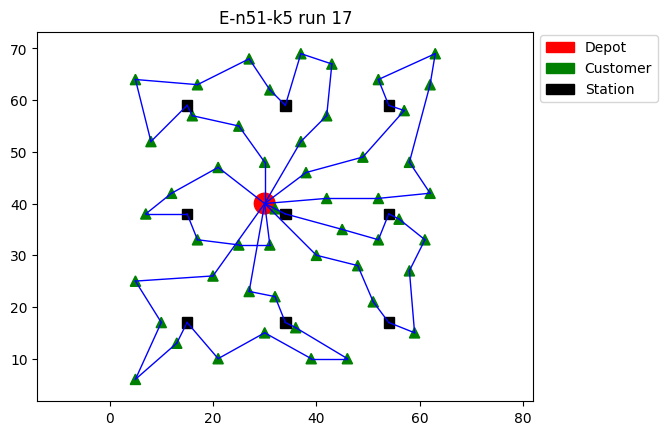

Run: 18 with random seed 18


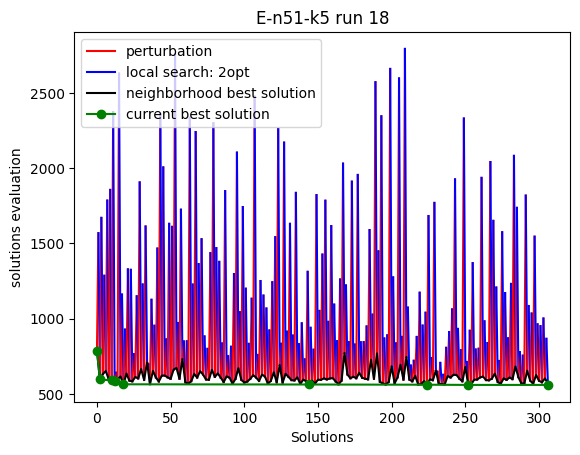

End of run 18 with best solution quality 559.3901793263093 total evaluations: 1500122.3999298385


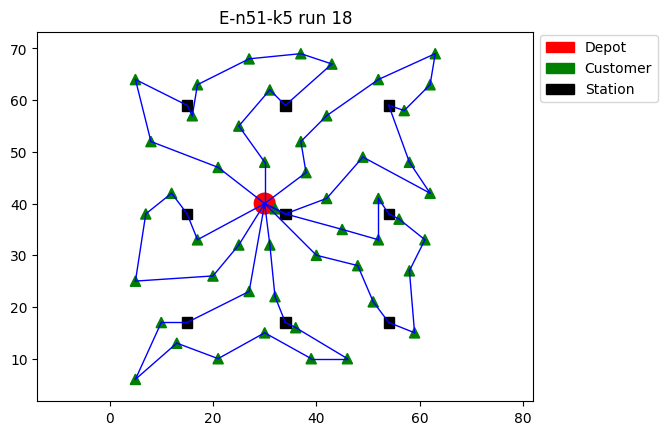

Run: 19 with random seed 19


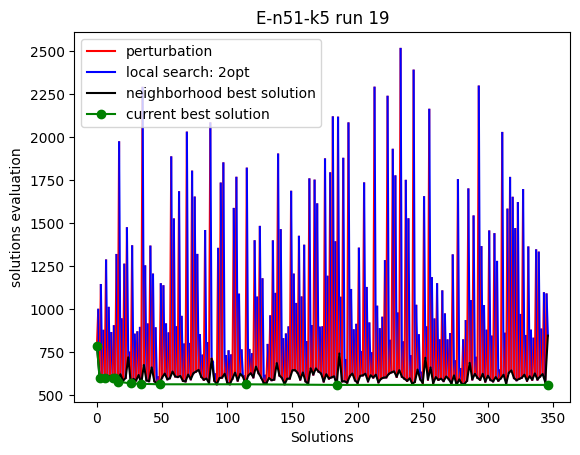

End of run 19 with best solution quality 559.038870863857 total evaluations: 1500016.149930081


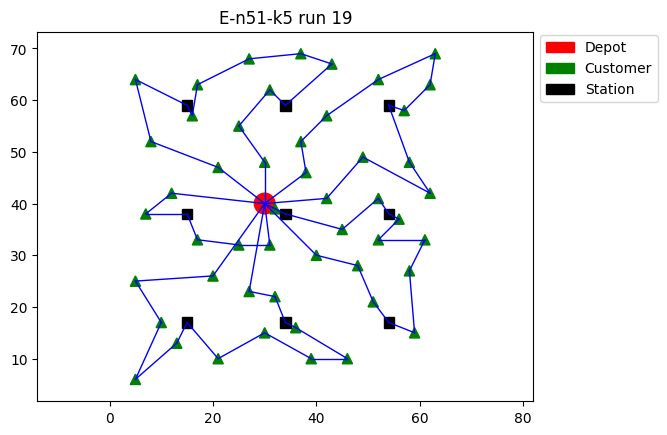

Run: 20 with random seed 20


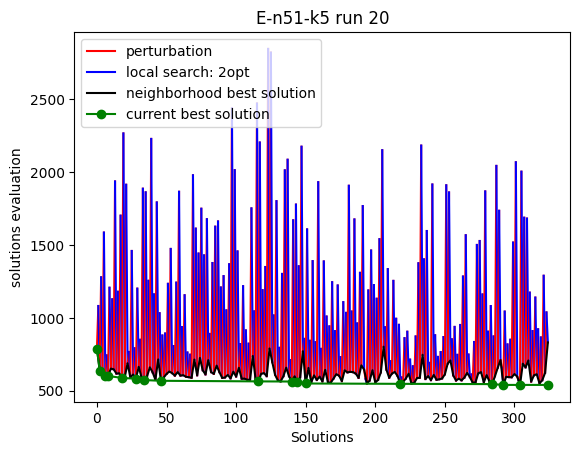

End of run 20 with best solution quality 539.7617212679818 total evaluations: 1500017.8832666778


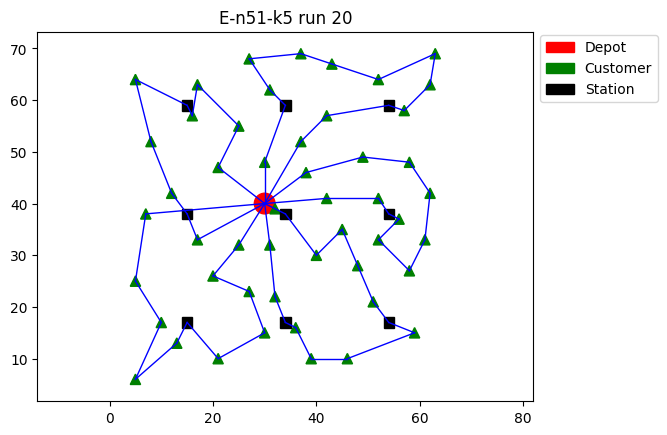

5 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n76-k7.evrp
========= E-n76-k7.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n76-k7.evrp.txt
Run: 1 with random seed 1


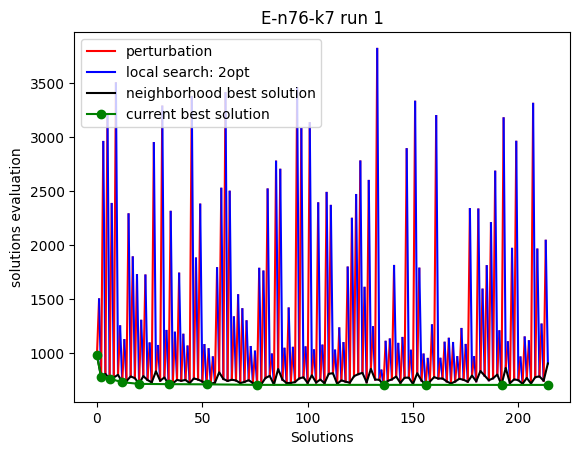

End of run 1 with best solution quality 707.2008609022661 total evaluations: 2125154.4471278144


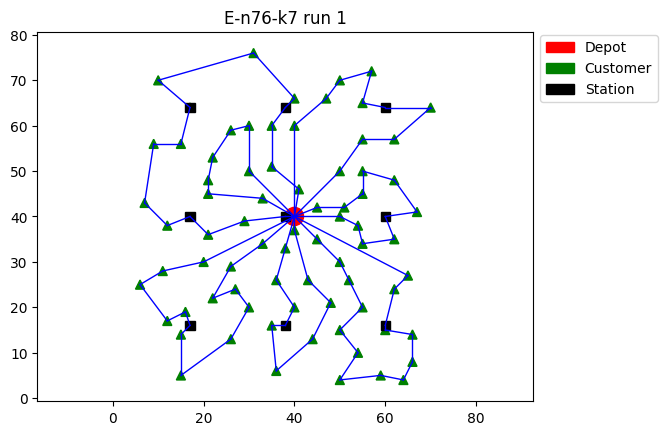

Run: 2 with random seed 2


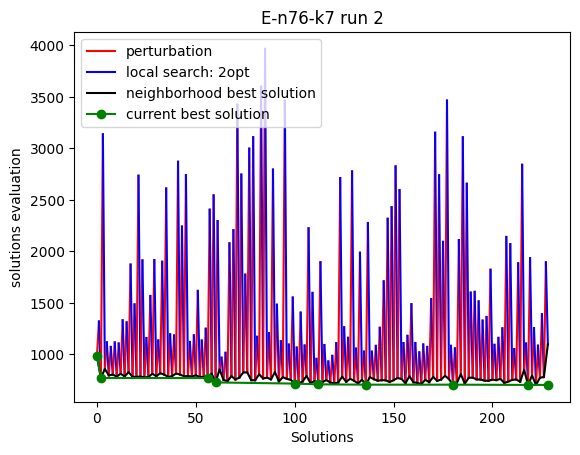

End of run 2 with best solution quality 702.9681219404425 total evaluations: 2125131.694181123


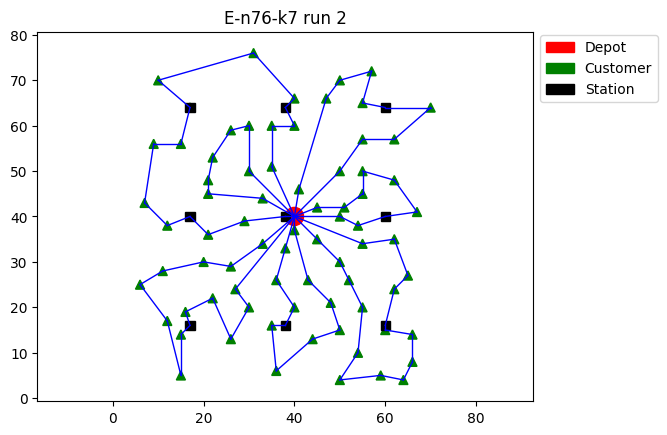

Run: 3 with random seed 3


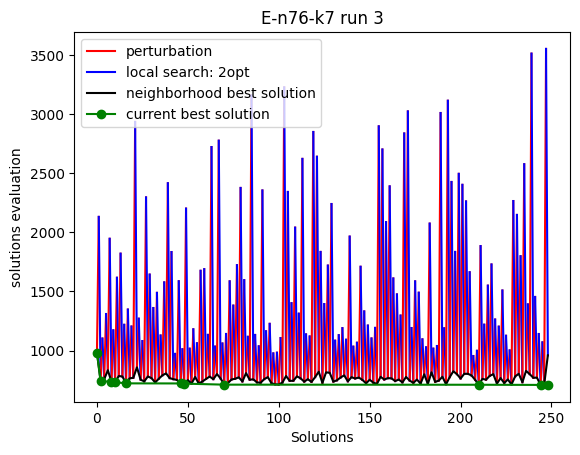

End of run 3 with best solution quality 708.6524290328975 total evaluations: 2125108.5882991203


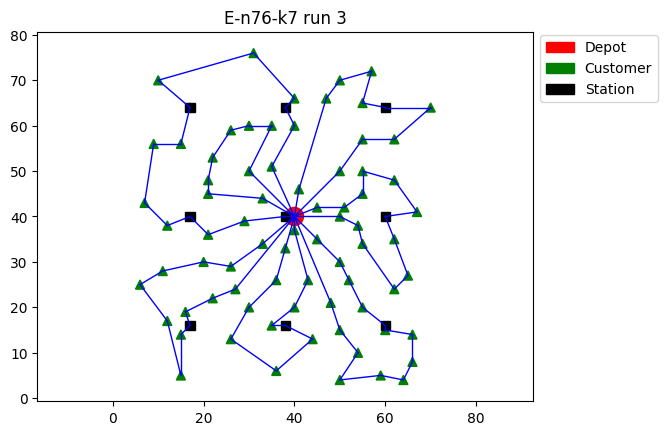

Run: 4 with random seed 4


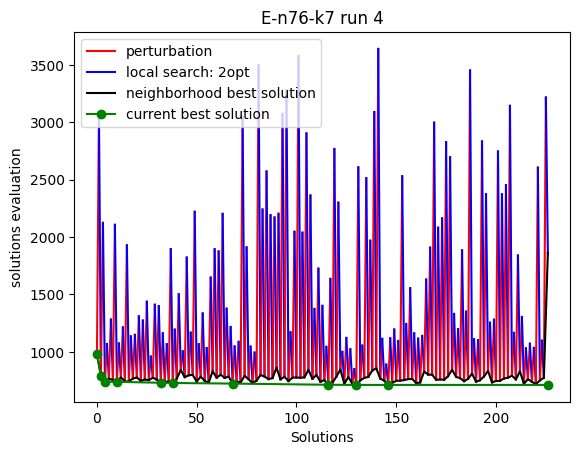

End of run 4 with best solution quality 711.3433675272038 total evaluations: 2125016.1059465953


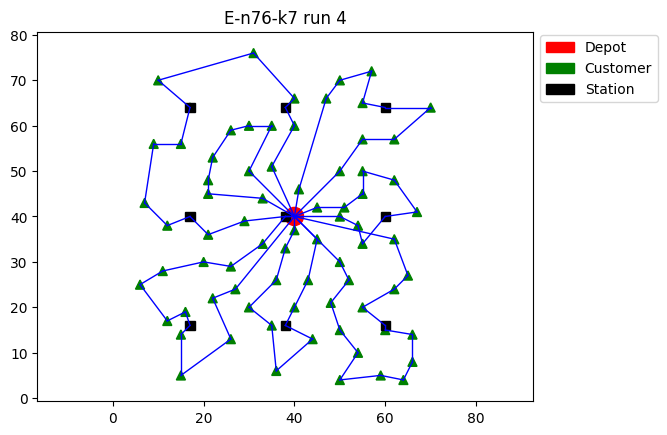

Run: 5 with random seed 5


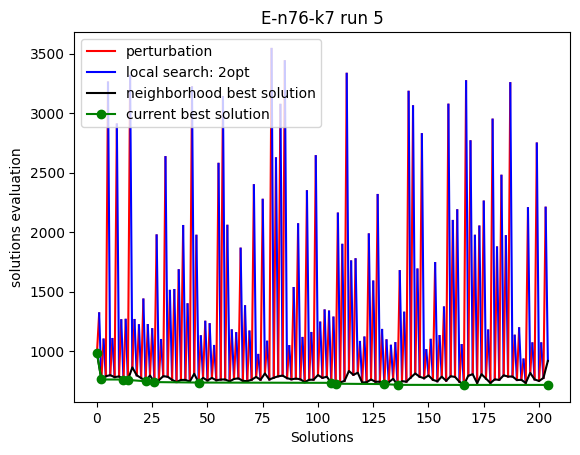

End of run 5 with best solution quality 715.1904667556092 total evaluations: 2125126.6588890566


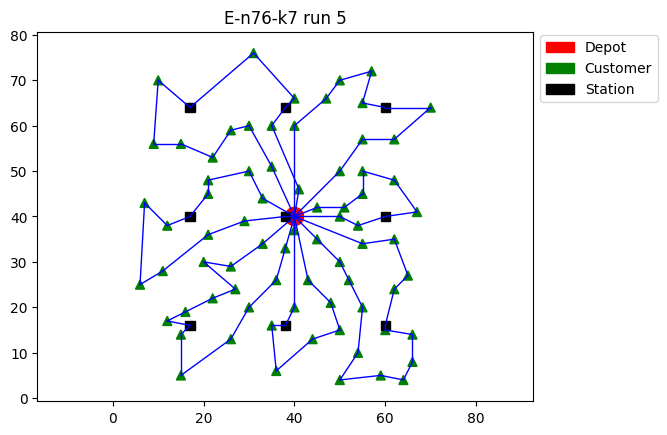

Run: 6 with random seed 6


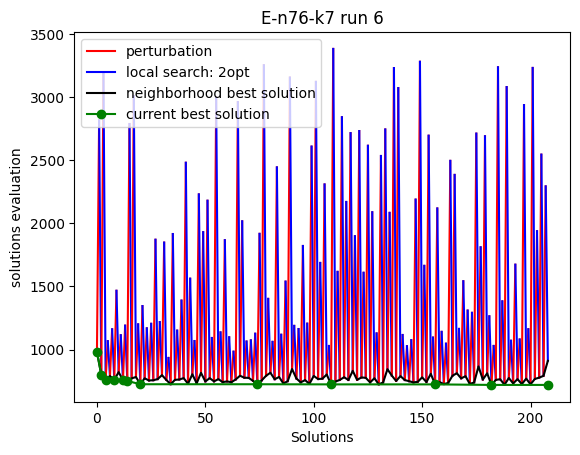

End of run 6 with best solution quality 720.0765015575471 total evaluations: 2125093.5294782445


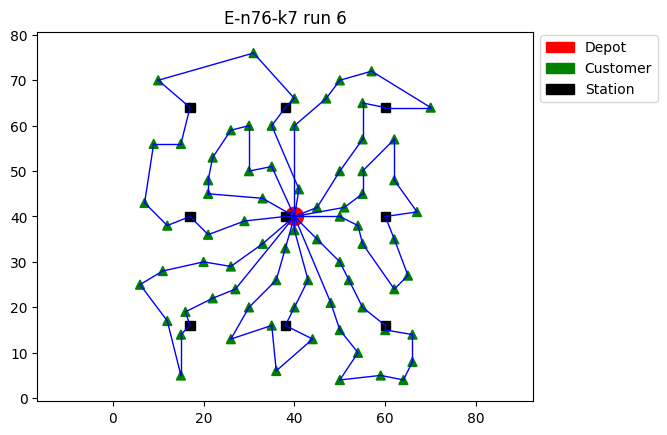

Run: 7 with random seed 7


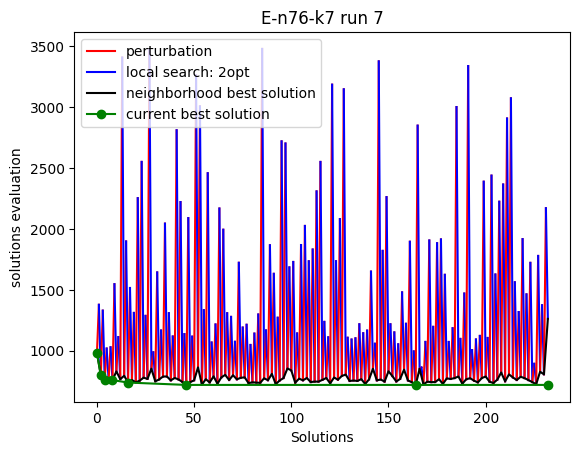

End of run 7 with best solution quality 718.9495980419817 total evaluations: 2125008.658887267


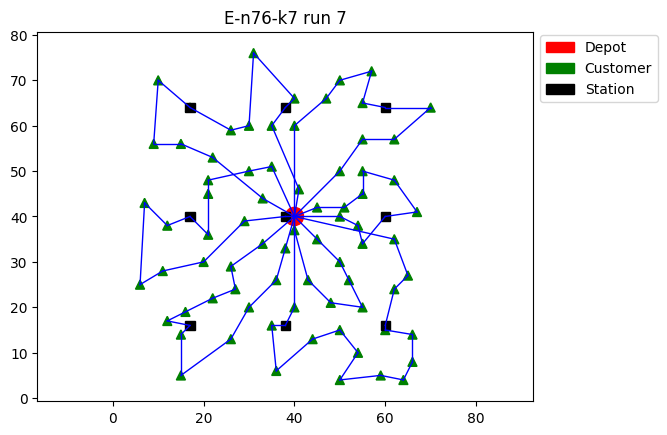

Run: 8 with random seed 8


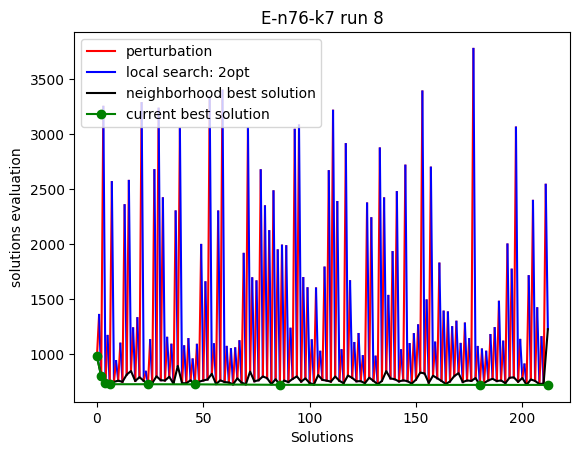

End of run 8 with best solution quality 723.0150479459824 total evaluations: 2125010.25888314


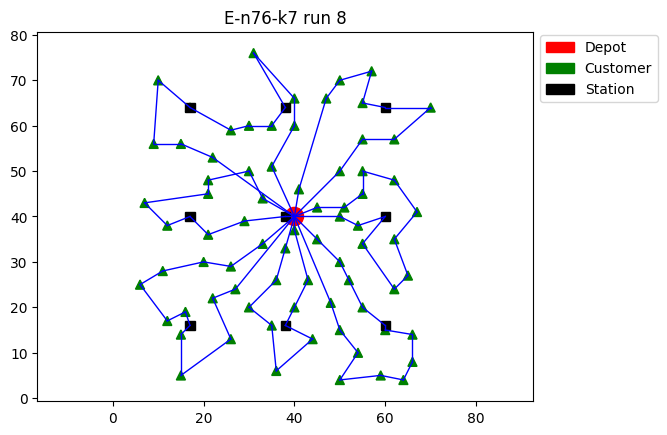

Run: 9 with random seed 9


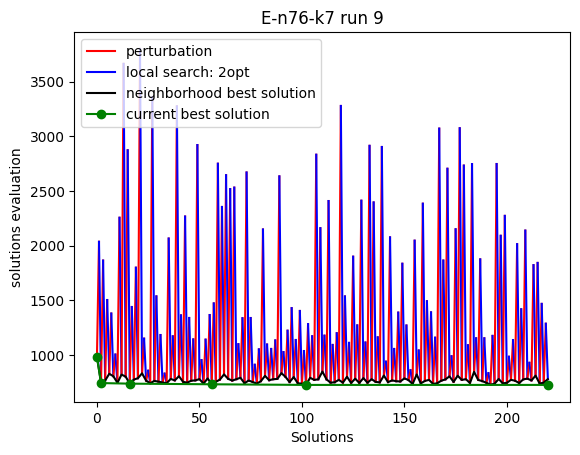

End of run 9 with best solution quality 725.2576599961842 total evaluations: 2125134.4471241515


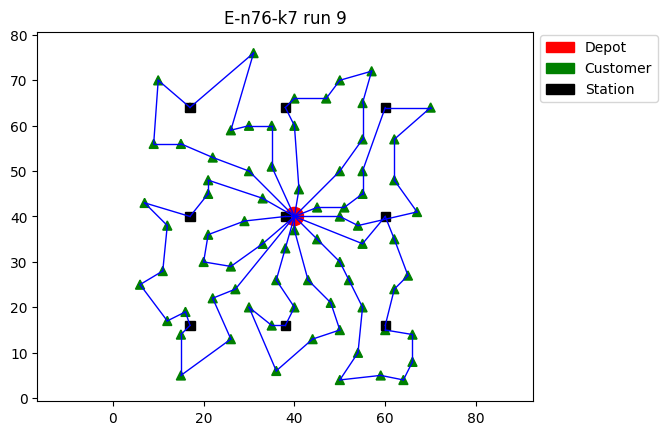

Run: 10 with random seed 10


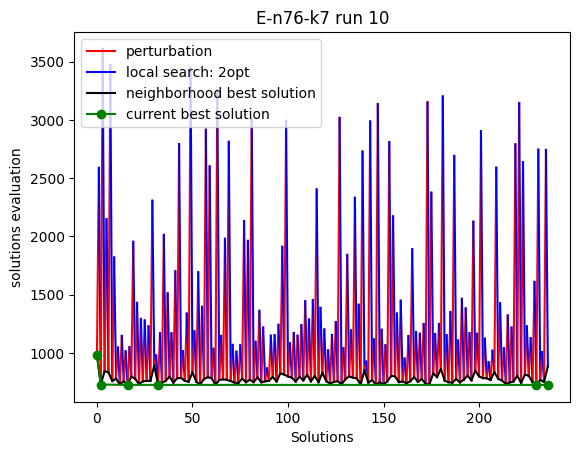

End of run 10 with best solution quality 724.2921382034007 total evaluations: 2125094.08241755


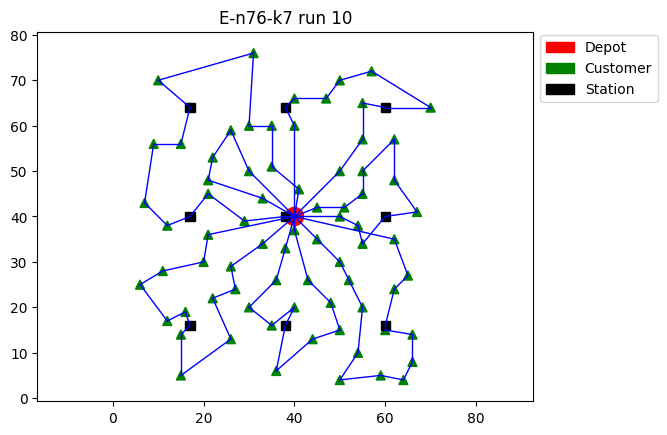

Run: 11 with random seed 11


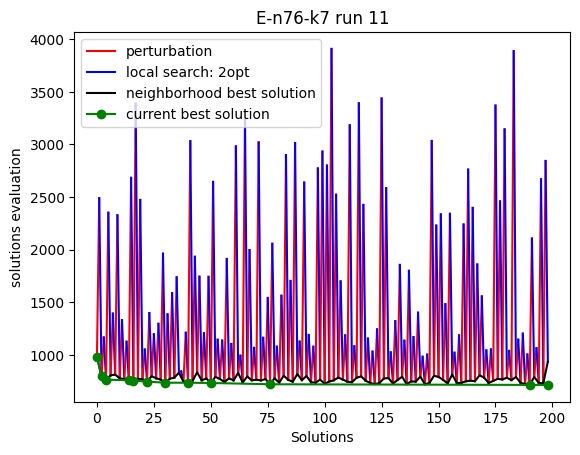

End of run 11 with best solution quality 714.0214458608301 total evaluations: 2125211.141245835


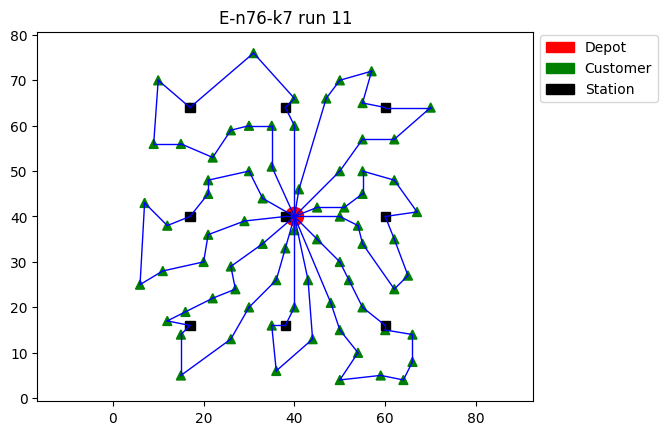

Run: 12 with random seed 12


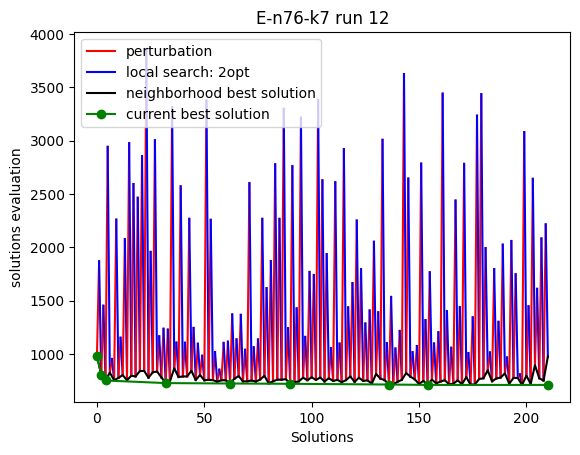

End of run 12 with best solution quality 710.8879278589519 total evaluations: 2125184.705951105


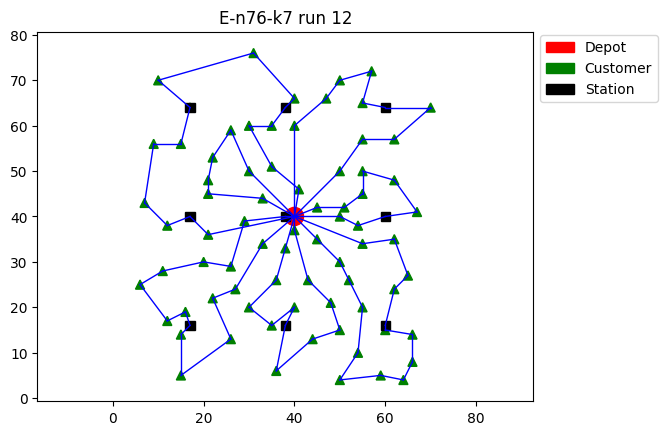

Run: 13 with random seed 13


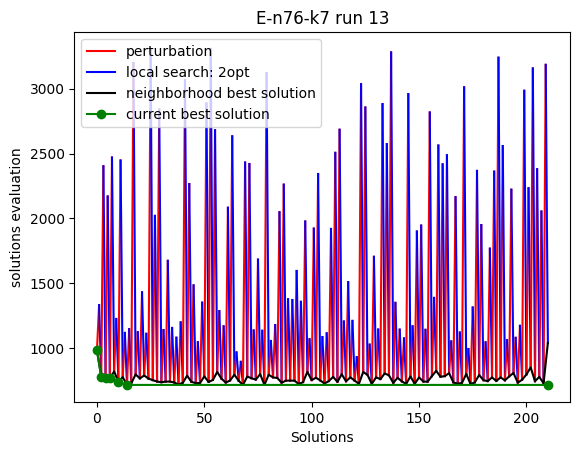

End of run 13 with best solution quality 716.7297429328637 total evaluations: 2125327.247129047


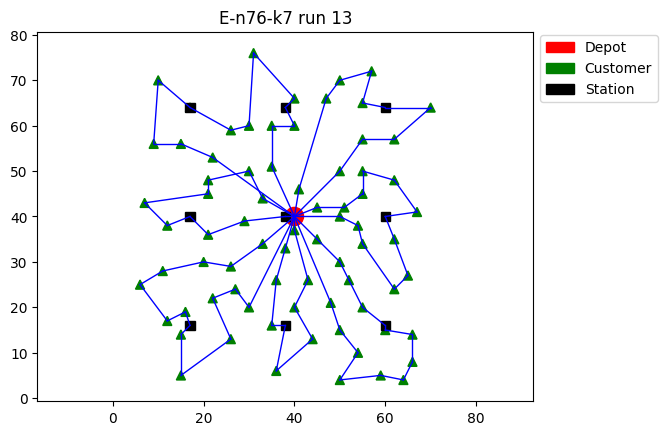

Run: 14 with random seed 14


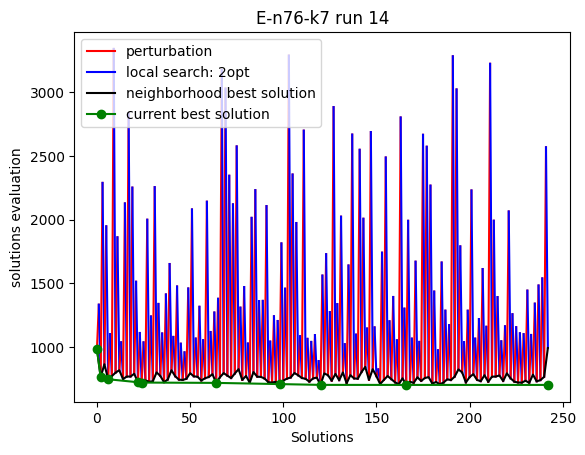

End of run 14 with best solution quality 701.5668297223616 total evaluations: 2125014.611827342


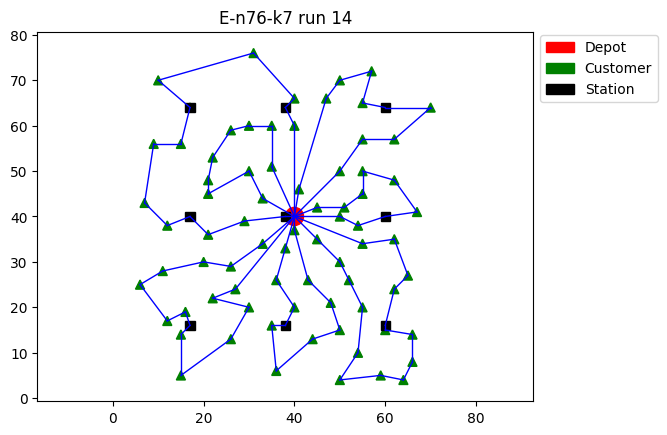

Run: 15 with random seed 15


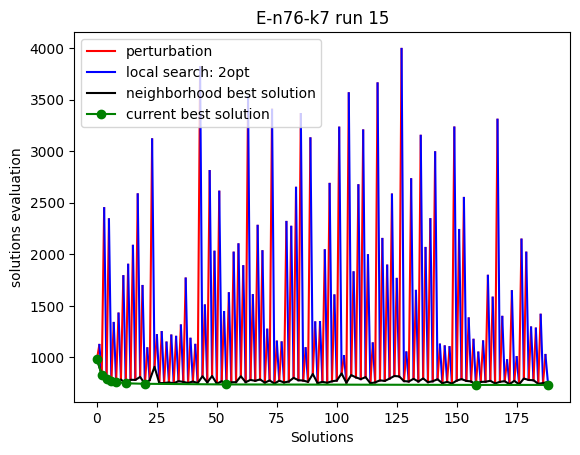

End of run 15 with best solution quality 732.4636509749055 total evaluations: 2125031.5883000554


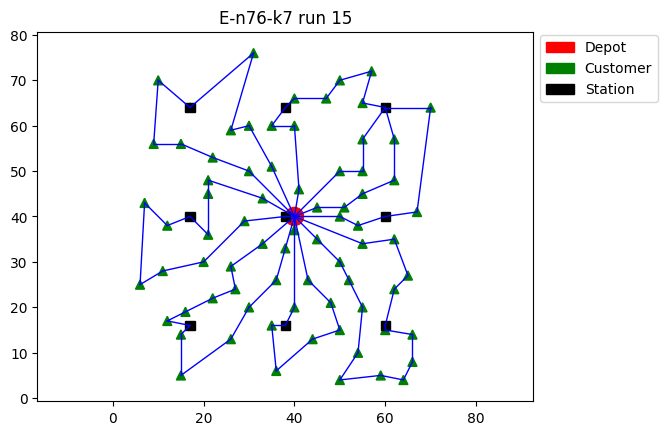

Run: 16 with random seed 16


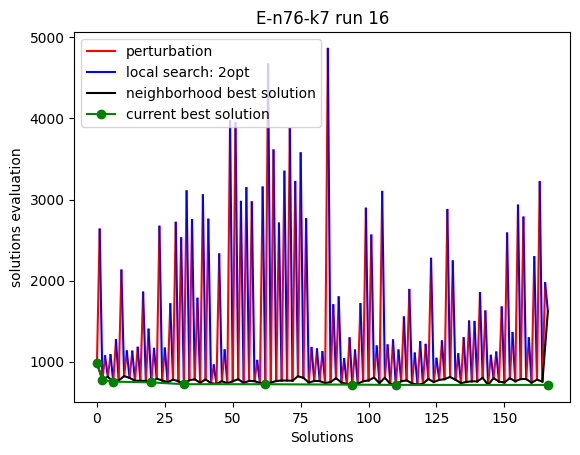

End of run 16 with best solution quality 713.9691420715741 total evaluations: 2125030.6353636896


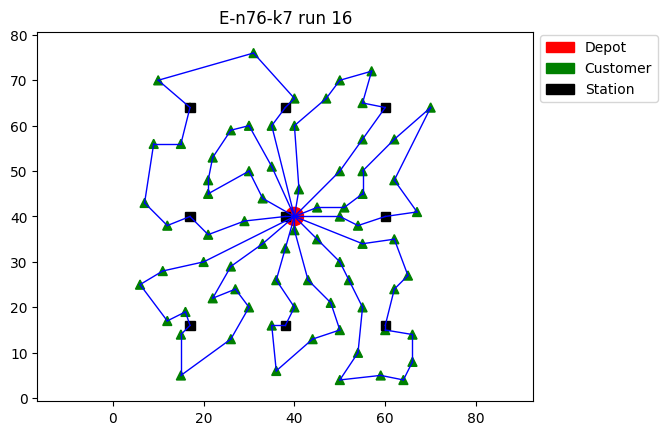

Run: 17 with random seed 17


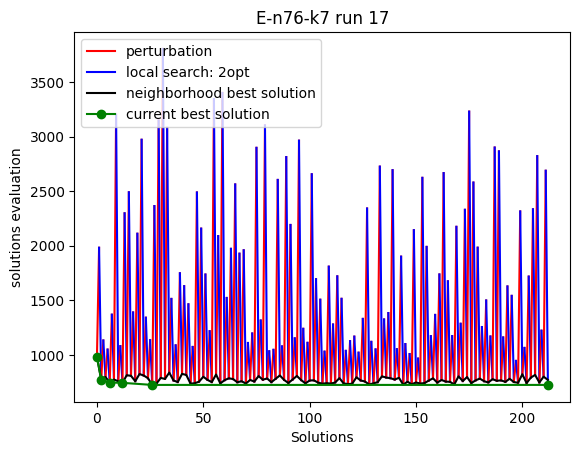

End of run 17 with best solution quality 725.2566921002718 total evaluations: 2125395.6941873


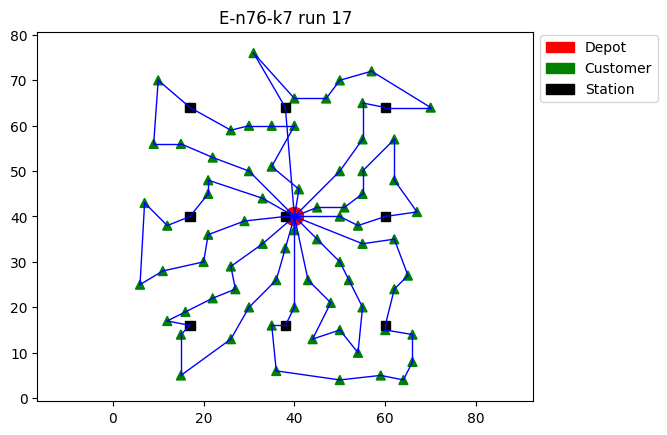

Run: 18 with random seed 18


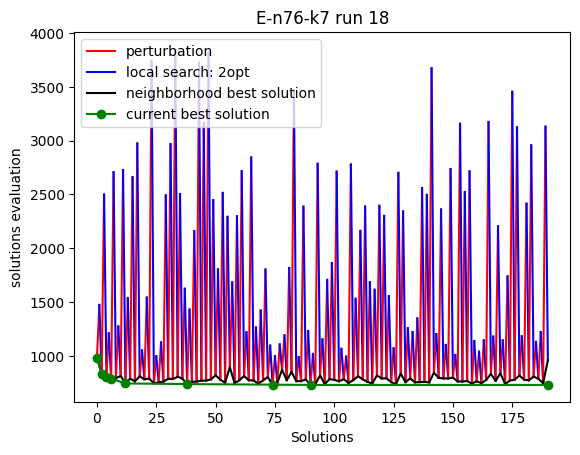

End of run 18 with best solution quality 729.5228934041472 total evaluations: 2125255.9294837527


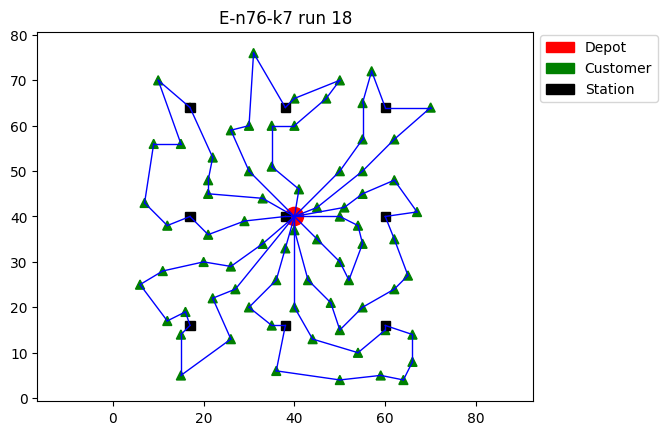

Run: 19 with random seed 19


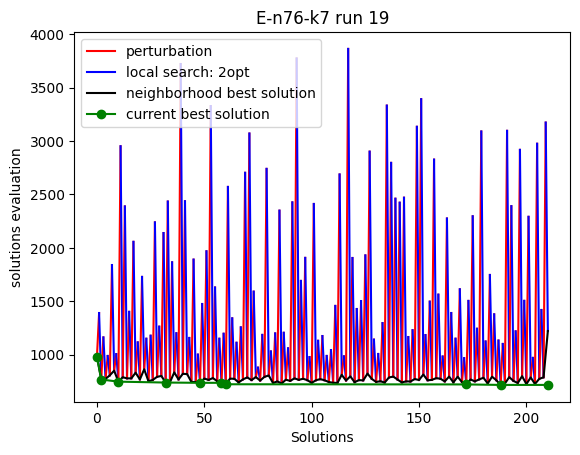

End of run 19 with best solution quality 717.3999317590299 total evaluations: 2125164.7765366714


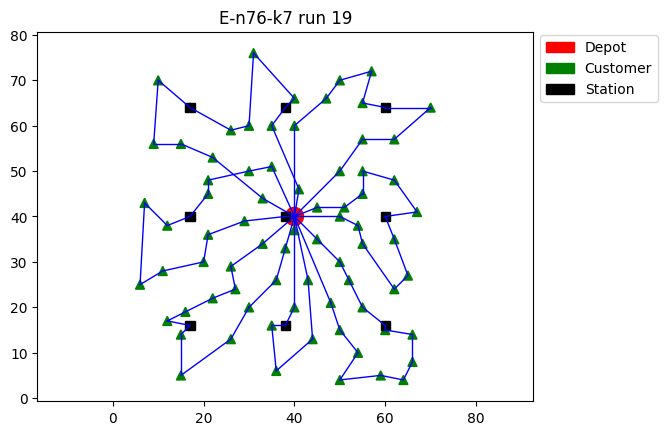

Run: 20 with random seed 20


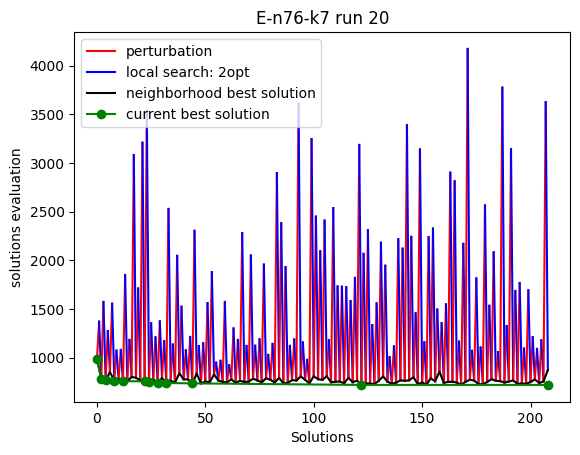

End of run 20 with best solution quality 719.5930062888497 total evaluations: 2125477.1412561317


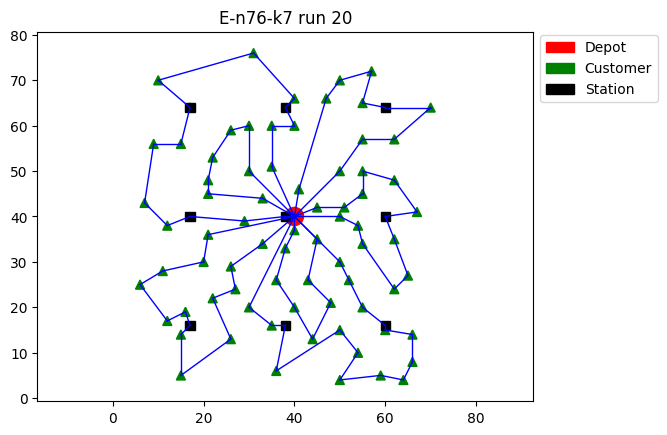

6 -- 8
Begin running: /content/CS106/evrp-benchmark-set/E-n101-k8.evrp
========= E-n101-k8.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/E-n101-k8.evrp.txt
Run: 1 with random seed 1


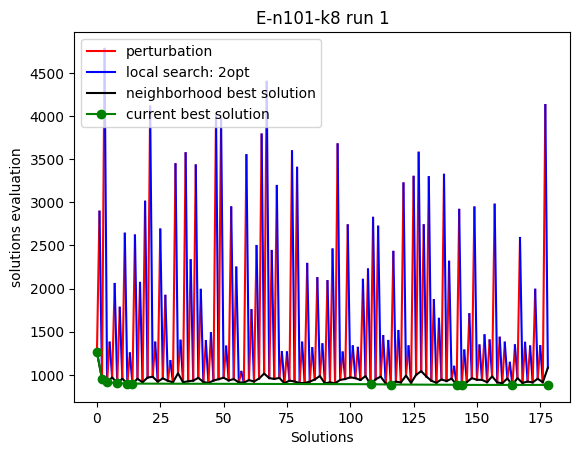

End of run 1 with best solution quality 883.069834222819 total evaluations: 2750231.621562226


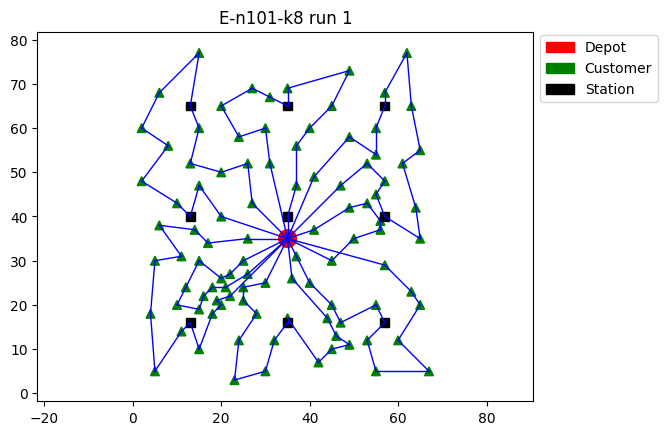

Run: 2 with random seed 2


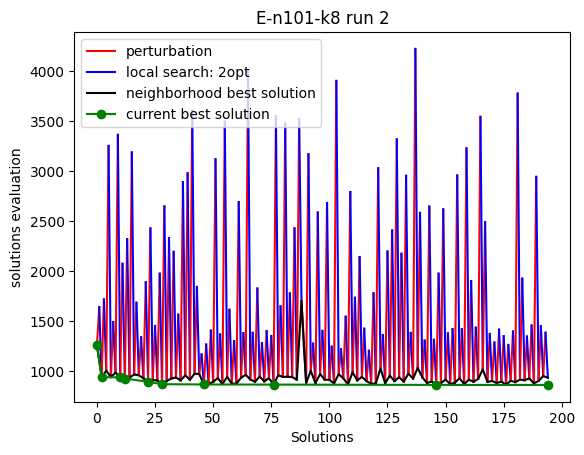

End of run 2 with best solution quality 865.5017141685694 total evaluations: 2750183.876107222


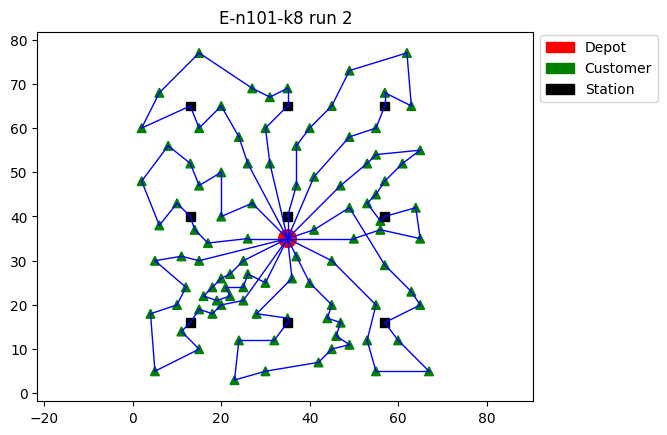

Run: 3 with random seed 3


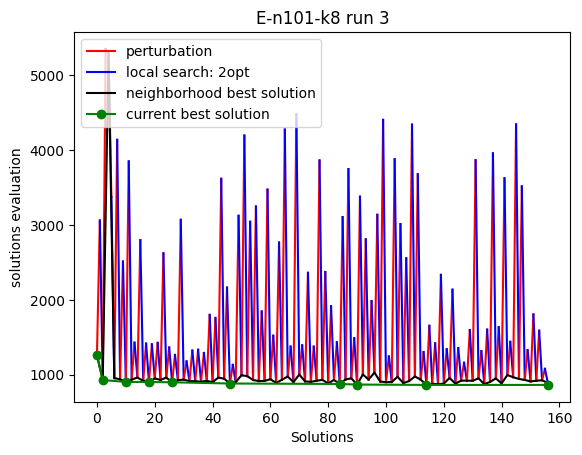

End of run 3 with best solution quality 863.7717267301065 total evaluations: 2750303.166996392


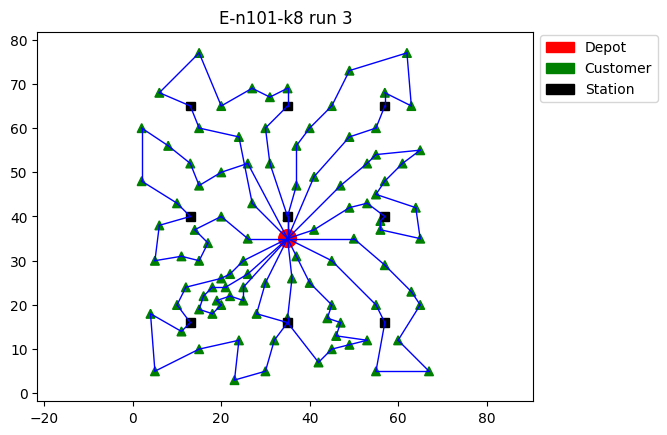

Run: 4 with random seed 4


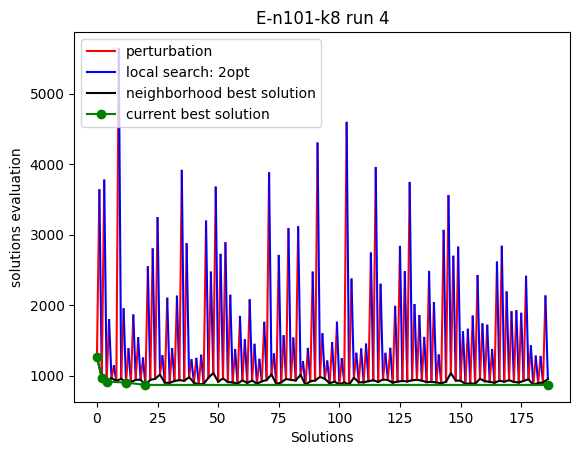

End of run 4 with best solution quality 866.3464370852441 total evaluations: 2750272.0760971387


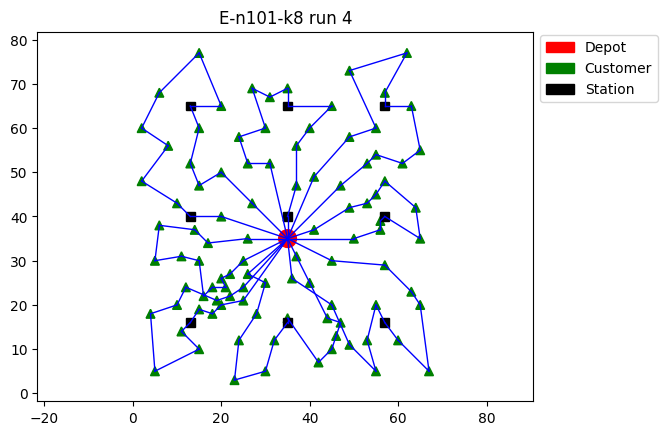

Run: 5 with random seed 5


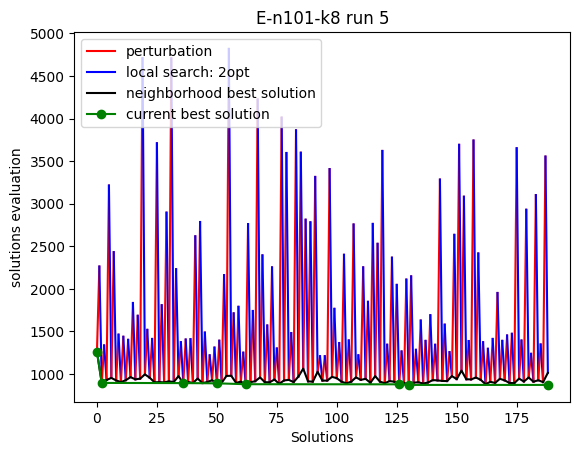

End of run 5 with best solution quality 871.5258626848171 total evaluations: 2750094.067006119


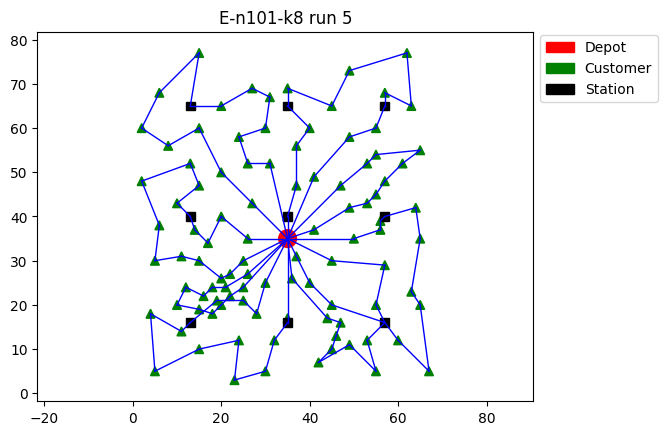

Run: 6 with random seed 6


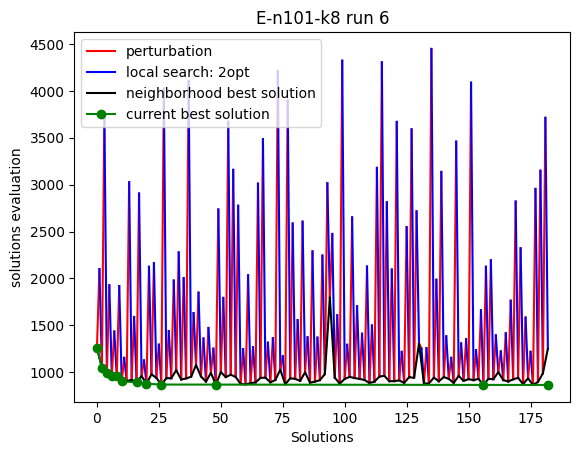

End of run 6 with best solution quality 864.6419533820792 total evaluations: 2750106.912456256


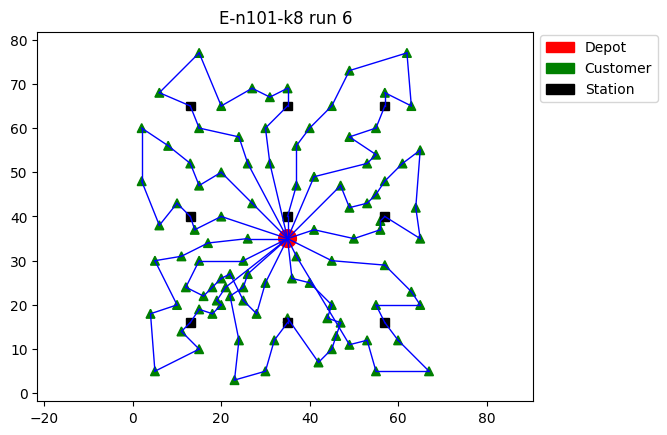

Run: 7 with random seed 7


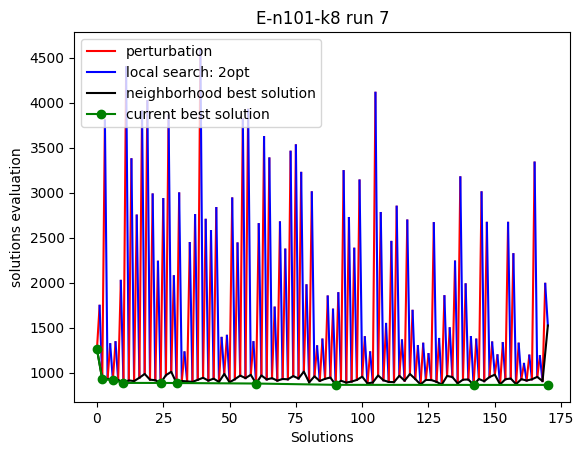

End of run 7 with best solution quality 863.2902337177286 total evaluations: 2750068.0033563413


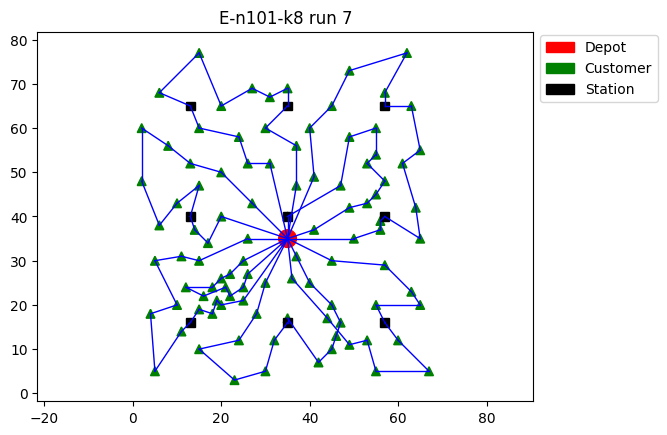

Run: 8 with random seed 8


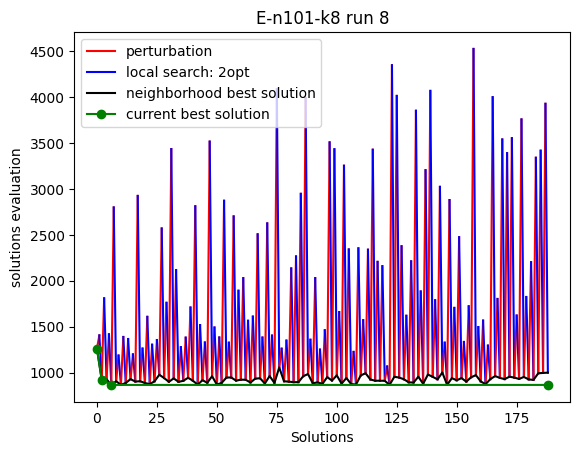

End of run 8 with best solution quality 865.0619879678495 total evaluations: 2750340.376102726


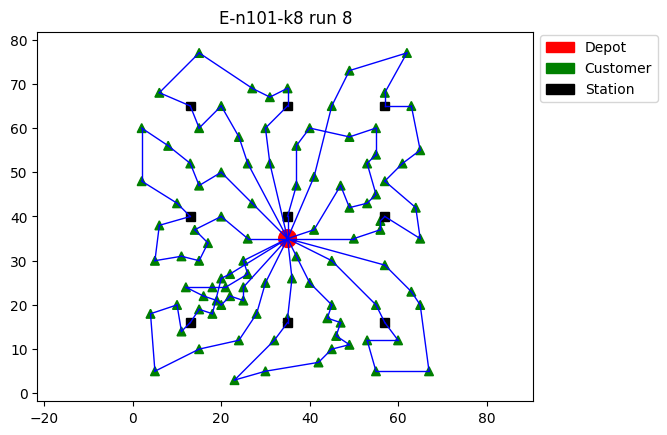

Run: 9 with random seed 9


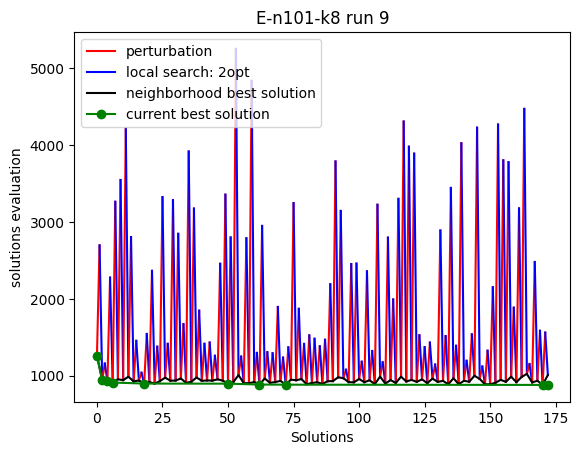

End of run 9 with best solution quality 879.4601828587913 total evaluations: 2750146.4124611607


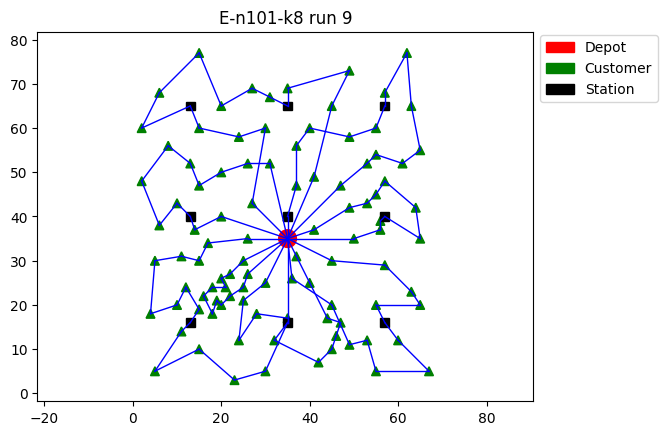

Run: 10 with random seed 10


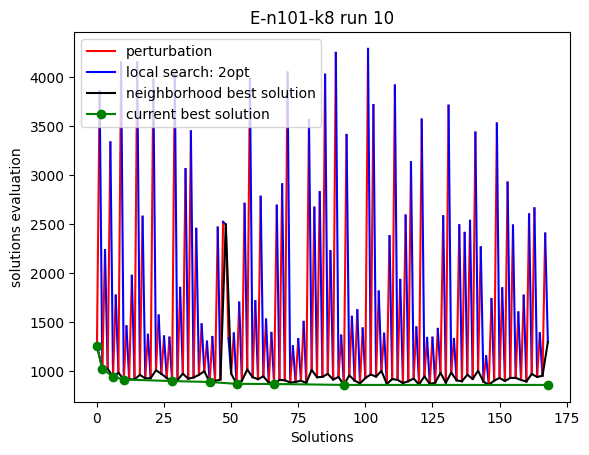

End of run 10 with best solution quality 861.0389917539374 total evaluations: 2750144.730641282


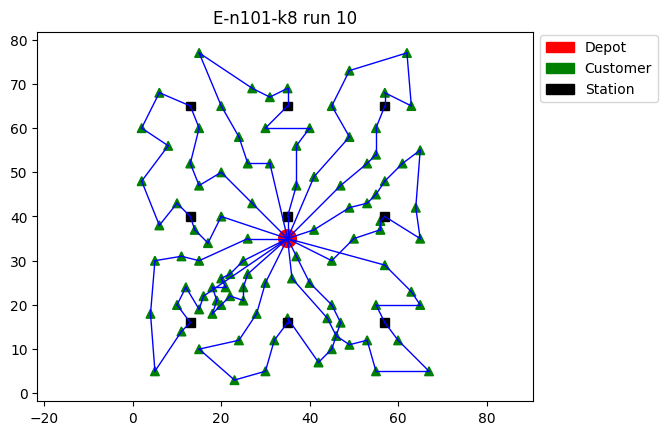

Run: 11 with random seed 11


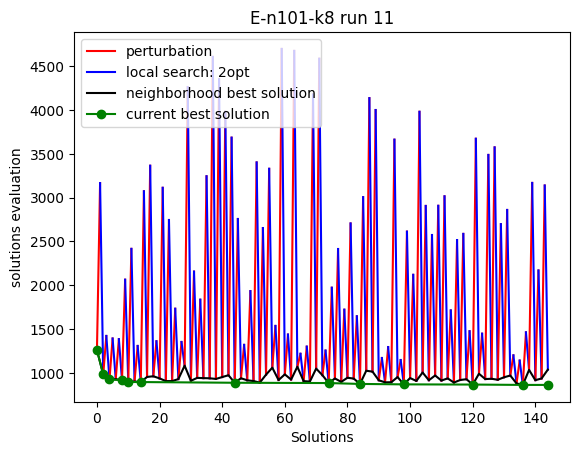

End of run 11 with best solution quality 861.4433346733888 total evaluations: 2750007.2124418085


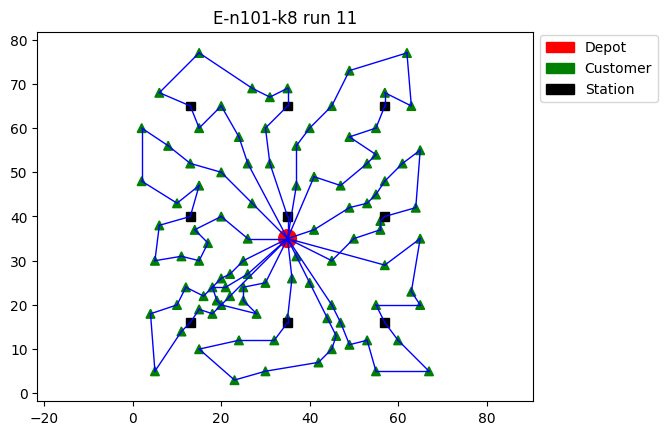

Run: 12 with random seed 12


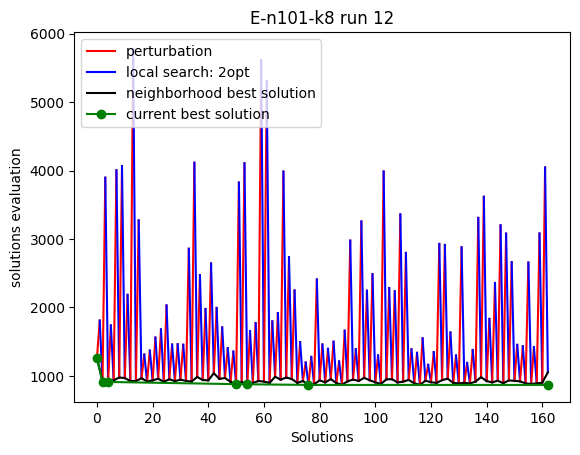

End of run 12 with best solution quality 867.4398103283273 total evaluations: 2750220.094269474


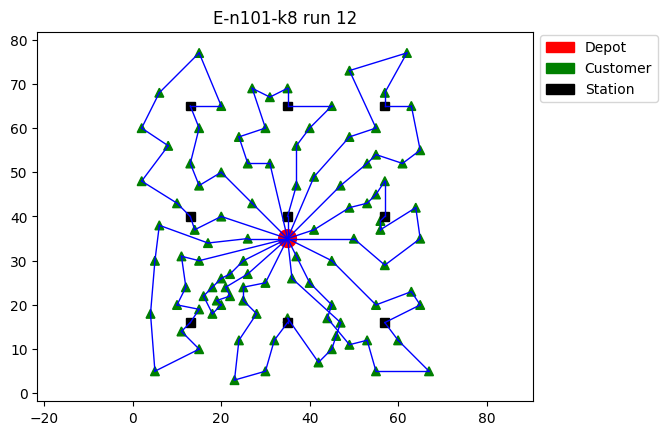

Run: 13 with random seed 13


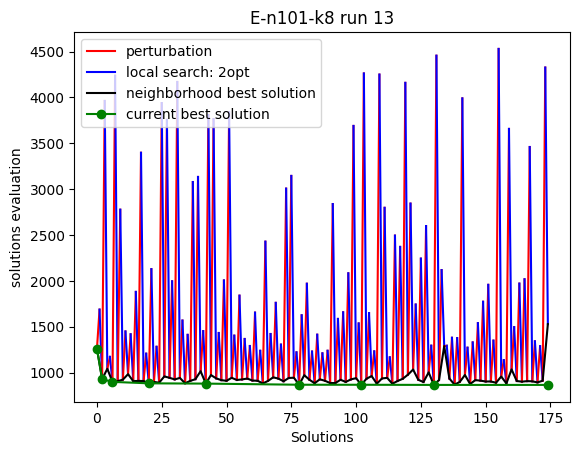

End of run 13 with best solution quality 866.3459439876366 total evaluations: 2750128.839736376


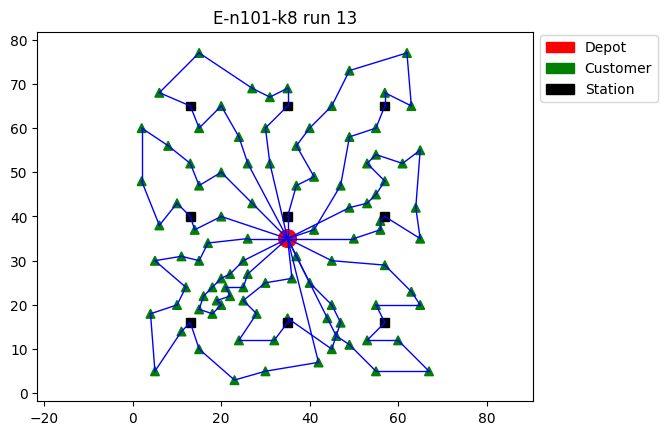

Run: 14 with random seed 14


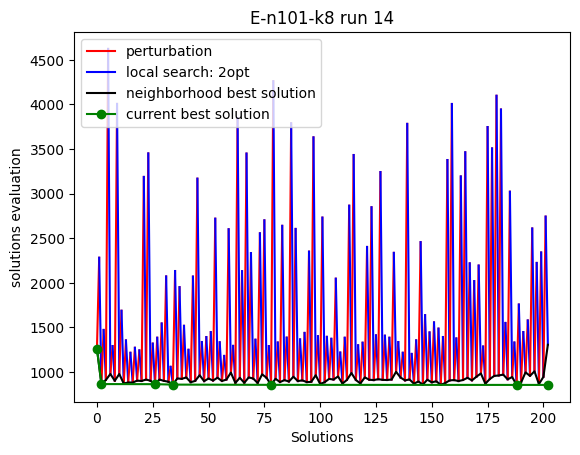

End of run 14 with best solution quality 855.6679354486038 total evaluations: 2750146.8670144593


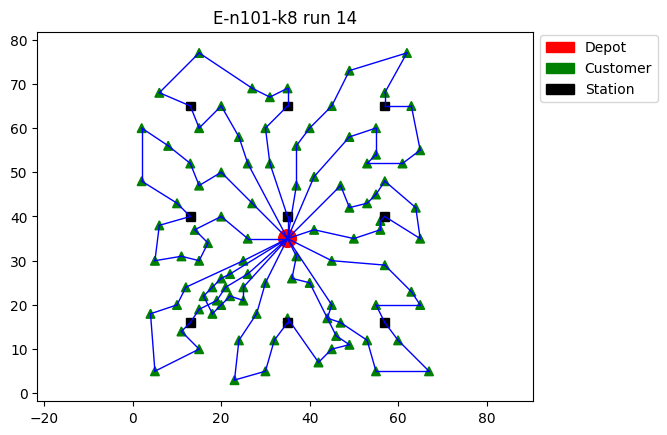

Run: 15 with random seed 15


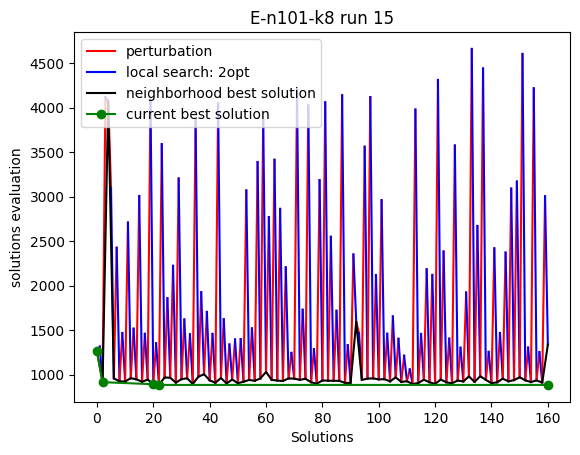

End of run 15 with best solution quality 884.375175770539 total evaluations: 2750027.430655452


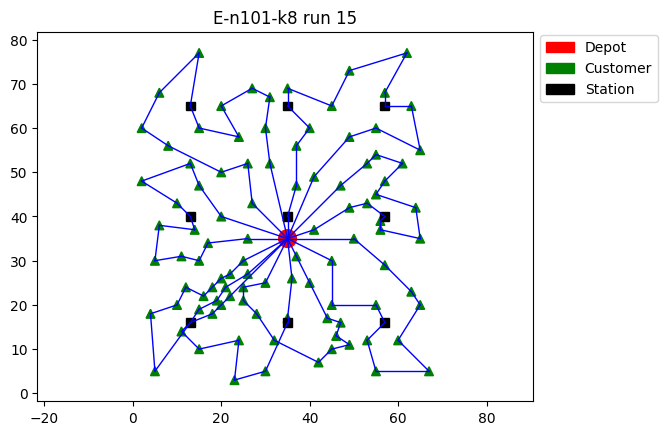

Run: 16 with random seed 16


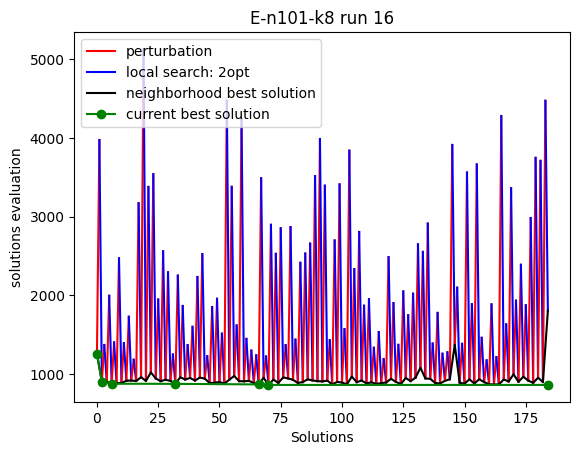

End of run 16 with best solution quality 862.5096661359269 total evaluations: 2750050.3124720696


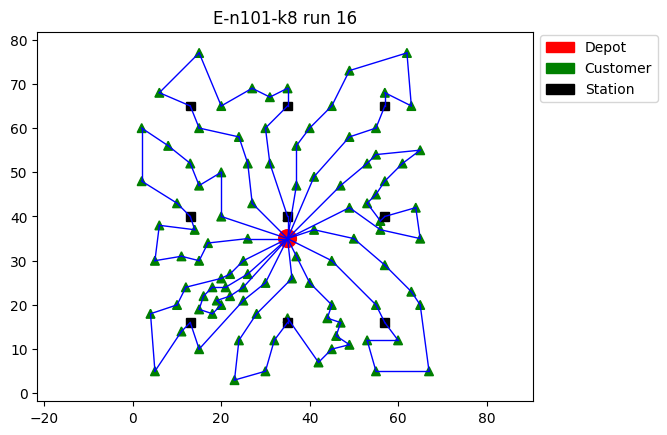

Run: 17 with random seed 17


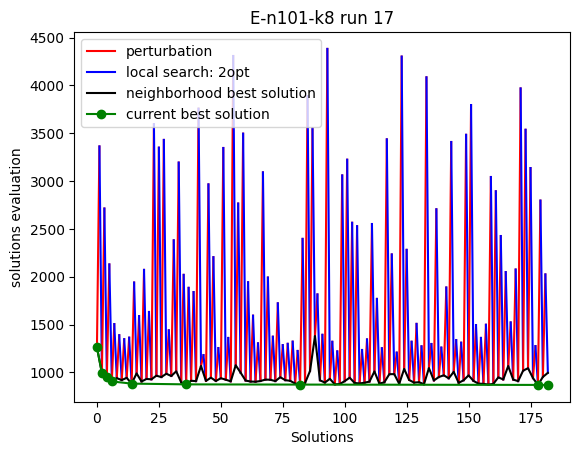

End of run 17 with best solution quality 868.3665457042023 total evaluations: 2750206.139744367


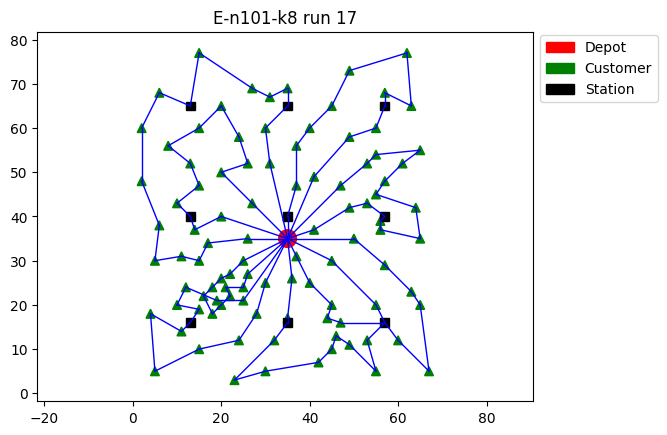

Run: 18 with random seed 18


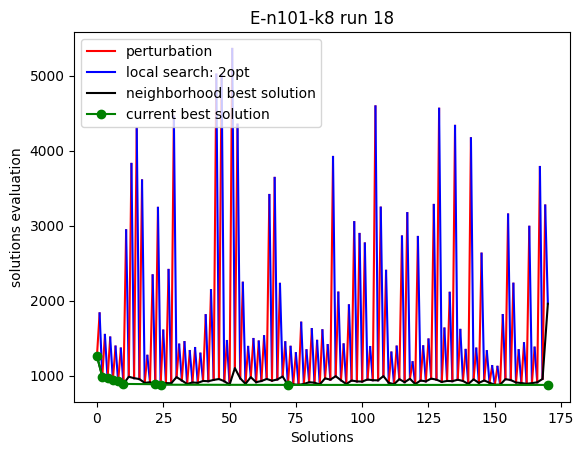

End of run 18 with best solution quality 875.925306578128 total evaluations: 2750045.303362373


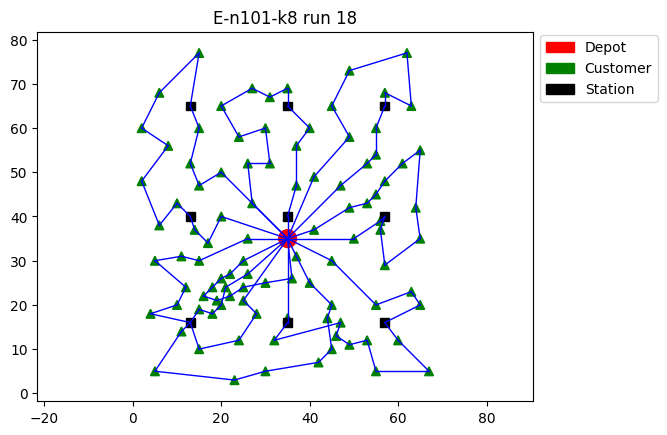

Run: 19 with random seed 19


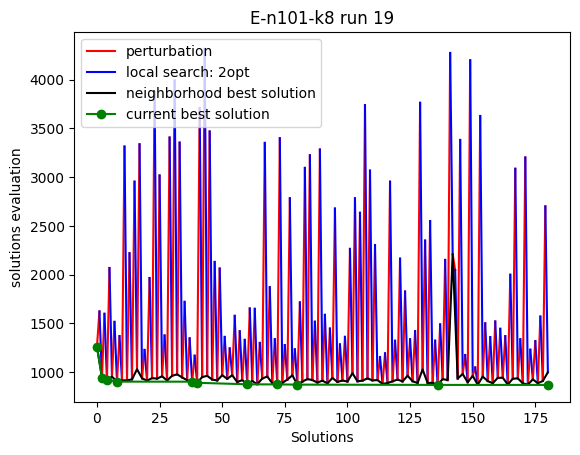

End of run 19 with best solution quality 867.3577308718187 total evaluations: 2750114.4669905882


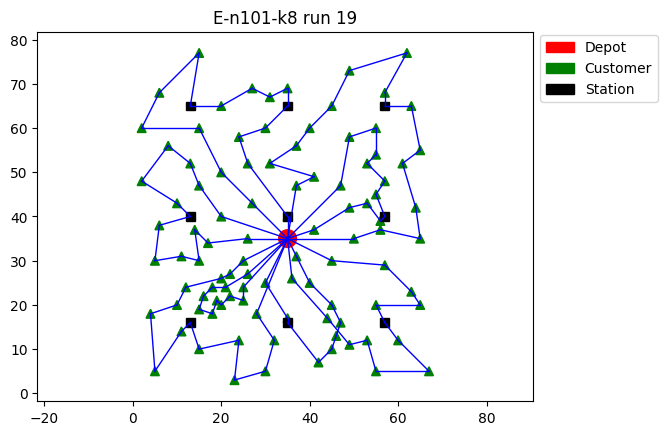

Run: 20 with random seed 20


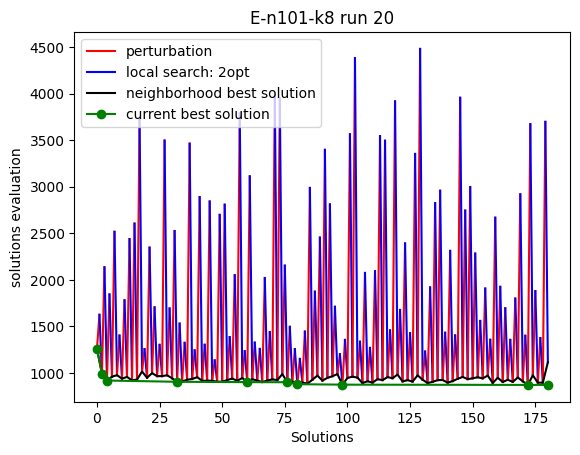

End of run 20 with best solution quality 870.7509862264334 total evaluations: 2750010.803369207


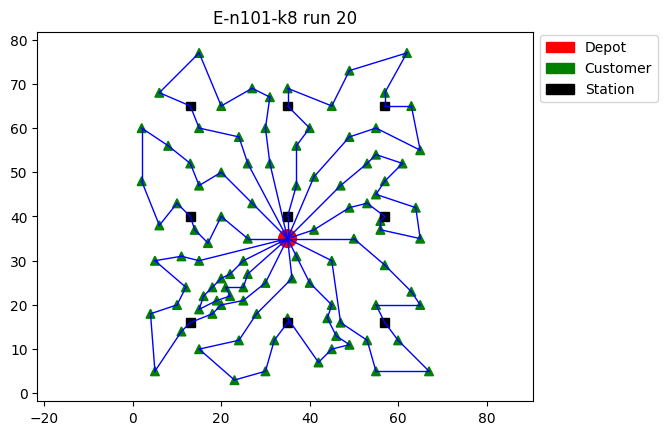

7 -- 8
Begin running: /content/CS106/evrp-benchmark-set/X-n143-k7.evrp
========= X-n143-k7.evrp
]]]]]]] /content/drive/MyDrive/EVRP/Result/X-n143-k7.evrp.txt
Run: 1 with random seed 1


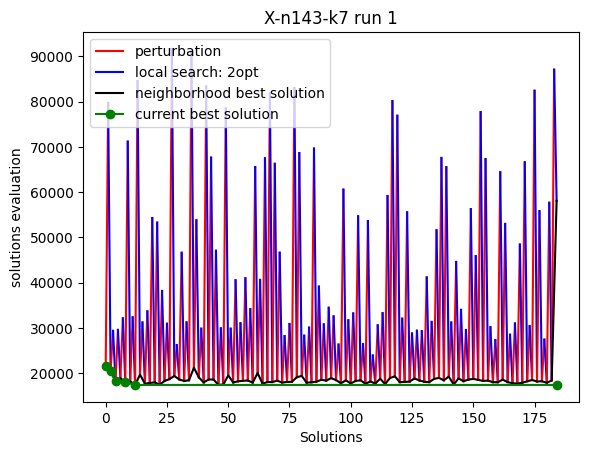

End of run 1 with best solution quality 17381.47049496976 total evaluations: 3675010.3472370934


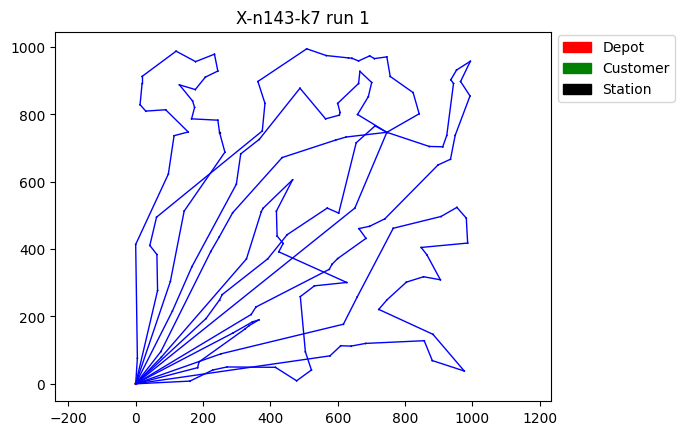

Run: 2 with random seed 2


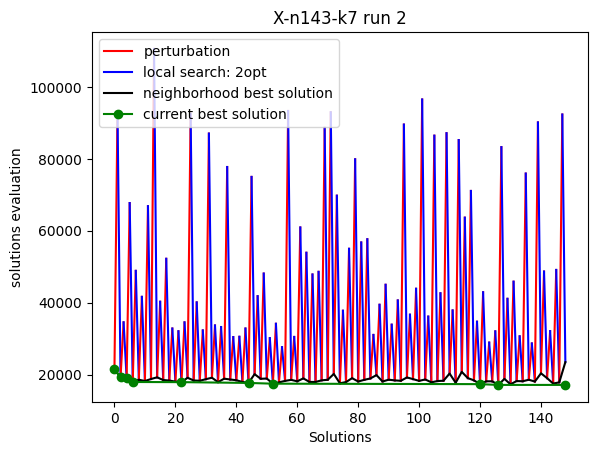

End of run 2 with best solution quality 17141.37411904297 total evaluations: 3675155.306381028


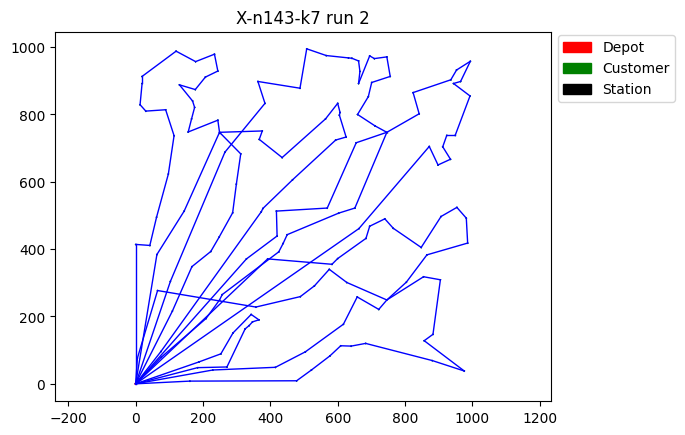

Run: 3 with random seed 3


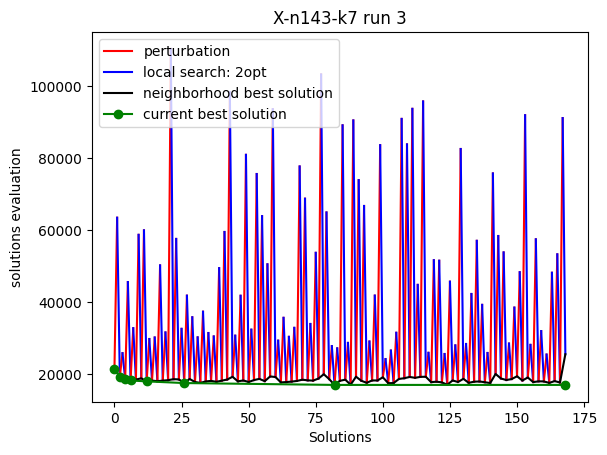

End of run 3 with best solution quality 17044.398192072367 total evaluations: 3675140.272363208


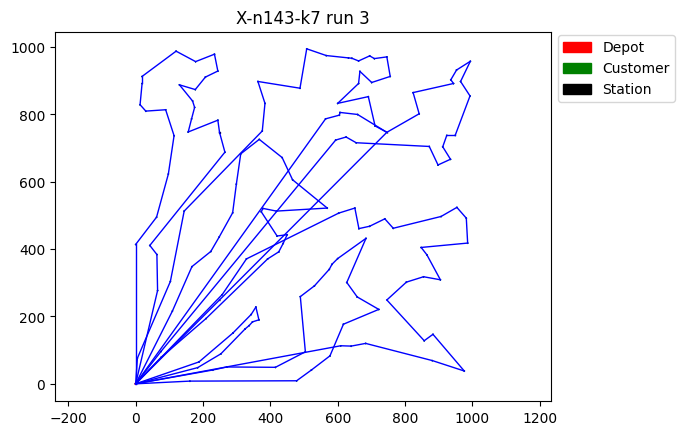

Run: 4 with random seed 4


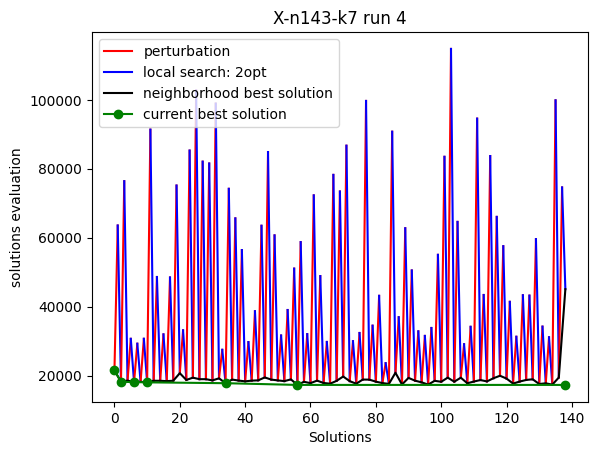

End of run 4 with best solution quality 17266.885123998658 total evaluations: 3675063.741756149


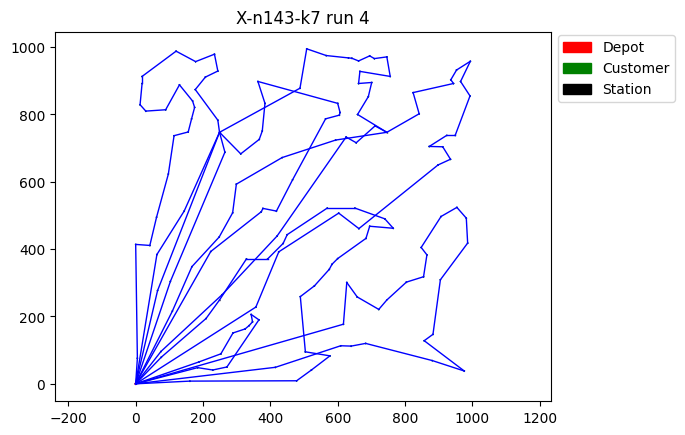

Run: 5 with random seed 5


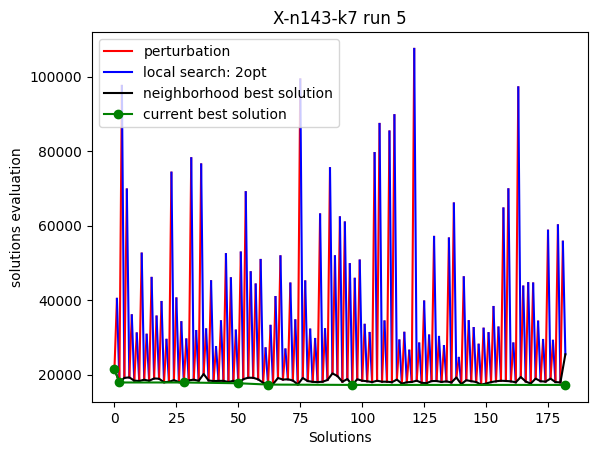

End of run 5 with best solution quality 17232.198388225897 total evaluations: 3675005.1431202013


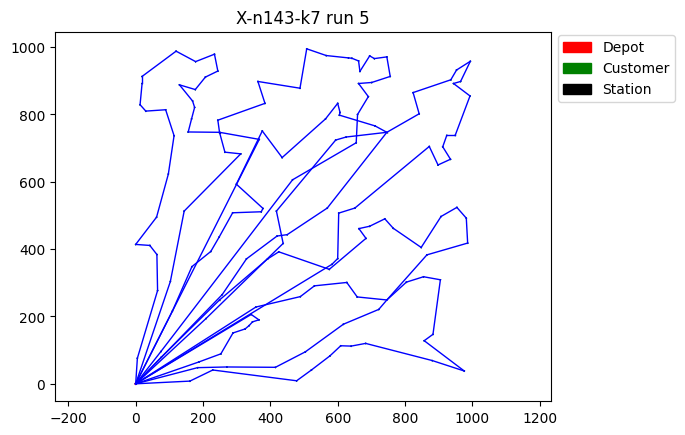

Run: 6 with random seed 6


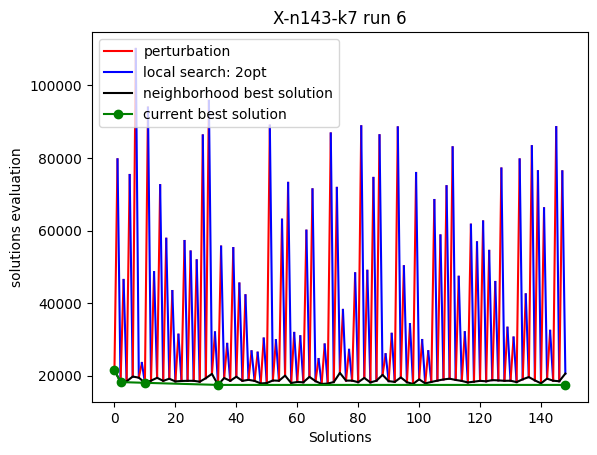

End of run 6 with best solution quality 17442.998167172016 total evaluations: 3675093.2383645666


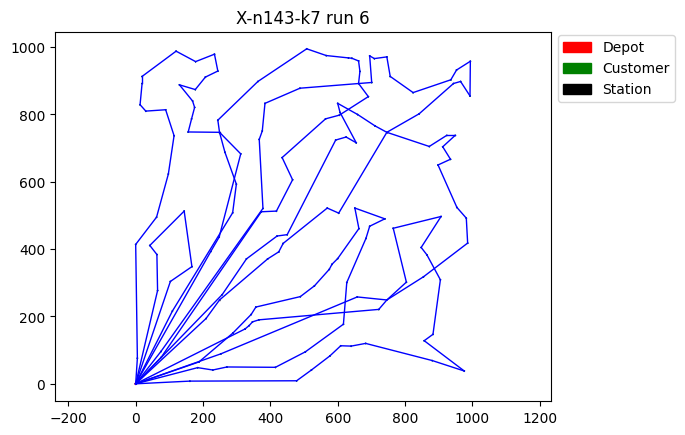

Run: 7 with random seed 7


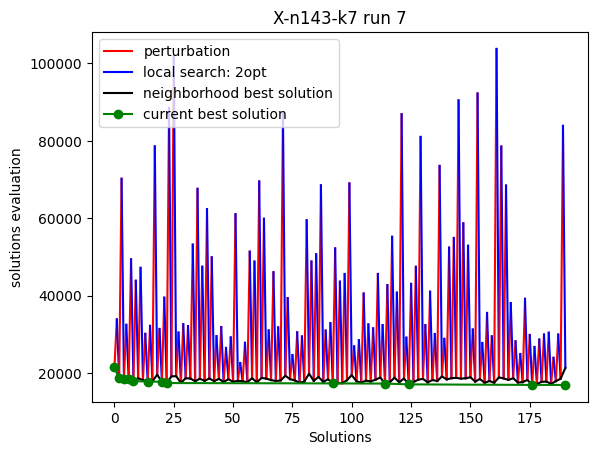

End of run 7 with best solution quality 16932.7918607851 total evaluations: 3675176.5785384565


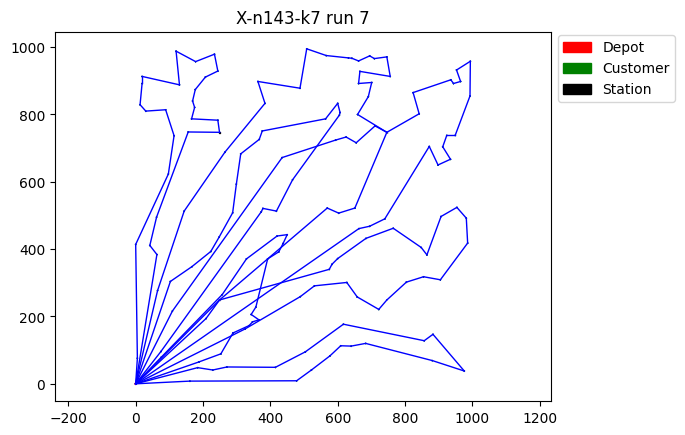

Run: 8 with random seed 8


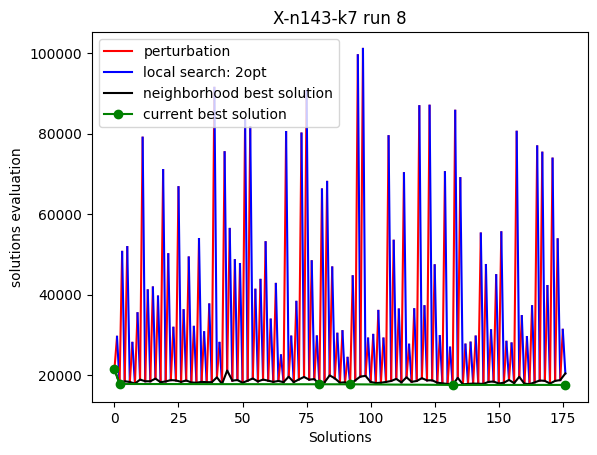

End of run 8 with best solution quality 17563.45010470439 total evaluations: 3675063.558120556


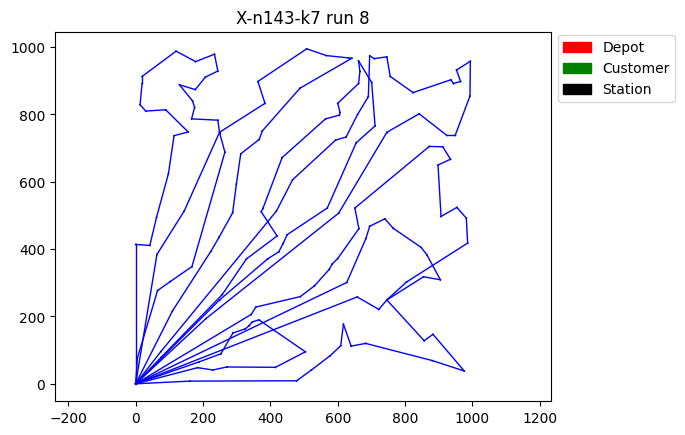

Run: 9 with random seed 9


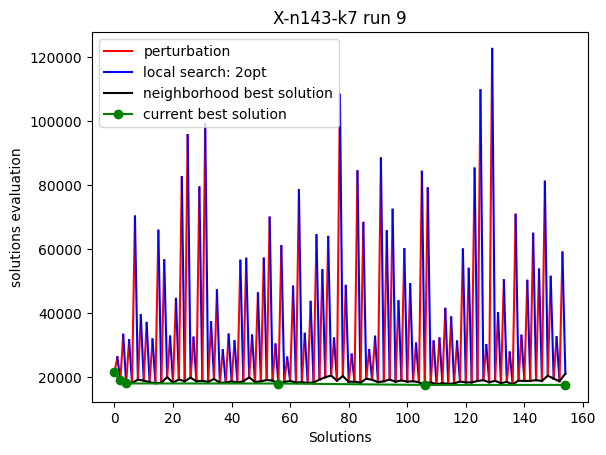

End of run 9 with best solution quality 17559.015711526972 total evaluations: 3675226.449246496


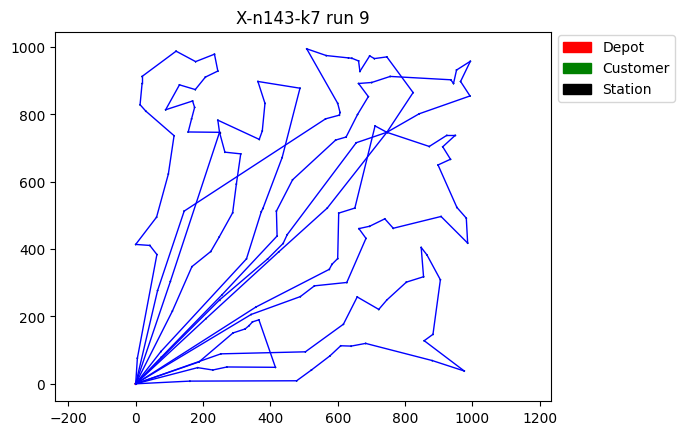

Run: 10 with random seed 10


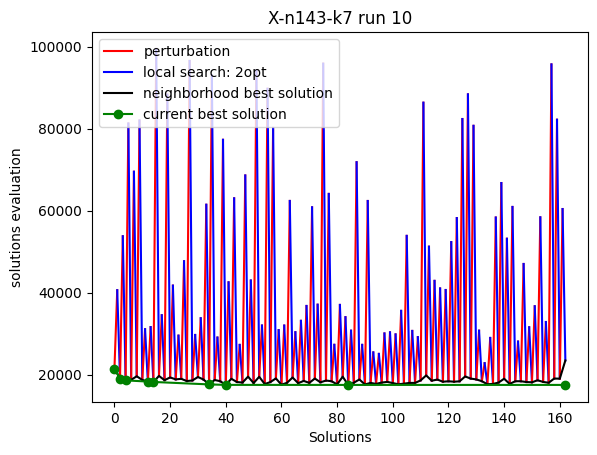

End of run 10 with best solution quality 17482.941586576708 total evaluations: 3675012.9867067738


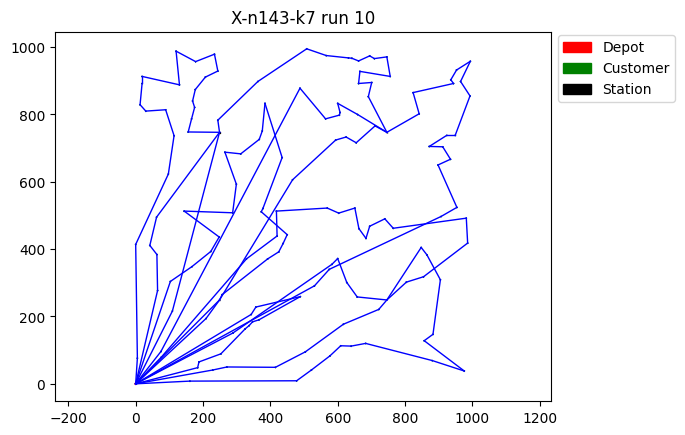

Run: 11 with random seed 11


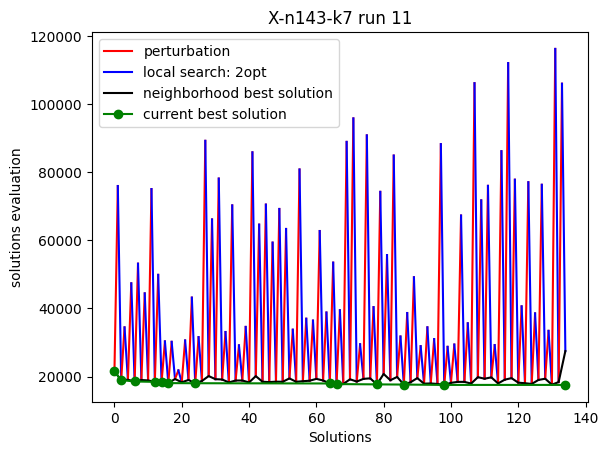

End of run 11 with best solution quality 17528.164494008306 total evaluations: 3675034.177110379


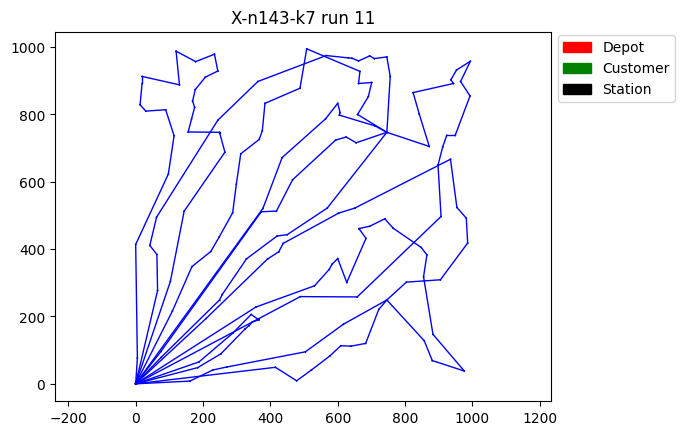

Run: 12 with random seed 12


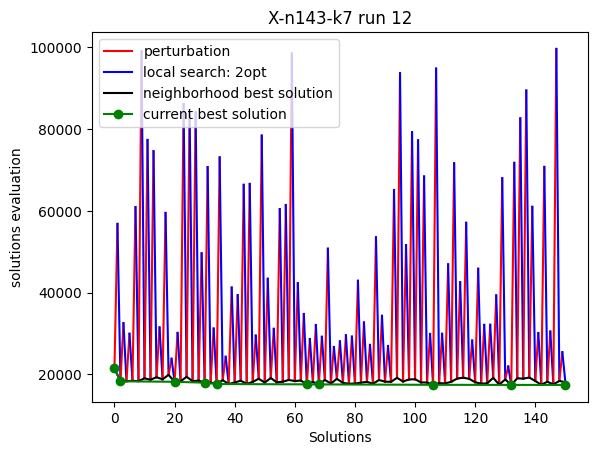

End of run 12 with best solution quality 17438.721397968013 total evaluations: 3675015.530870327


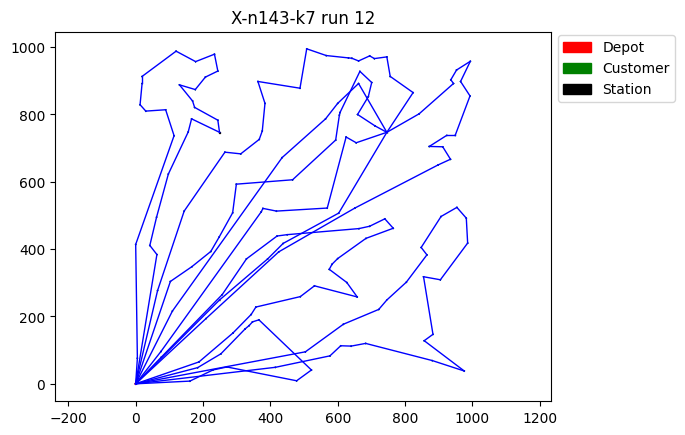

Run: 13 with random seed 13


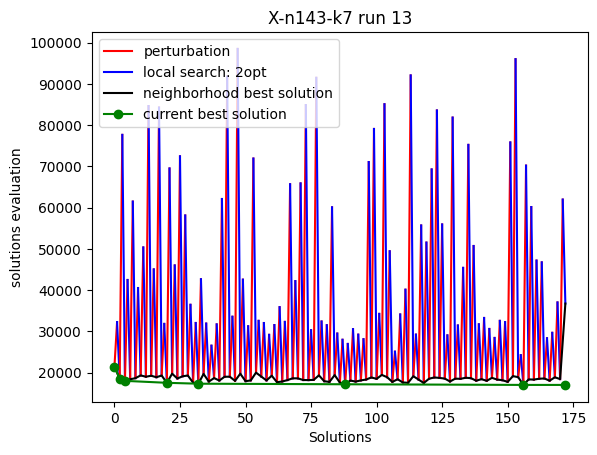

End of run 13 with best solution quality 17016.664599861135 total evaluations: 3675043.088728125


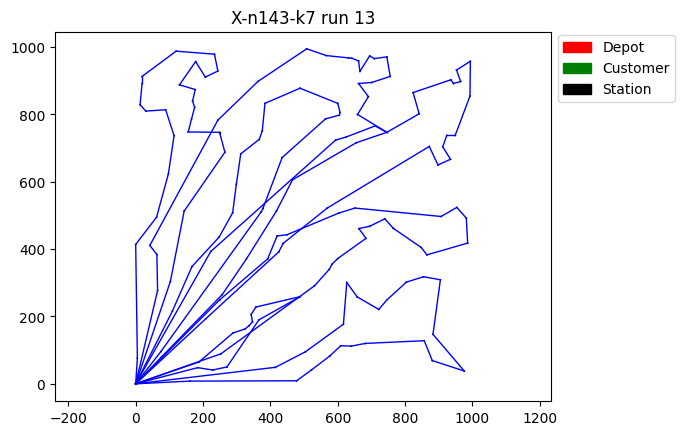

Run: 14 with random seed 14


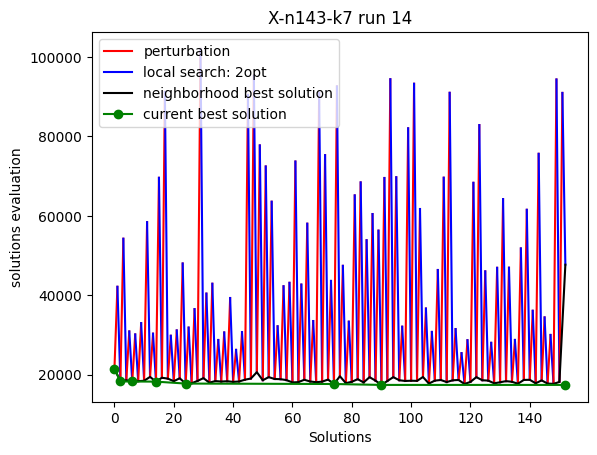

End of run 14 with best solution quality 17385.835031344614 total evaluations: 3675089.170306228


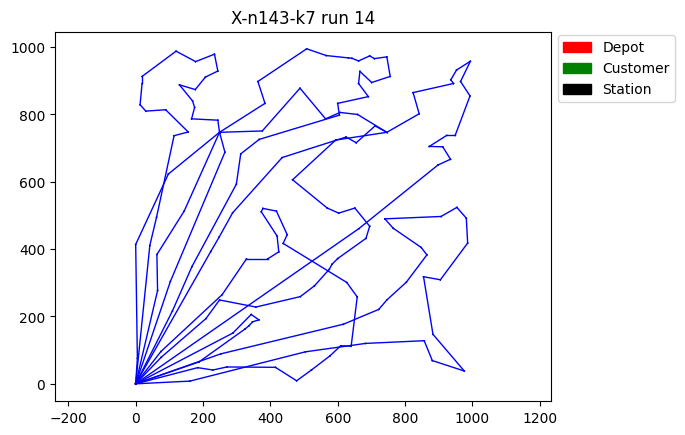

Run: 15 with random seed 15


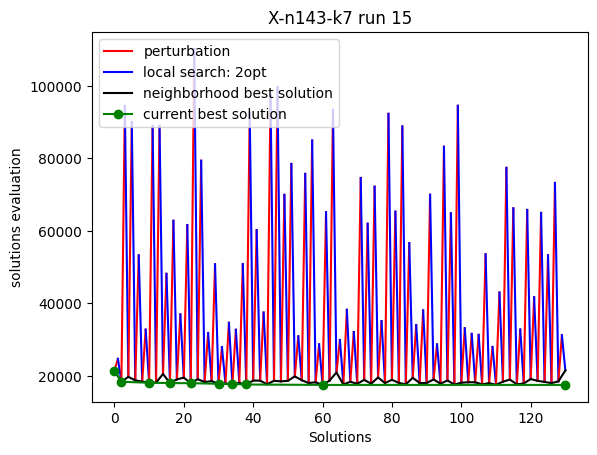

End of run 15 with best solution quality 17530.190822855013 total evaluations: 3675009.8642510497


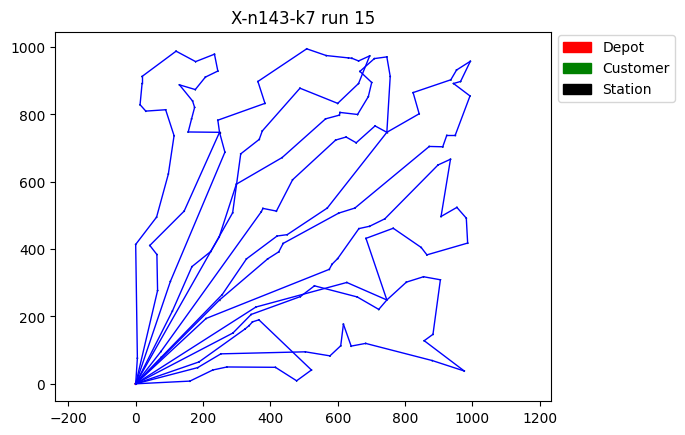

Run: 16 with random seed 16


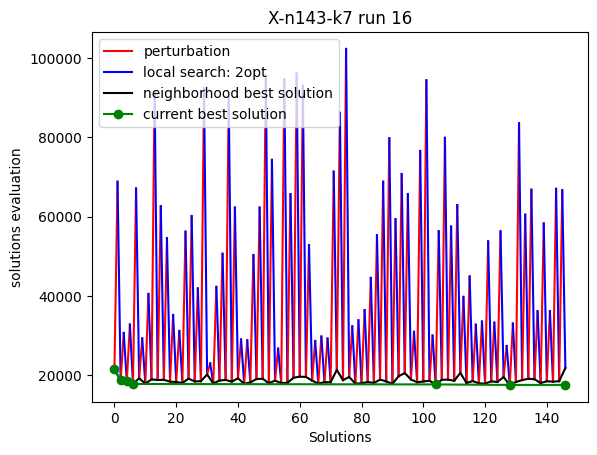

End of run 16 with best solution quality 17525.67154284709 total evaluations: 3675144.9118461395


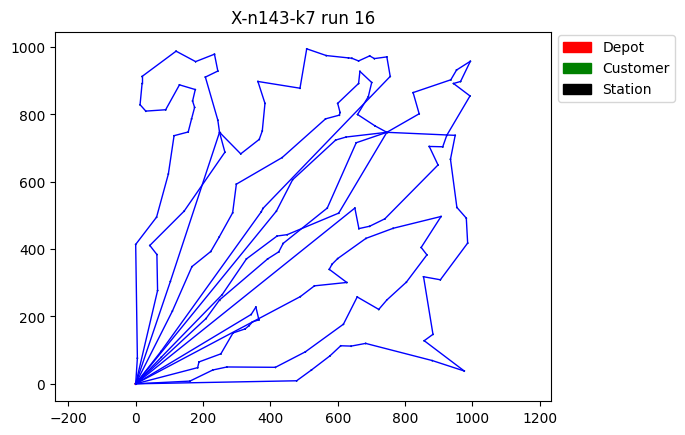

Run: 17 with random seed 17


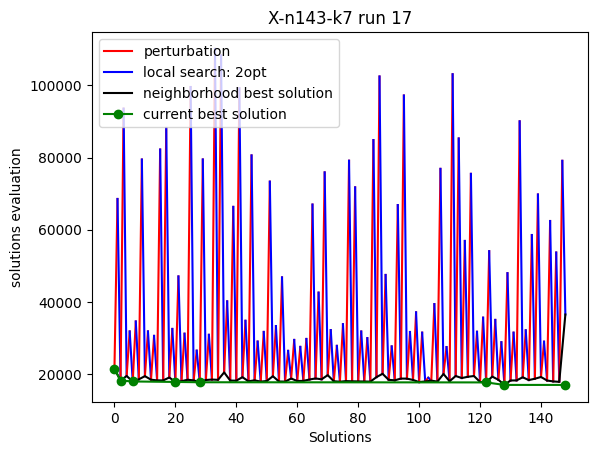

End of run 17 with best solution quality 17003.6692686821 total evaluations: 3675123.2247828953


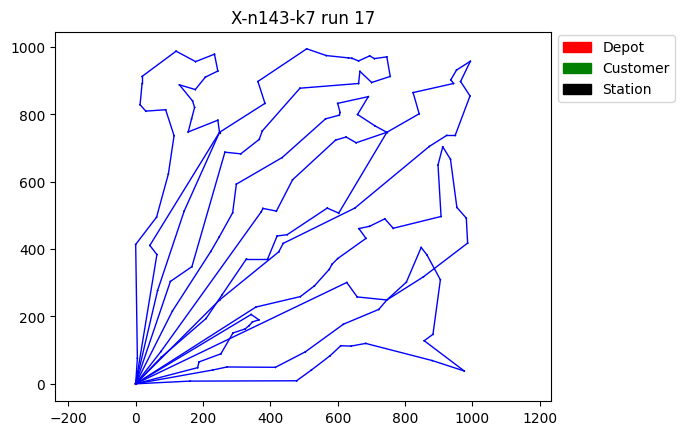

Run: 18 with random seed 18


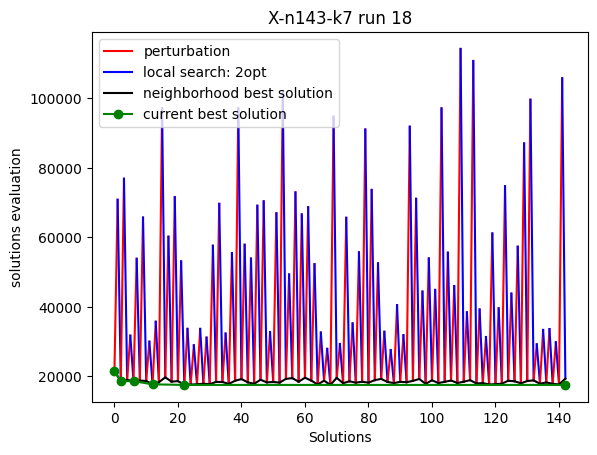

End of run 18 with best solution quality 17565.284672123038 total evaluations: 3675054.211142049


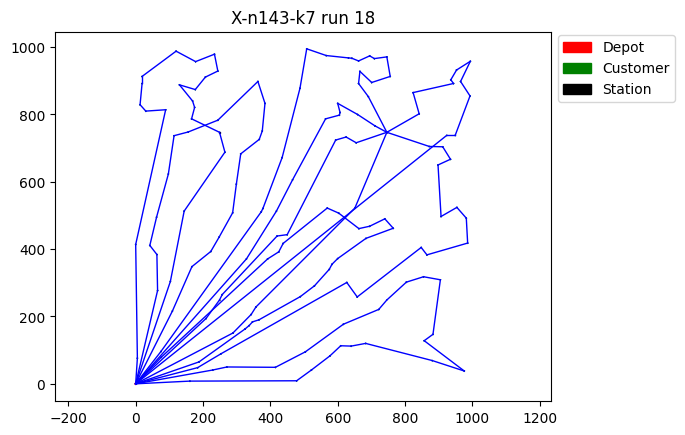

Run: 19 with random seed 19


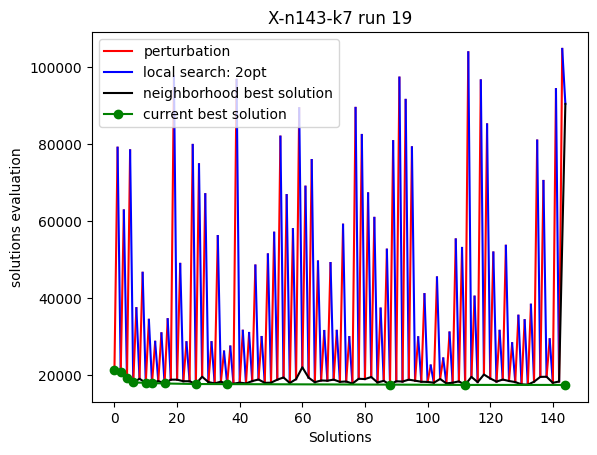

End of run 19 with best solution quality 17483.131847694538 total evaluations: 3675039.653317048


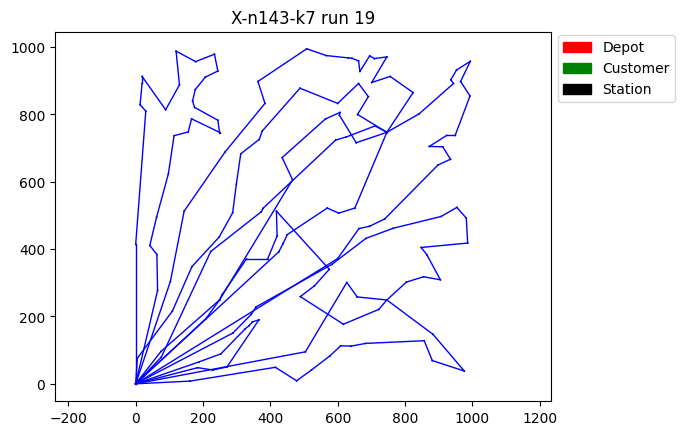

Run: 20 with random seed 20


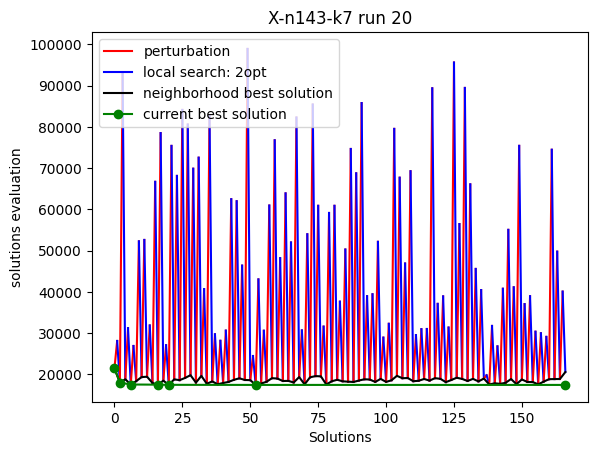

End of run 20 with best solution quality 17470.701794378954 total evaluations: 3675067.272426341


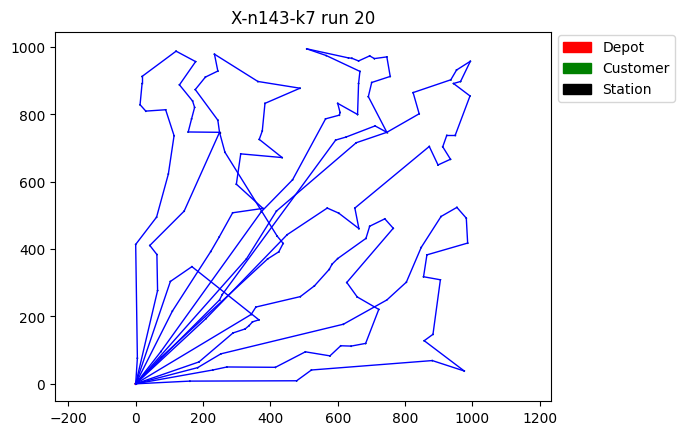

In [ ]:
import os
from natsort import natsorted, ns

pathToBenchmark = '/content/CS106/evrp-benchmark-set'

listPath = [os.path.join(pathToBenchmark, file) for file in os.listdir(pathToBenchmark)]
listPath = natsorted(listPath, alg=ns.IGNORECASE)
# for i in listPath:
#     print(i)

# print(len(listPath))
limit_index = 8

for index, filePath in enumerate(listPath):
  print(index,"--",limit_index )
  if index > limit_index:
    break

  print('Begin running: ' + filePath)
  main(filePath)